# Model selection *using feed forward selection*

The model is au gaussian model with gaussian prior, excpet sigma that has a gamma prior

$log(Y)$~$N(X\theta , \sigma^2I_d)$ with as prior :
 - $\theta$~$N(0,\sigma_b^2I_p)$
 - $\sigma$~$Gamma(a,b)$

In [1]:
%matplotlib inline

from Baysian_framework import *
from Metropolis_hastings import *
from GVA import *
from Important_sampling import *

from Vizualisation_tool import *
from Model import *
from Model_torch import *

import seaborn as sns
import pandas as pd
import scipy as scp # optimization, probability densities and cumulative

In [2]:
df = pd.read_csv ('Real estate.csv')
# first drop usless variable 
data = df.drop(['No'],axis=1)

#Rename
data.rename(columns = {
                                'X1 transaction date': 'Date',
                                'X2 house age' : 'House_age',
                                'X3 distance to the nearest MRT station' : 'MRT_distance',
                                'X4 number of convenience stores' : 'Conv_store_count',
                                'X5 latitude' : 'Latitude',
                                'X6 longitude' : 'Longitude',
                                'Y house price of unit area' : 'Price_per_unit'
}, inplace = True)

X_names = [ 'Date' ,'House_age','MRT_distance','Conv_store_count','Latitude','Longitude' ]
Y_names = ['Price_per_unit' ]

data_tmp = data[data['Price_per_unit']<100]
data_no_outlier = data_tmp[data_tmp['Price_per_unit']>8]

#X= df[df.columns[1:-1]].to_numpy()

Y = np.log((data_no_outlier['Price_per_unit']).to_numpy())

In [3]:
data_no_outlier['MRT_distance_sqrt'] = np.sqrt(data_no_outlier["MRT_distance"])

center_longitude_max = data_no_outlier['Longitude'][np.argmax(data_no_outlier['Price_per_unit'])]
center_latitude_max = data_no_outlier['Latitude'][np.argmax(data_no_outlier['Price_per_unit'])]
distance_center_vector_max = np.c_[data_no_outlier['Longitude'] - center_longitude_max,data_no_outlier['Latitude'] - center_latitude_max]
distance_vector_max = np.linalg.norm(distance_center_vector_max,axis=1)
orientation = np.arctan2(distance_center_vector_max[:,0],distance_center_vector_max[:,1])

data_no_outlier['dist_center'] = np.sqrt(distance_vector_max)
data_no_outlier['orientation'] = orientation





C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value 

In [4]:
X_names = [ 'Date' ,'House_age','MRT_distance','Conv_store_count','Latitude','Longitude', 'MRT_distance_sqrt' ,'dist_center','orientation' ]

### Model feed forward selection :

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.10it/s]


Acceptance rate :  0.4254
    features  Coeff   std               CI   2.5  25.0  50.0  75.0  97.5
0  intercept   3.54  0.02   [3.496, 3.581]  3.50  3.52  3.54  3.55  3.58
1       Date   0.01  0.02  [-0.028, 0.052] -0.03 -0.00  0.01  0.03  0.05
2      sigma   0.38  0.02   [0.352, 0.412]  0.35  0.37  0.38  0.39  0.41


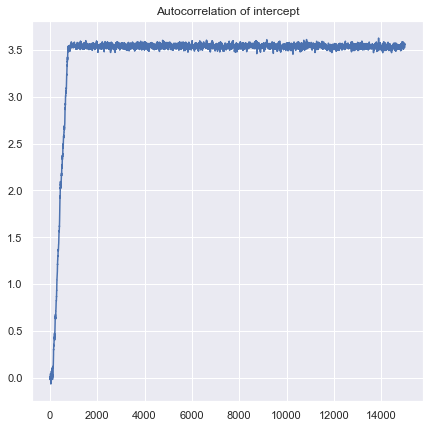

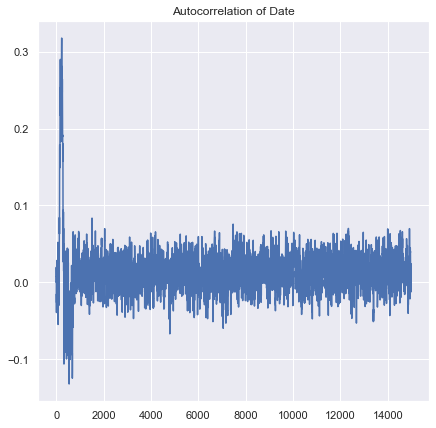

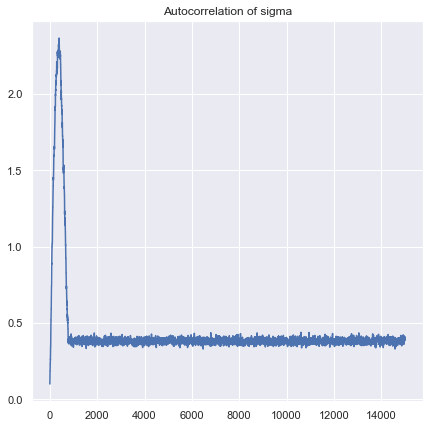

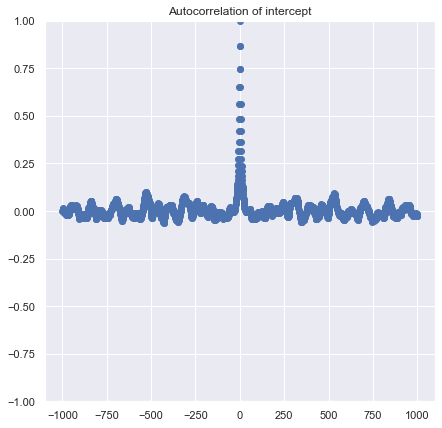

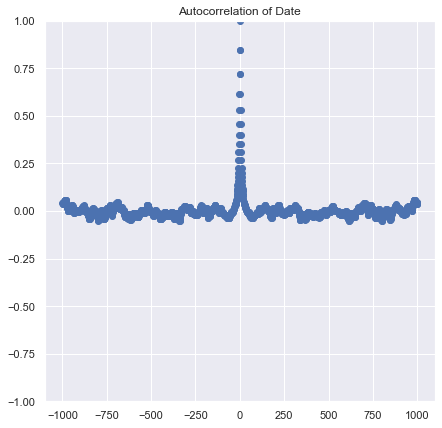

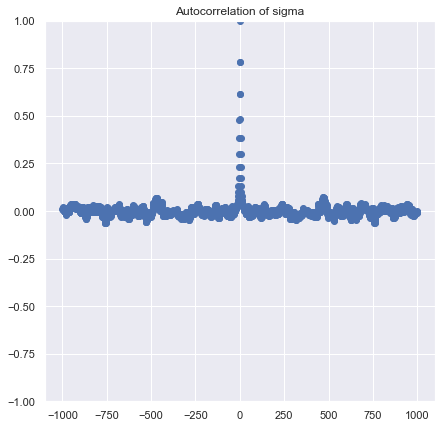

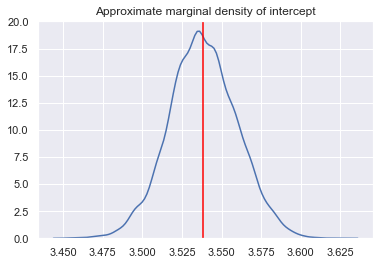

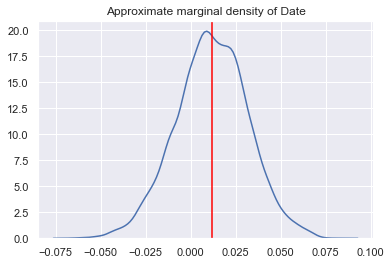

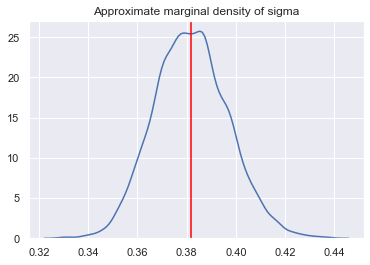

============ Fidelity summary ==================
 the mean square error is :  0.14404662175751579
 MSE test is :  202.284122087354
 PVE is  :  0.00404655858887882
 F   is  :  1.3207914630155764
 p value :  0.2512899497803557
 AIC is  :  298.2332571187676
 BIC is  :  305.82537262029837
 AICc is :  298.2700669347185


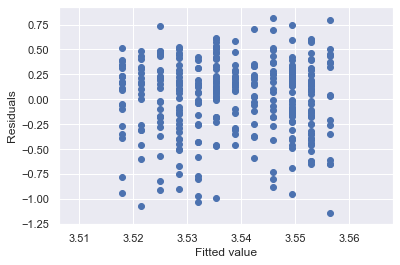

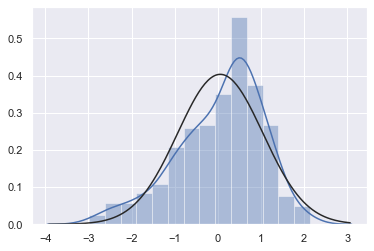

<Figure size 432x288 with 0 Axes>

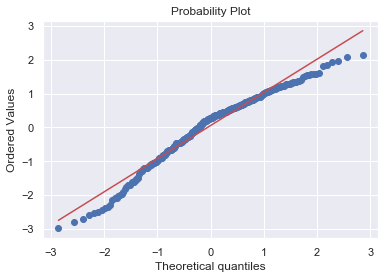

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 207.04it/s]


Acceptance rate :  0.4149333333333333
    features  Coeff   std                CI   2.5  25.0  50.0  75.0  97.5
0  intercept   3.54  0.02    [3.499, 3.580]  3.50  3.53  3.54  3.55  3.58
1  House_age  -0.08  0.02  [-0.120, -0.042] -0.12 -0.09 -0.08 -0.07 -0.04
2      sigma   0.37  0.02    [0.343, 0.403]  0.34  0.36  0.37  0.38  0.40


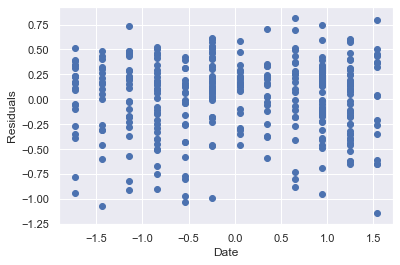

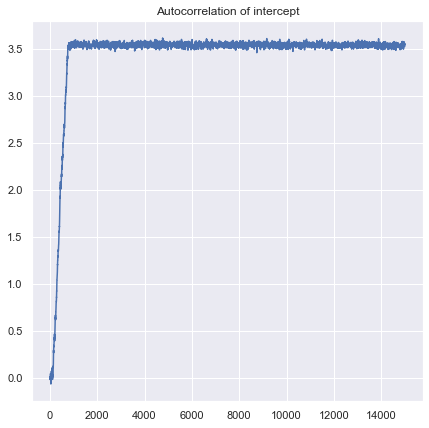

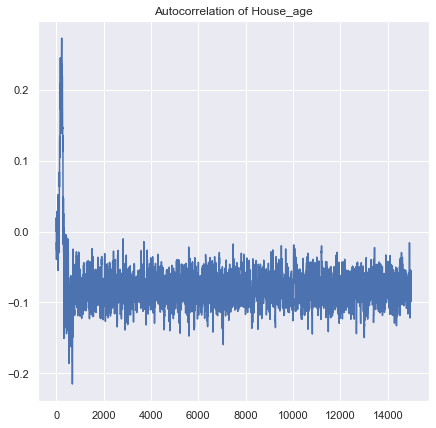

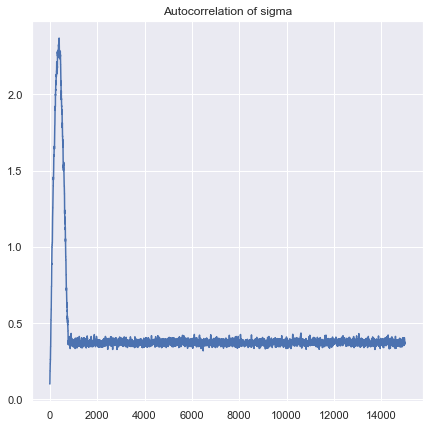

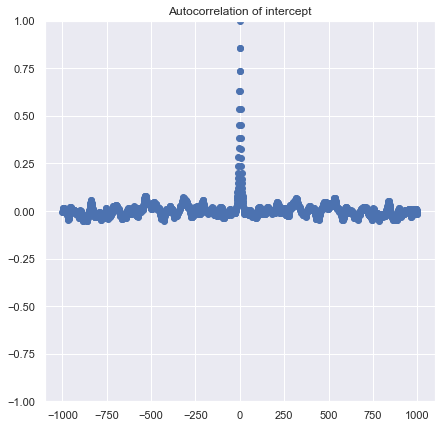

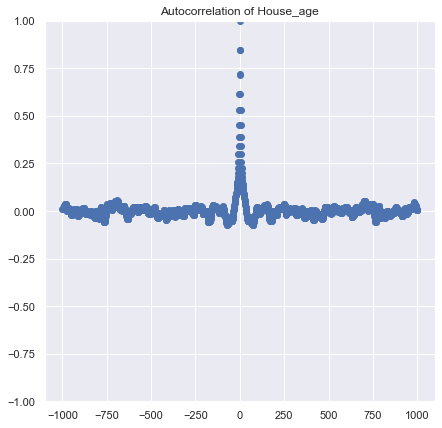

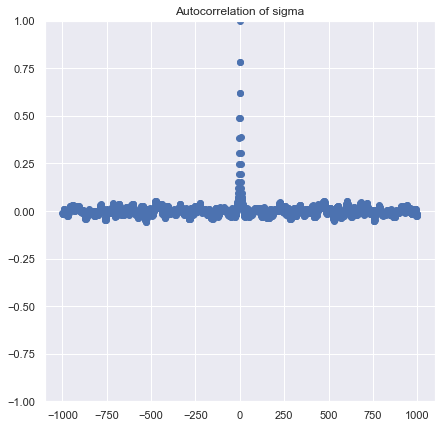

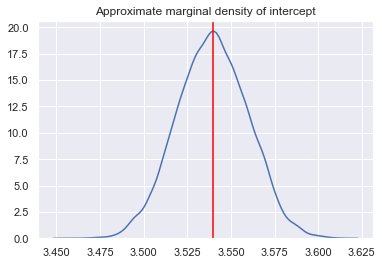

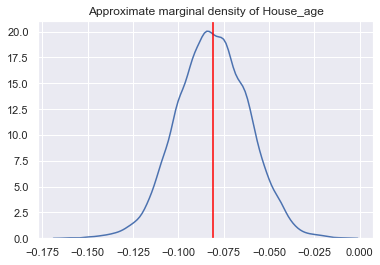

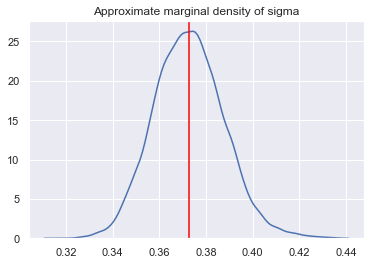

============ Fidelity summary ==================
 the mean square error is :  0.1372608182151164
 MSE test is :  198.87456130130516
 PVE is  :  0.05204556370323377
 F   is  :  17.827425539627885
 p value :  3.138515312517409e-05
 AIC is  :  282.3600325135879
 BIC is  :  289.95214801511867
 AICc is :  282.3968423295388


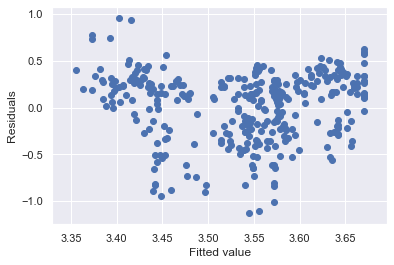

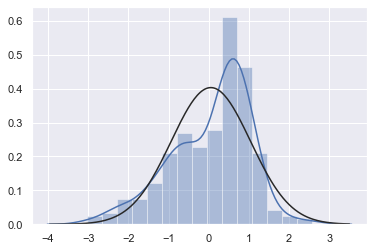

<Figure size 432x288 with 0 Axes>

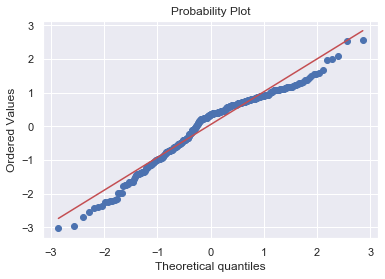

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 205.77it/s]


Acceptance rate :  0.25606666666666666
       features  Coeff   std                CI   2.5  25.0  50.0  75.0  97.5
0     intercept   3.55  0.01    [3.523, 3.578]  3.52  3.54  3.55  3.56  3.58
1  MRT_distance  -0.28  0.01  [-0.307, -0.255] -0.31 -0.29 -0.28 -0.27 -0.26
2         sigma   0.25  0.01    [0.227, 0.268]  0.23  0.24  0.25  0.25  0.27


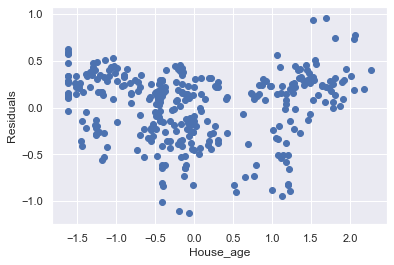

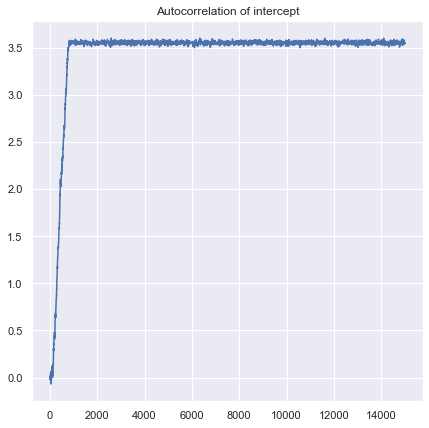

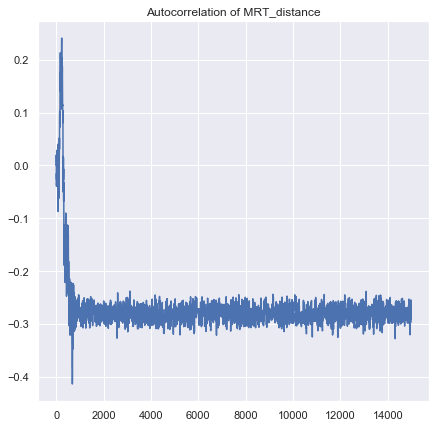

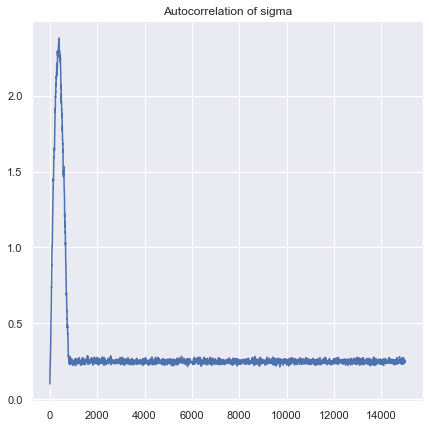

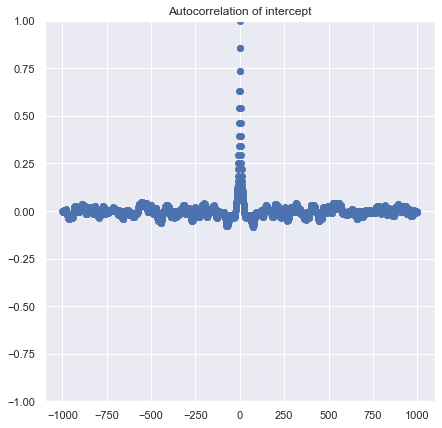

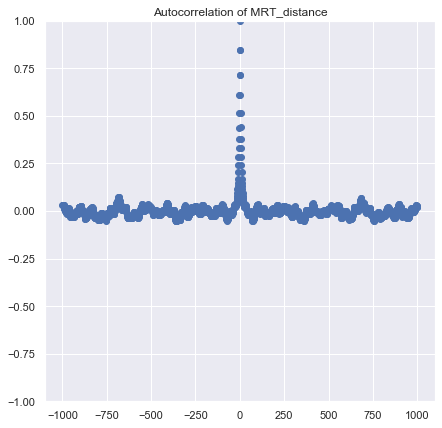

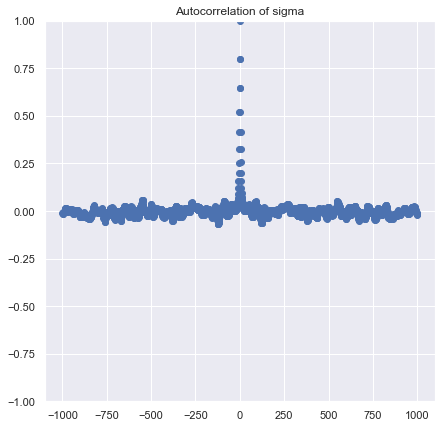

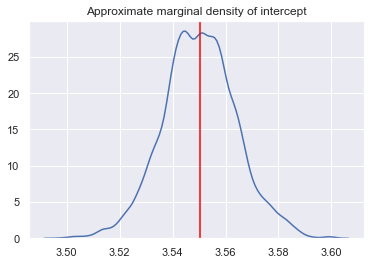

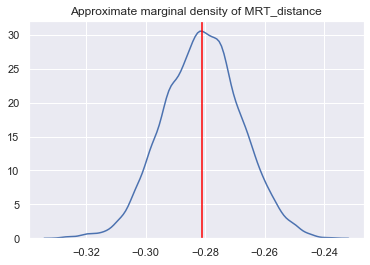

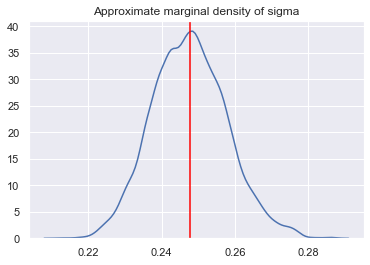

============ Fidelity summary ==================
 the mean square error is :  0.060627325978815774
 MSE test is :  78.11695548222424
 PVE is  :  0.5816233295560305
 F   is  :  451.05022353325177
 p value :  1.1102230246251565e-16
 AIC is  :  13.514304249790635
 BIC is  :  21.10641975132138
 AICc is :  13.551114065741556


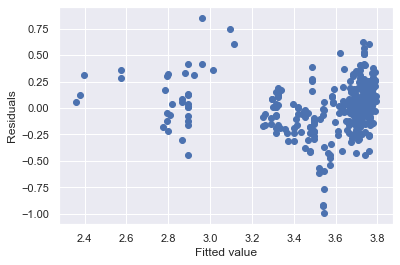

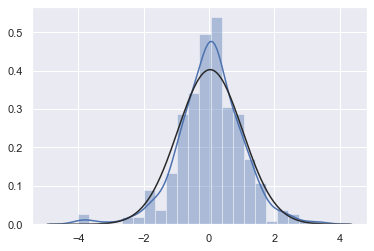

<Figure size 432x288 with 0 Axes>

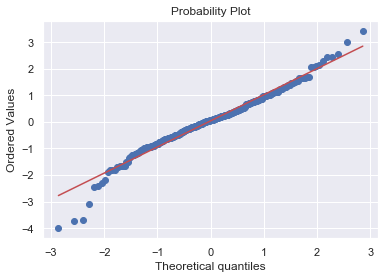

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 213.31it/s]


Acceptance rate :  0.3333333333333333
           features  Coeff   std              CI   2.5  25.0  50.0  75.0  97.5
0         intercept   3.55  0.02  [3.512, 3.580]  3.51  3.53  3.55  3.56  3.58
1  Conv_store_count   0.23  0.02  [0.195, 0.261]  0.20  0.22  0.23  0.24  0.26
2             sigma   0.30  0.01  [0.279, 0.328]  0.28  0.30  0.30  0.31  0.33


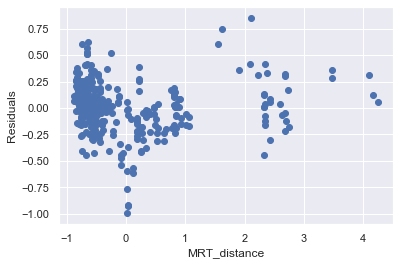

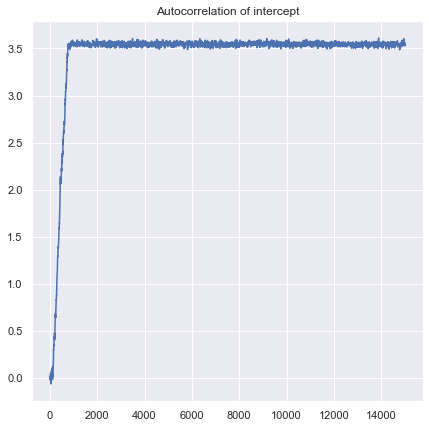

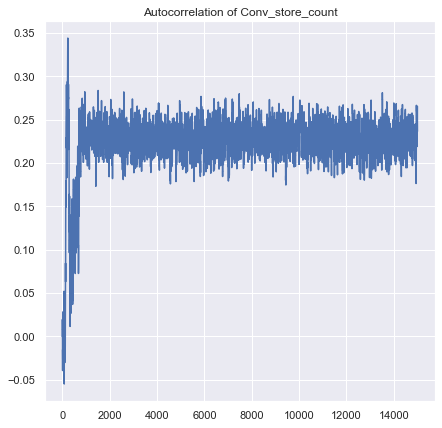

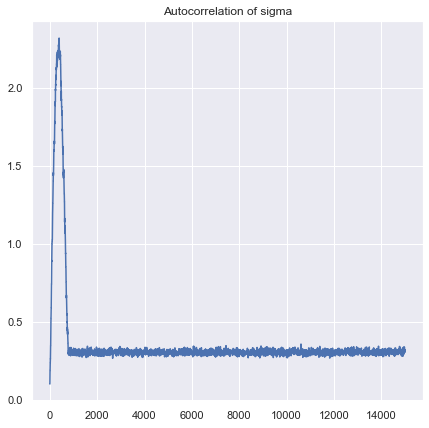

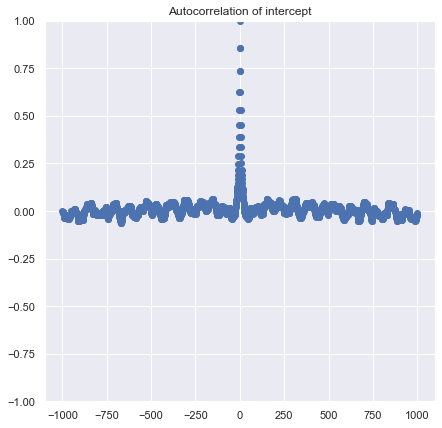

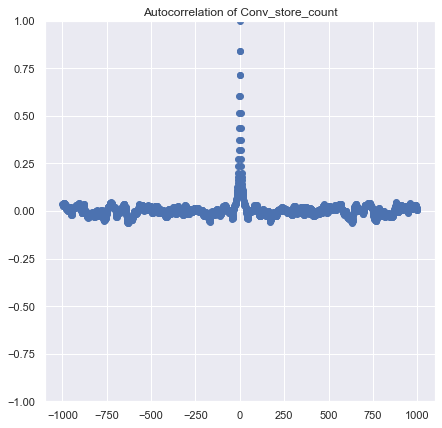

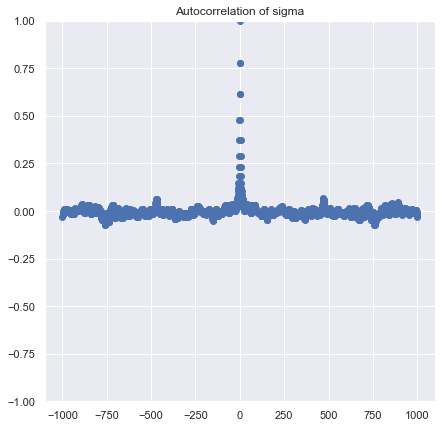

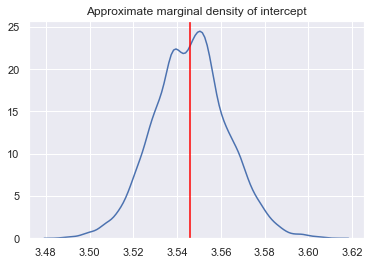

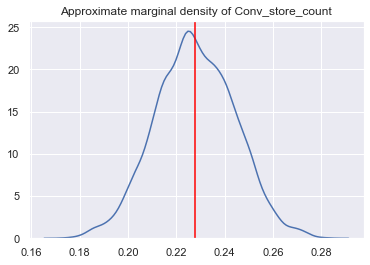

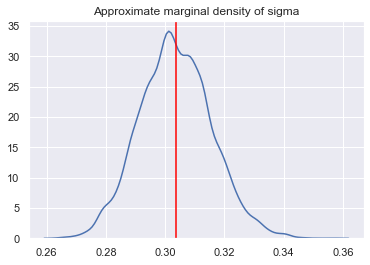

============ Fidelity summary ==================
 the mean square error is :  0.0909992762124557
 MSE test is :  99.94070952901161
 PVE is  :  0.36319095685976804
 F   is  :  187.65000755931027
 p value :  1.1102230246251565e-16
 AIC is  :  147.13195862510818
 BIC is  :  154.72407412663893
 AICc is :  147.16876844105911


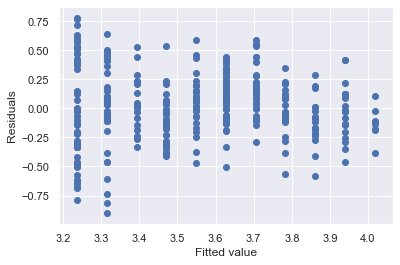

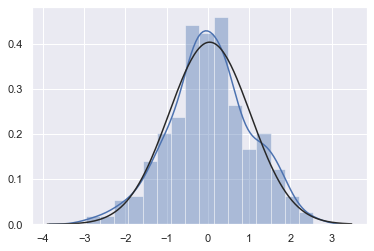

<Figure size 432x288 with 0 Axes>

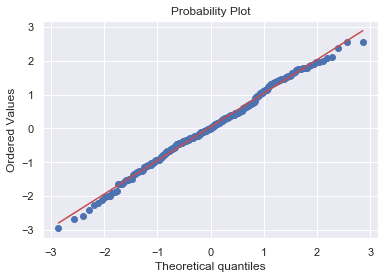

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 205.63it/s]


Acceptance rate :  0.3344
    features  Coeff   std              CI   2.5  25.0  50.0  75.0  97.5
0  intercept   3.55  0.02  [3.512, 3.580]  3.51  3.53  3.55  3.56  3.58
1   Latitude   0.22  0.02  [0.191, 0.256]  0.19  0.21  0.22  0.23  0.26
2      sigma   0.31  0.01  [0.281, 0.329]  0.28  0.30  0.30  0.31  0.33


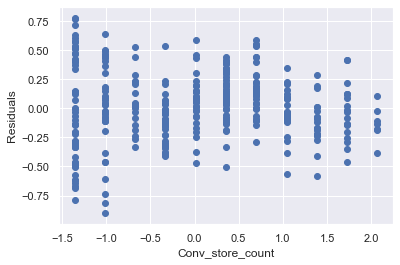

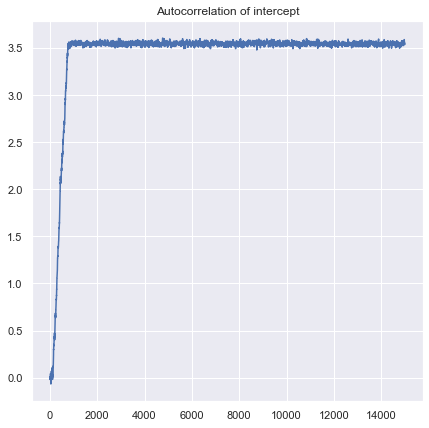

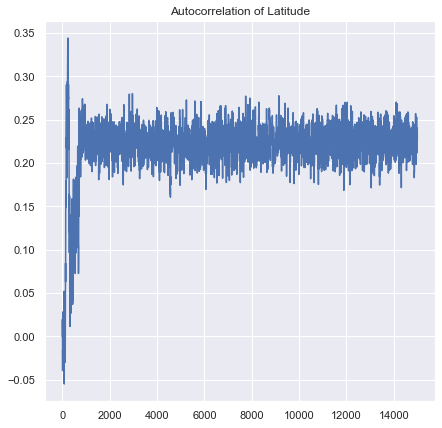

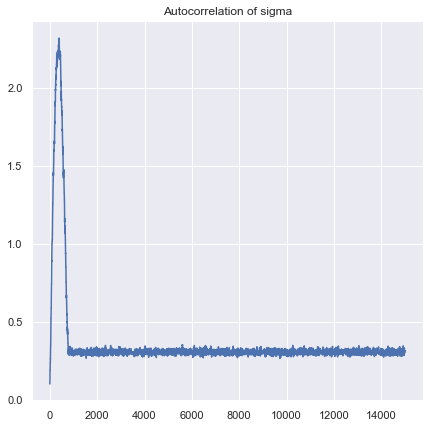

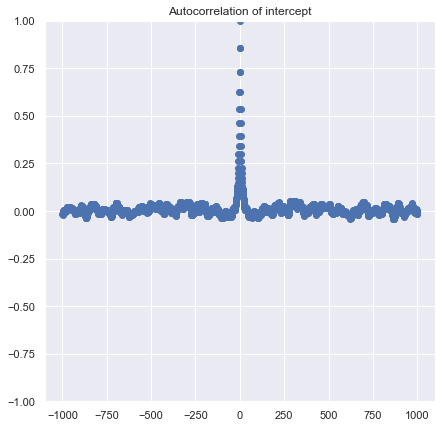

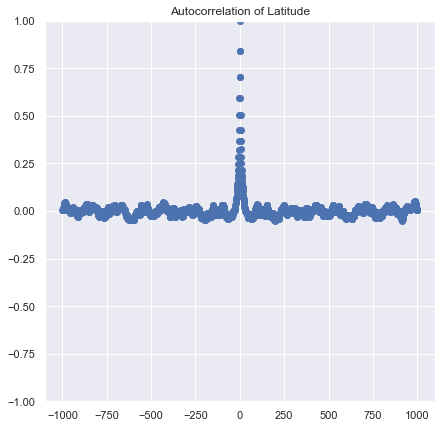

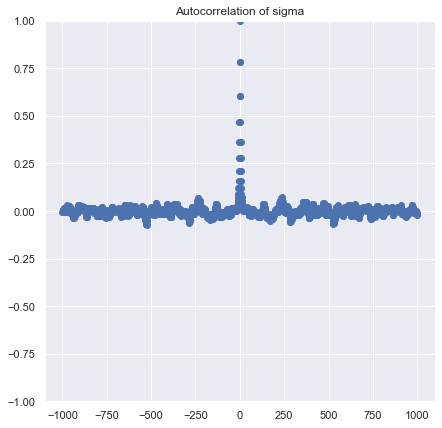

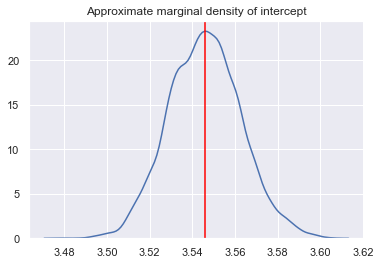

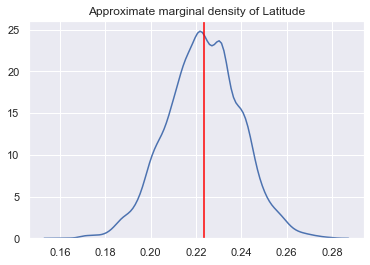

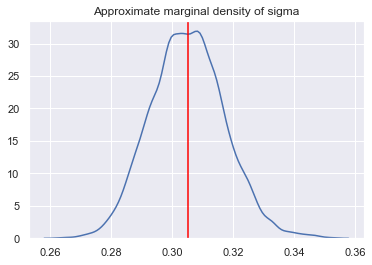

============ Fidelity summary ==================
 the mean square error is :  0.09199461676471839
 MSE test is :  115.55873939860507
 PVE is  :  0.3572394339707072
 F   is  :  182.57801281997376
 p value :  1.1102230246251565e-16
 AIC is  :  150.7086809652437
 BIC is  :  158.30079646677444
 AICc is :  150.74549078119463


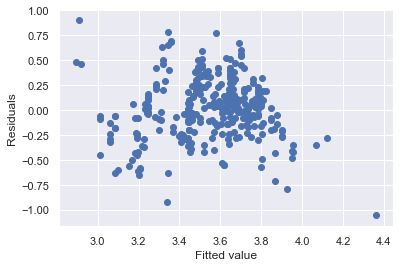

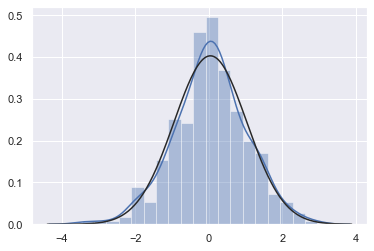

<Figure size 432x288 with 0 Axes>

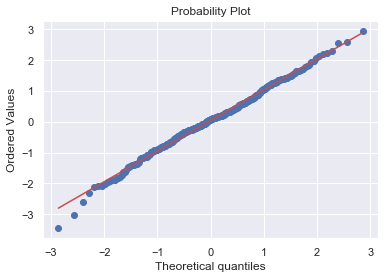

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 210.52it/s]


Acceptance rate :  0.3218
    features  Coeff   std              CI   2.5  25.0  50.0  75.0  97.5
0  intercept   3.55  0.02  [3.515, 3.579]  3.52  3.54  3.55  3.56  3.58
1  Longitude   0.24  0.02  [0.205, 0.266]  0.21  0.23  0.23  0.25  0.27
2      sigma   0.29  0.01  [0.271, 0.317]  0.27  0.29  0.29  0.30  0.32


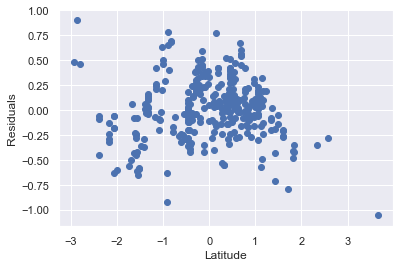

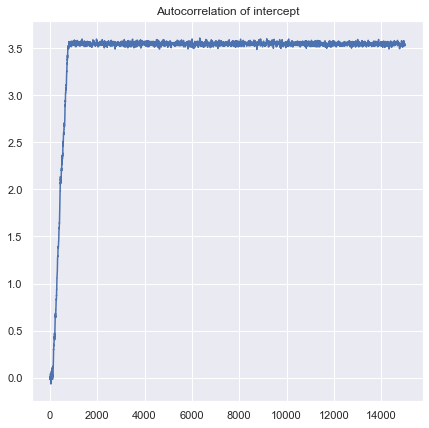

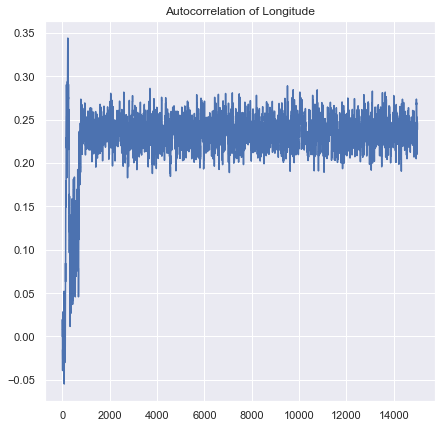

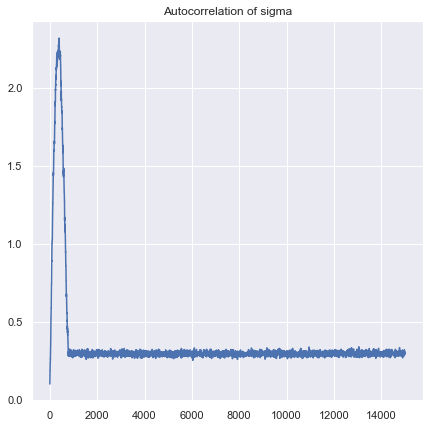

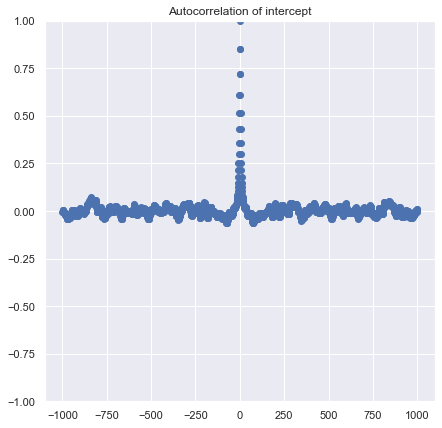

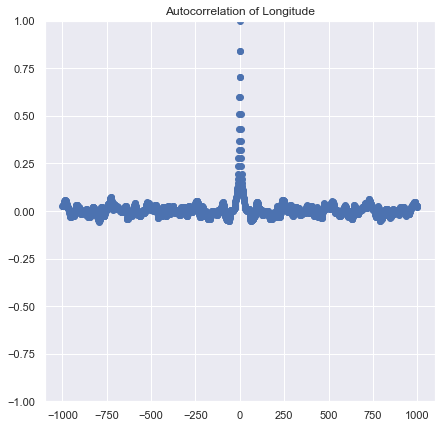

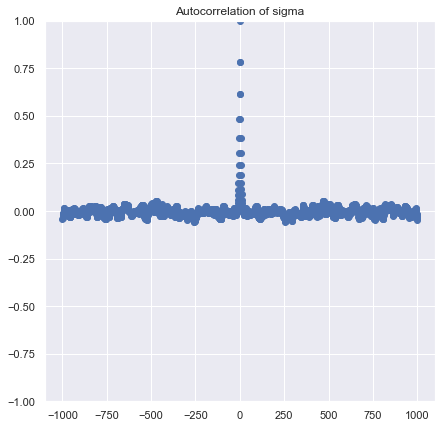

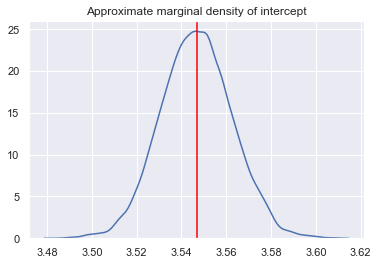

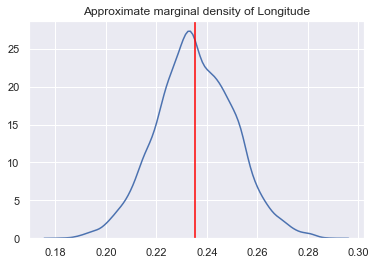

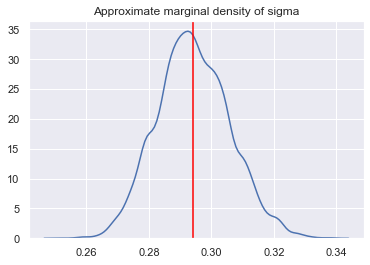

============ Fidelity summary ==================
 the mean square error is :  0.0856548912271913
 MSE test is :  161.6423076932671
 PVE is  :  0.400413794163607
 F   is  :  219.79021830149387
 p value :  1.1102230246251565e-16
 AIC is  :  127.20893465555885
 BIC is  :  134.8010501570896
 AICc is :  127.24574447150977


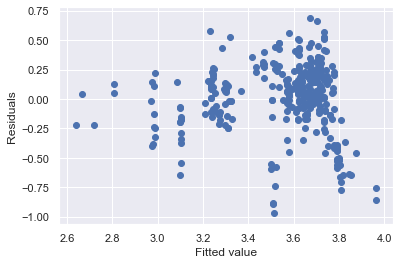

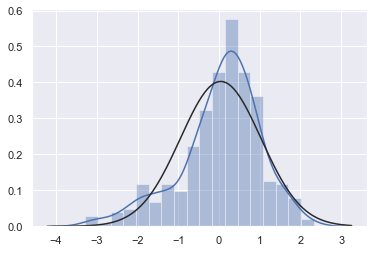

<Figure size 432x288 with 0 Axes>

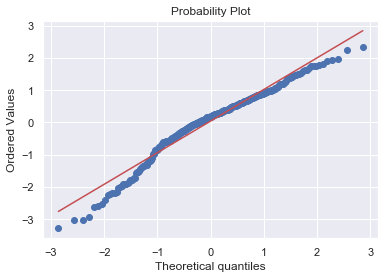

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:13<00:00, 203.84it/s]


Acceptance rate :  0.235
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.526, 3.577]  3.53  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.30  0.01  [-0.320, -0.271] -0.32 -0.30 -0.30 -0.29   
2              sigma   0.23  0.01    [0.213, 0.249]  0.21  0.22  0.23  0.24   

   97.5  
0  3.58  
1 -0.27  
2  0.25  


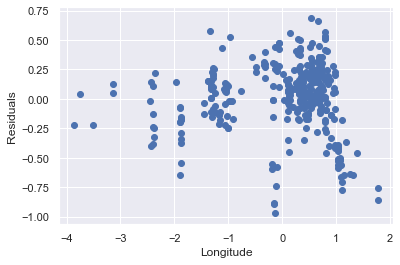

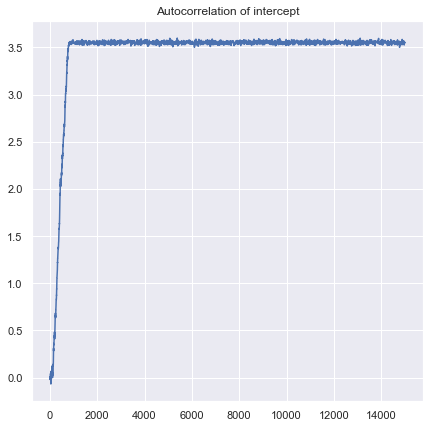

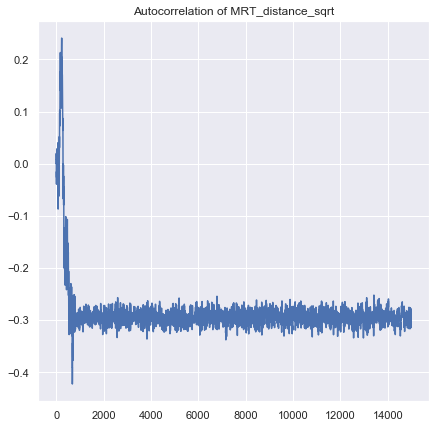

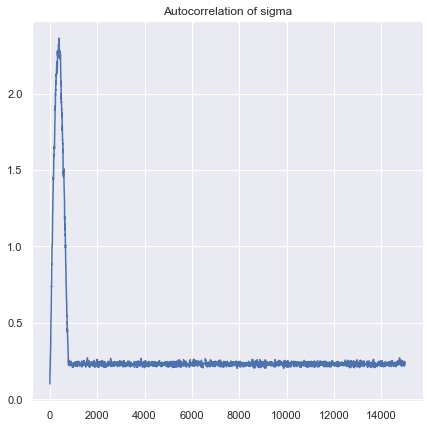

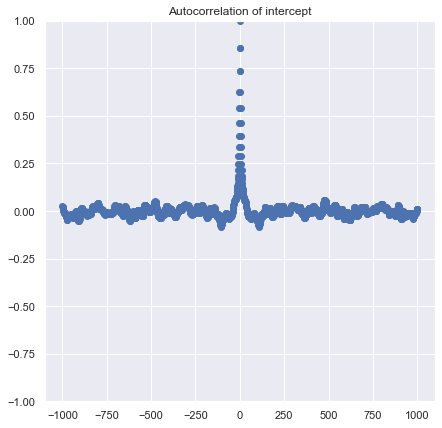

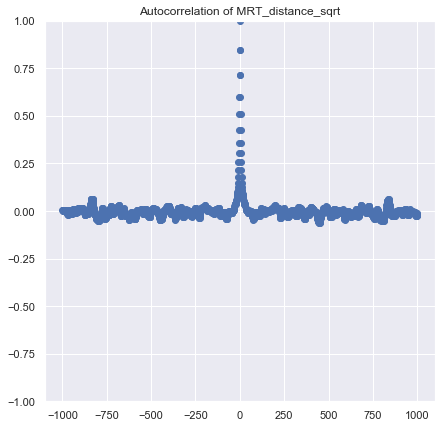

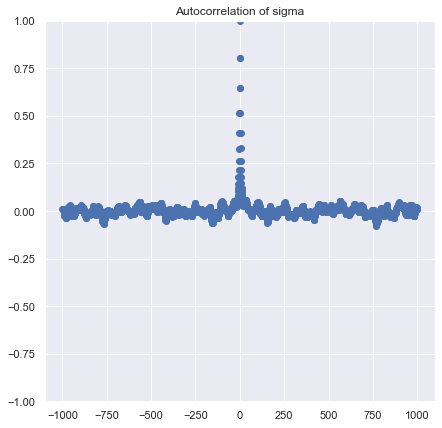

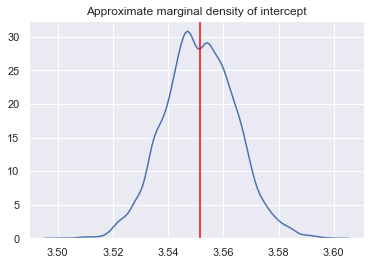

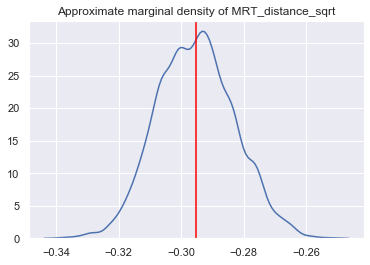

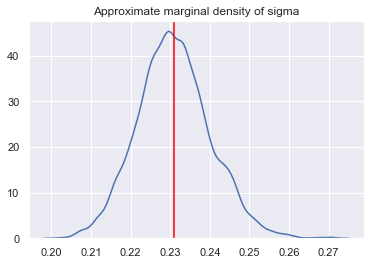

============ Fidelity summary ==================
 the mean square error is :  0.05265172557152048
 MSE test is :  63.195699109601975
 PVE is  :  0.6329441853841719
 F   is  :  565.20279831474
 p value :  1.1102230246251565e-16
 AIC is  :  -32.87984314343794
 BIC is  :  -25.287727641907196
 AICc is :  -32.84303332748702


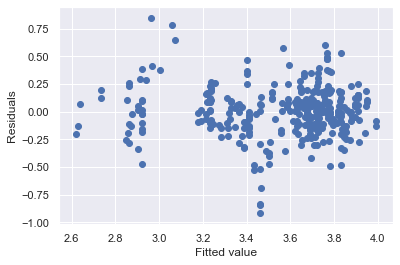

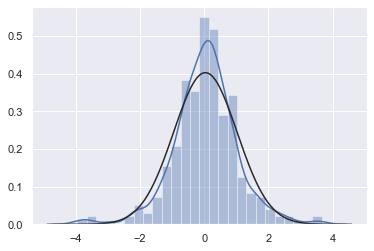

<Figure size 432x288 with 0 Axes>

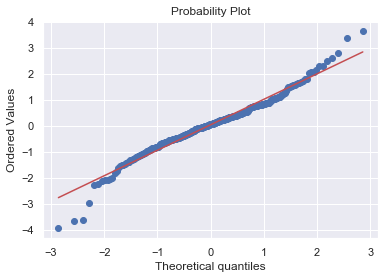

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 207.72it/s]


Acceptance rate :  0.26993333333333336
      features  Coeff   std                CI   2.5  25.0  50.0  75.0  97.5
0    intercept   3.55  0.01    [3.521, 3.578]  3.52  3.54  3.55  3.56  3.58
1  dist_center  -0.27  0.01  [-0.302, -0.247] -0.30 -0.28 -0.27 -0.27 -0.25
2        sigma   0.26  0.01    [0.240, 0.281]  0.24  0.25  0.26  0.27  0.28


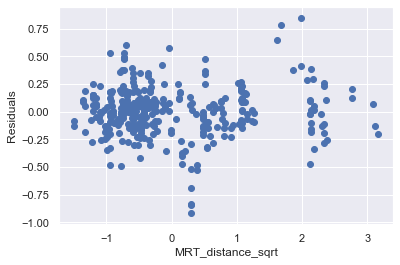

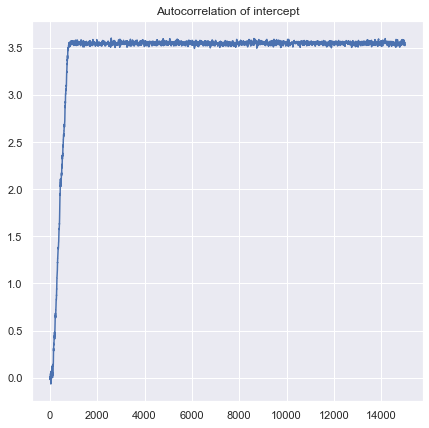

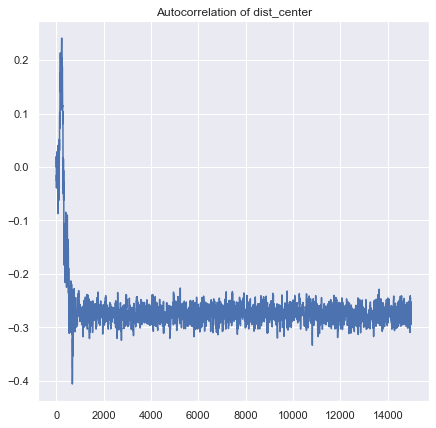

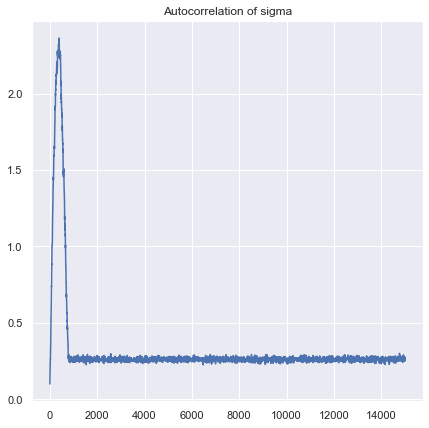

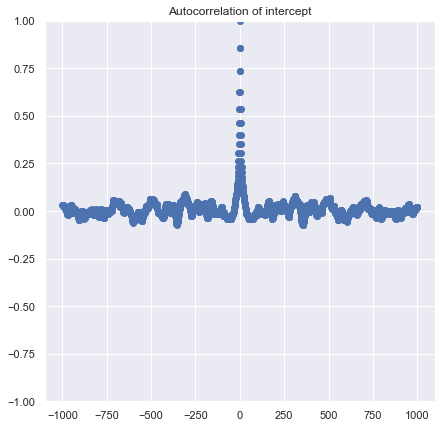

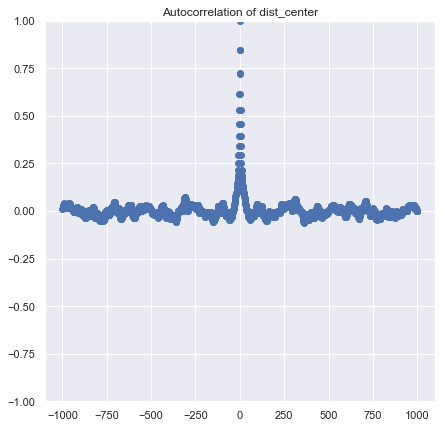

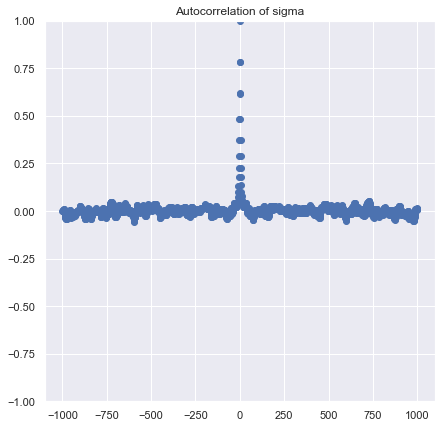

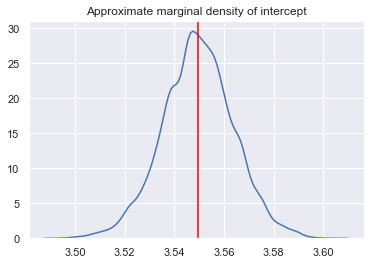

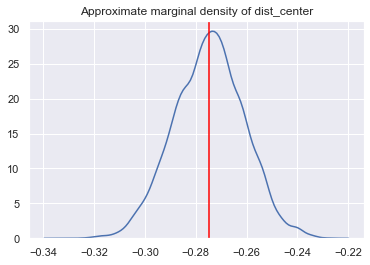

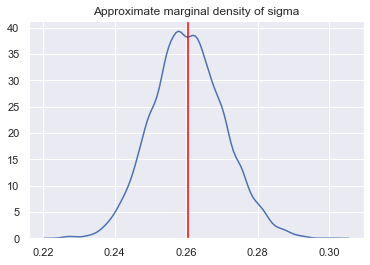

============ Fidelity summary ==================
 the mean square error is :  0.06719240570514616
 MSE test is :  110.01587368910182
 PVE is  :  0.5322014579322916
 F   is  :  372.39802349826937
 p value :  1.1102230246251565e-16
 AIC is  :  47.33475158628279
 BIC is  :  54.926867087813534
 AICc is :  47.37156140223371


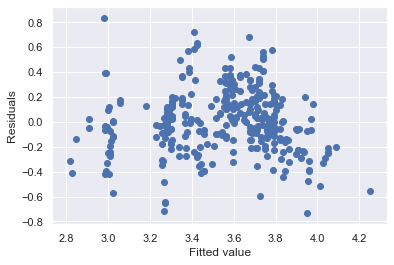

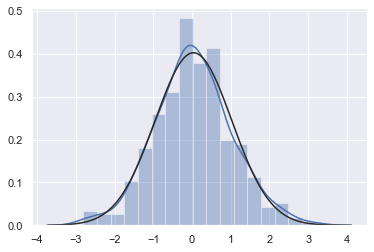

<Figure size 432x288 with 0 Axes>

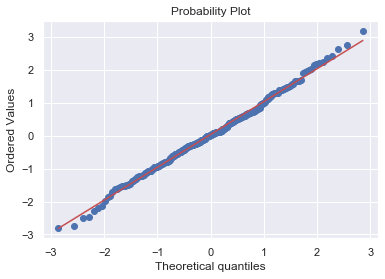

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.38it/s]


Acceptance rate :  0.36973333333333336
      features  Coeff   std              CI   2.5  25.0  50.0  75.0  97.5
0    intercept   3.54  0.02  [3.505, 3.580]  3.51  3.53  3.54  3.55  3.58
1  orientation   0.18  0.02  [0.146, 0.217]  0.15  0.17  0.18  0.19  0.22
2        sigma   0.33  0.01  [0.307, 0.359]  0.31  0.32  0.33  0.34  0.36


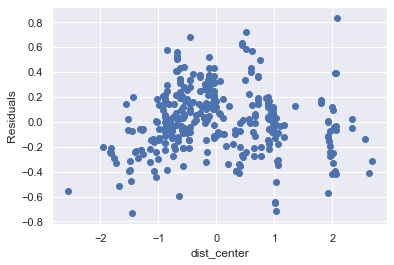

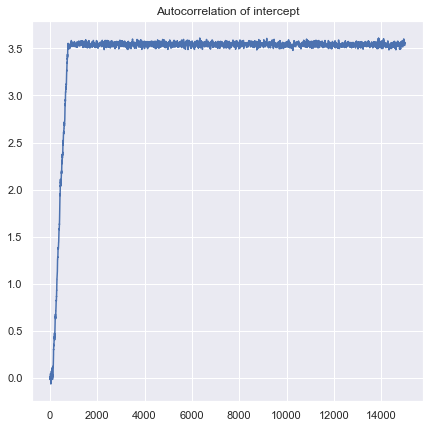

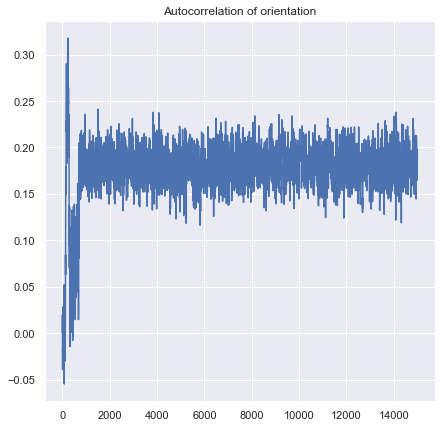

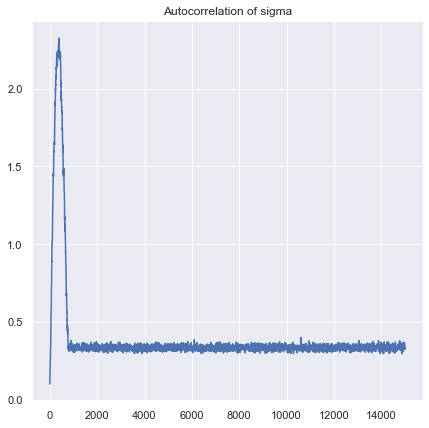

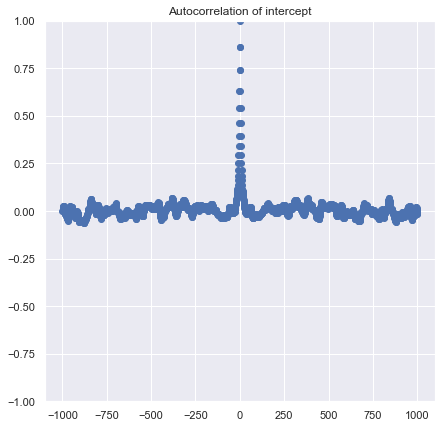

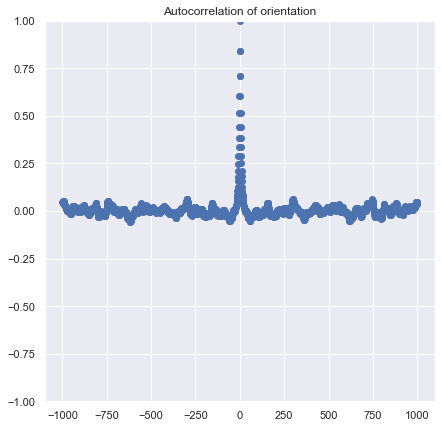

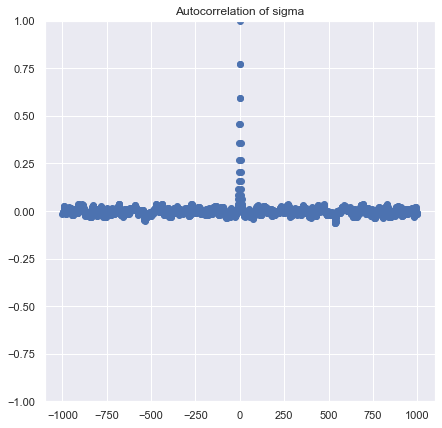

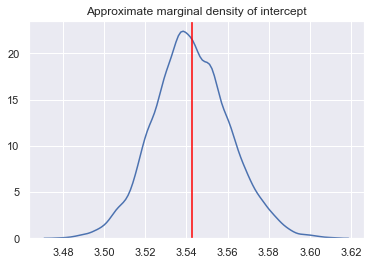

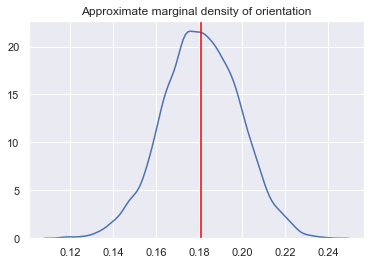

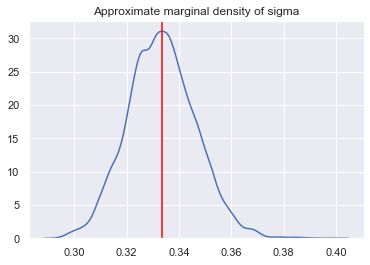

============ Fidelity summary ==================
 the mean square error is :  0.10988103002128795
 MSE test is :  139.76187368853226
 PVE is  :  0.2352065617534508
 F   is  :  100.64175686700992
 p value :  1.1102230246251565e-16
 AIC is  :  209.1574872069912
 BIC is  :  216.74960270852193
 AICc is :  209.19429702294212


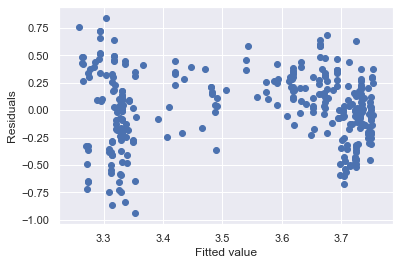

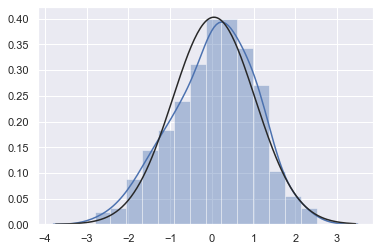

<Figure size 432x288 with 0 Axes>

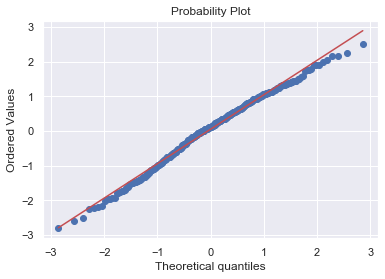

             feature  MSE_train    MSE_test       PVE           F  \
0               Date   0.144047  202.284122  0.004047    1.320791   
1          House_age   0.137261  198.874561  0.052046   17.827426   
2       MRT_distance   0.060627   78.116955  0.581623  451.050224   
3   Conv_store_count   0.090999   99.940710  0.363191  187.650008   
4           Latitude   0.091995  115.558739  0.357239  182.578013   
5          Longitude   0.085655  161.642308  0.400414  219.790218   
6  MRT_distance_sqrt   0.052652   63.195699  0.632944  565.202798   
7        dist_center   0.067192  110.015874  0.532201  372.398023   
8        orientation   0.109881  139.761874  0.235207  100.641757   

          p_val         AIC        AICc         BIC  
0  2.512899e-01  298.233257  305.825373  305.825373  
1  3.138515e-05  282.360033  289.952148  289.952148  
2  1.110223e-16   13.514304   21.106420   21.106420  
3  1.110223e-16  147.131959  154.724074  154.724074  
4  1.110223e-16  150.708681  158.300796

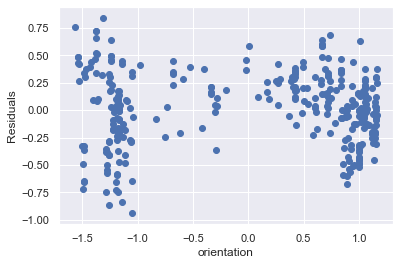

In [5]:
MSE_train = []
MSE_test = []
PVE = []
F =[]
P_val = []
AIC = []
AICc = []
BIC = []

for predictor in X_names :
    Parameter = [ 'intercept' ,predictor ,'sigma']
    X = (data_no_outlier[[predictor]].dropna()).to_numpy()
    Model = Bayesian_framework(1,Parameter,X,Y,transformation_train = False , transformation_test = True)
    proba_set = Gaussian_model_np(Model)

    # Define the model
    Model.set_log_joint_prior(proba_set.log_joint_prior)
    Model.set_log_likelihood(proba_set.log_likelihood)
    
    # define a sample algorithm :
    init = np.array( [0,0,0.1] )
    step_size = 0.02
    num_samples = 15000

    M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

    M_H.compute_statistic()
    
    # We see that we can select a burn in that around 200
    burn_in = 1000

    M_H.compute_statistic(burn_in)
    M_H.summary()
    tool = Vizualisation_tool(Model,M_H)
    tool.trace_visualization()
    tool.autocorrelation_visualization()
    tool.marginal_visualization()
    tool.fidelity()
    tool.diagnostics()
    
    
    F_ , p_value = tool.F_test()
    
    MSE_train.append(tool.MSE())
    MSE_test.append(tool.MSE_test())
    PVE.append(tool.PVE())
    F.append(F_)
    P_val.append(p_value)
    AIC.append(tool.AIC())
    BIC.append(tool.BIC())
    AICc.append(tool.BIC())
    
table = pd.DataFrame()
table["feature"] = X_names
table["MSE_train"] = MSE_train
table["MSE_test"] = MSE_test
table["PVE"] = PVE 
table["F"] = F
table["p_val"] = P_val
table["AIC"] = AIC
table["AICc"] = AICc
table["BIC"] = BIC
print(table)
    

**Remarks :**
 - We can see that **MRT_distance_sqrt** seems to be the best coefficient
 - Residual vs MRT_distance suggest that we can add the square of MRT_distance


In [6]:
X_names = [ 'Date' ,'House_age','MRT_distance','Conv_store_count','Latitude','Longitude','dist_center','orientation' ]

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 206.33it/s]


Acceptance rate :  0.2512
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.523, 3.574]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.30  0.01  [-0.327, -0.279] -0.33 -0.31 -0.30 -0.29   
2               Date   0.06  0.01    [0.032, 0.080]  0.03  0.05  0.06  0.06   
3              sigma   0.22  0.01    [0.207, 0.241]  0.21  0.22  0.22  0.23   

   97.5  
0  3.57  
1 -0.28  
2  0.08  
3  0.24  


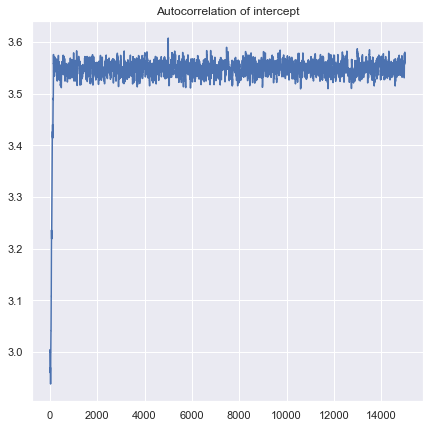

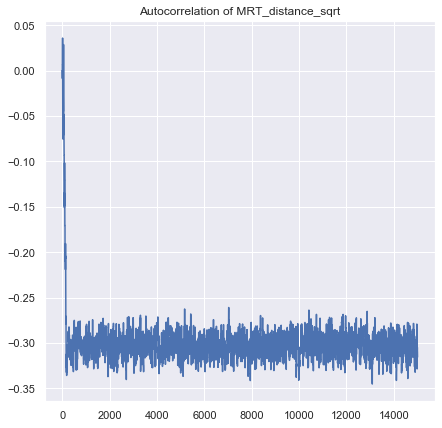

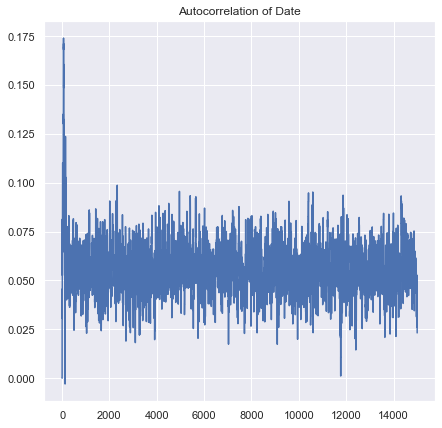

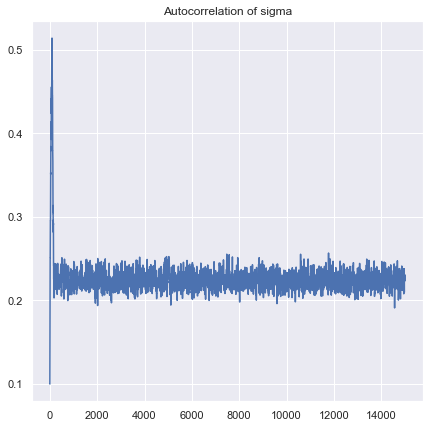

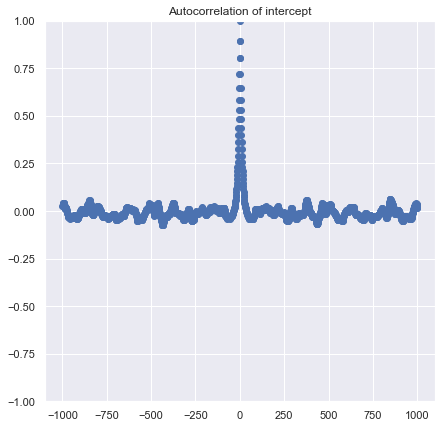

...

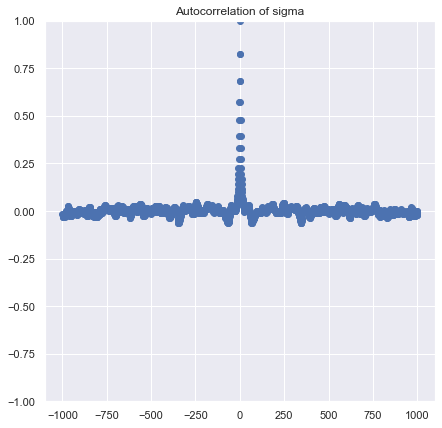

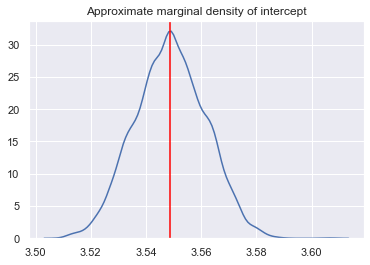

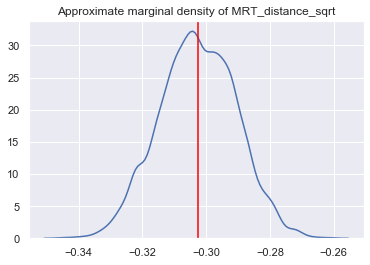

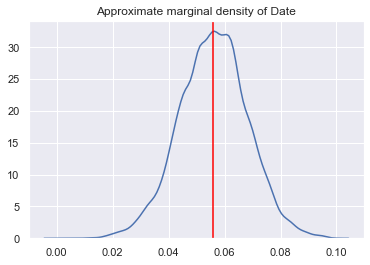

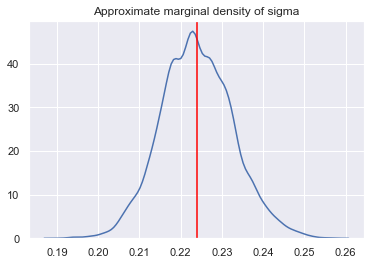

============ Fidelity summary ==================
 the mean square error is :  0.049698371358216385
 MSE test is :  59.335762651788
 PVE is  :  0.6529587671354019
 F   is  :  308.8624433420785
 p value :  1.1102230246251565e-16
 AIC is  :  -50.88244003351539
 BIC is  :  -39.49426678121927
 AICc is :  -50.80859387966923


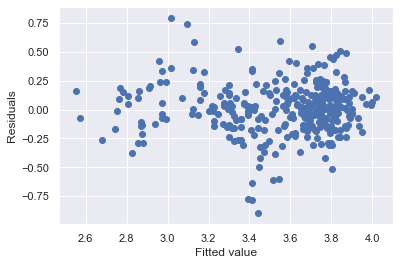

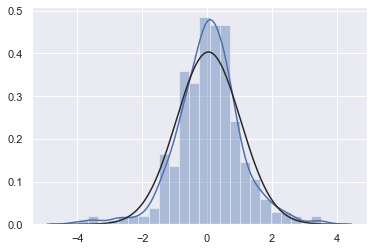

<Figure size 432x288 with 0 Axes>

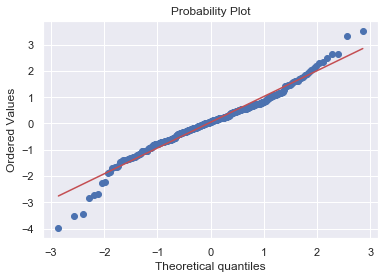

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:15<00:00, 197.99it/s]


Acceptance rate :  0.24533333333333332
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.524, 3.574]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.29  0.01  [-0.315, -0.267] -0.32 -0.30 -0.29 -0.28   
2          House_age  -0.07  0.01  [-0.091, -0.045] -0.09 -0.08 -0.07 -0.06   
3              sigma   0.22  0.01    [0.202, 0.237]  0.20  0.21  0.22  0.23   

   97.5  
0  3.57  
1 -0.27  
2 -0.05  
3  0.24  


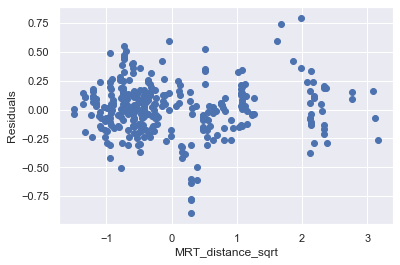

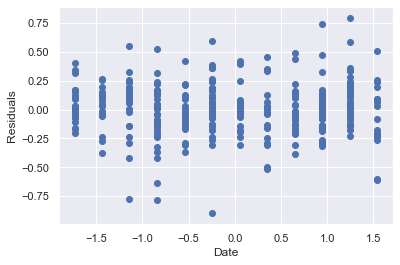

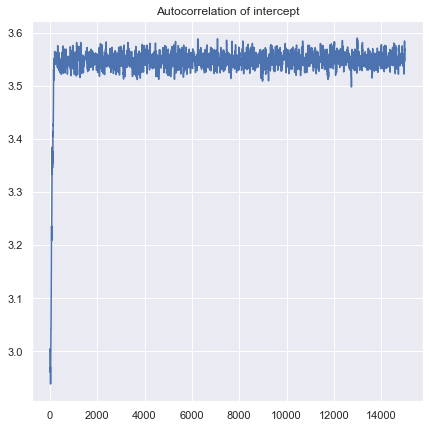

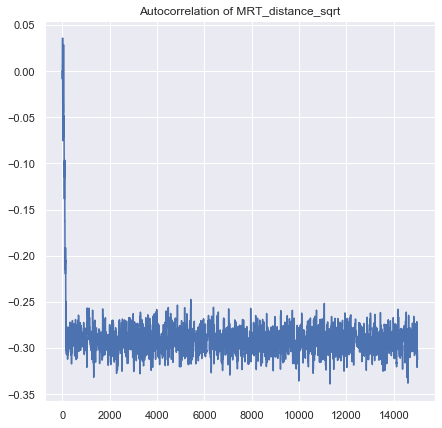

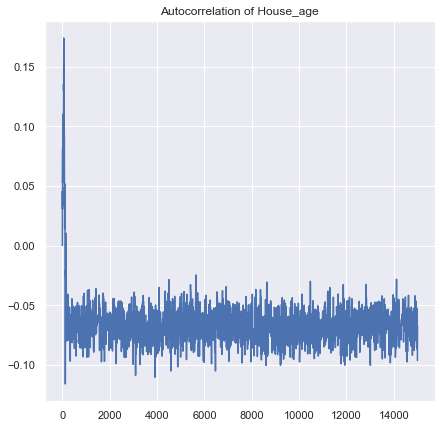

...

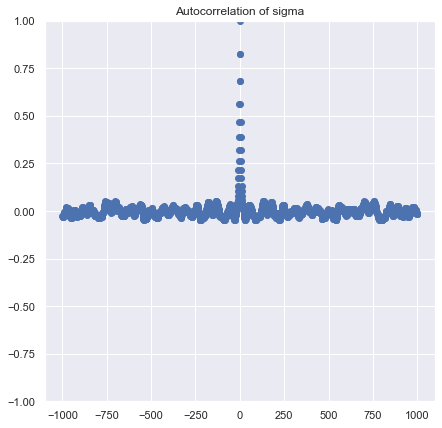

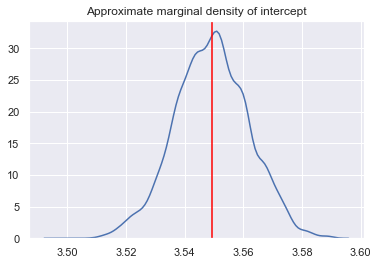

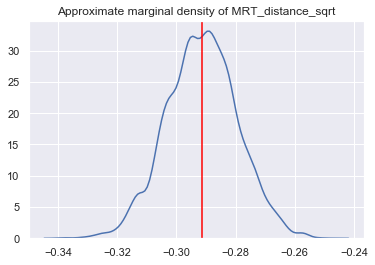

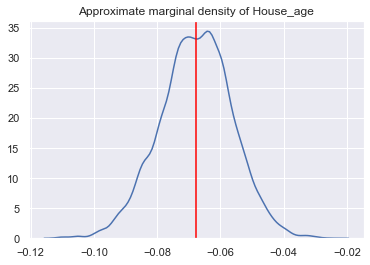

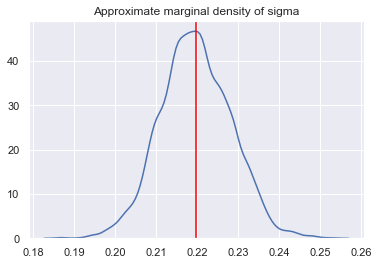

============ Fidelity summary ==================
 the mean square error is :  0.047937105884965935
 MSE test is :  62.476791003474375
 PVE is  :  0.6633882024113394
 F   is  :  325.3249976214682
 p value :  1.1102230246251565e-16
 AIC is  :  -62.76999945827801
 BIC is  :  -51.381826205981895
 AICc is :  -62.69615330443185


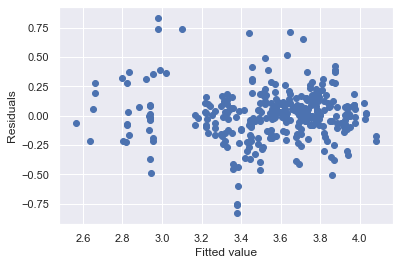

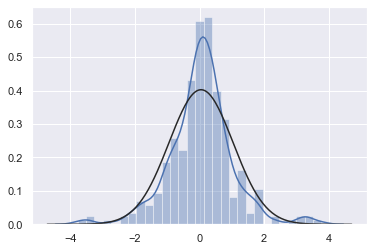

<Figure size 432x288 with 0 Axes>

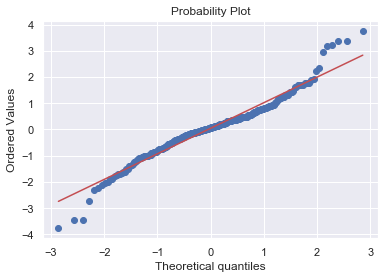

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 208.88it/s]


Acceptance rate :  0.28313333333333335
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.522, 3.573]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.35  0.05  [-0.446, -0.261] -0.44 -0.39 -0.35 -0.32   
2       MRT_distance   0.06  0.05   [-0.031, 0.152] -0.03  0.03  0.06  0.09   
3              sigma   0.23  0.01    [0.212, 0.248]  0.21  0.22  0.23  0.24   

   97.5  
0  3.57  
1 -0.26  
2  0.15  
3  0.25  


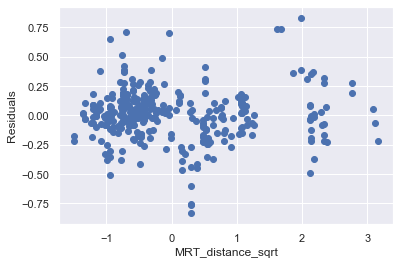

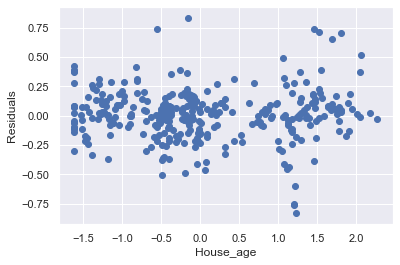

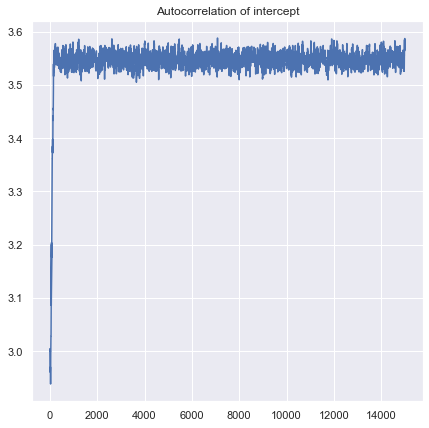

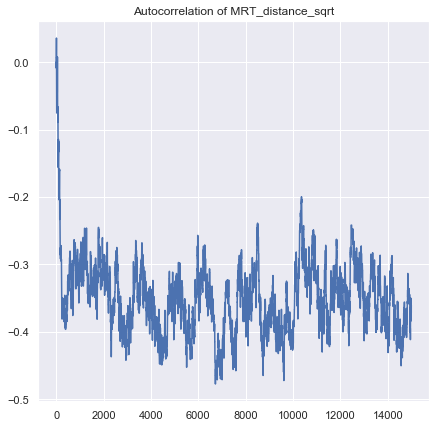

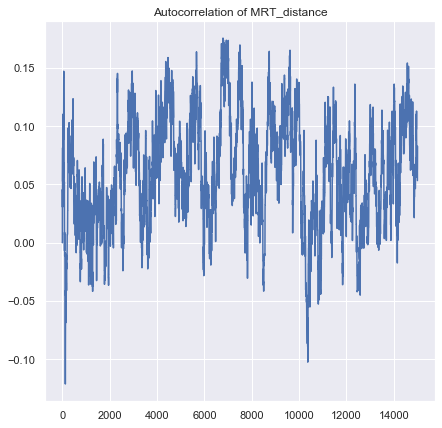

...

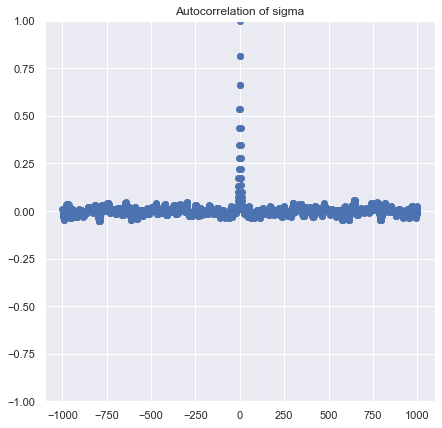

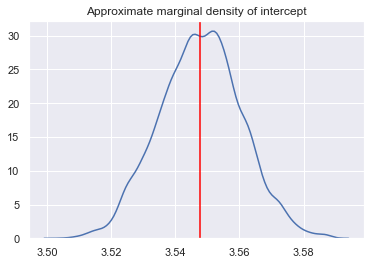

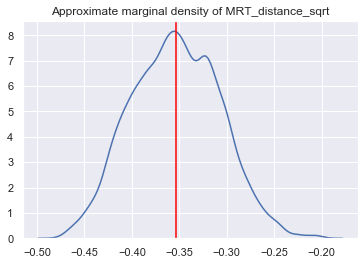

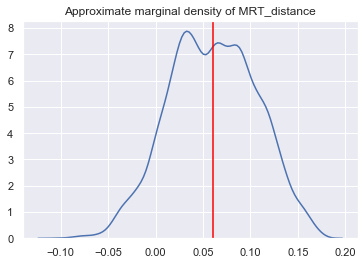

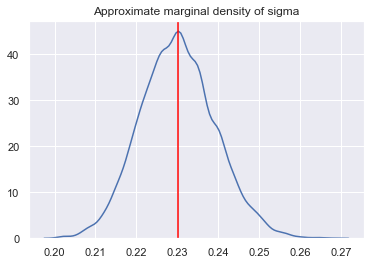

============ Fidelity summary ==================
 the mean square error is :  0.05250725584777124
 MSE test is :  63.82896112167831
 PVE is  :  0.6311771775047597
 F   is  :  282.5878385202059
 p value :  1.1102230246251565e-16
 AIC is  :  -32.79776403998804
 BIC is  :  -21.409590787691922
 AICc is :  -32.723917886141884


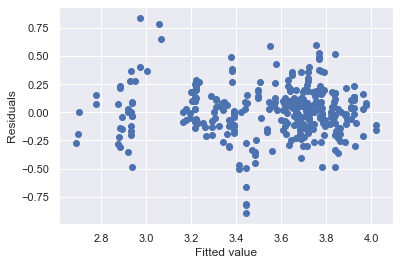

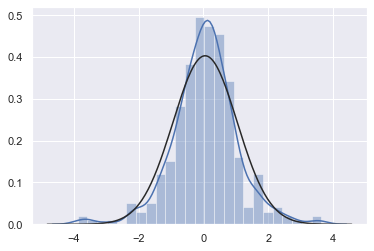

<Figure size 432x288 with 0 Axes>

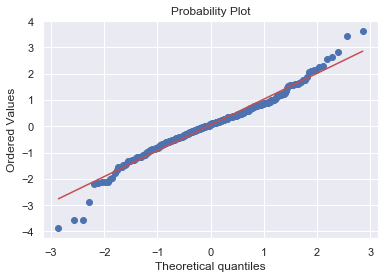

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 207.06it/s]


Acceptance rate :  0.2656
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.523, 3.574]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.26  0.02  [-0.288, -0.226] -0.29 -0.27 -0.26 -0.25   
2   Conv_store_count   0.06  0.02    [0.028, 0.091]  0.03  0.05  0.06  0.07   
3              sigma   0.23  0.01    [0.208, 0.244]  0.21  0.22  0.23  0.23   

   97.5  
0  3.57  
1 -0.23  
2  0.09  
3  0.24  


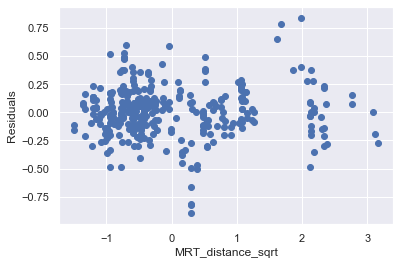

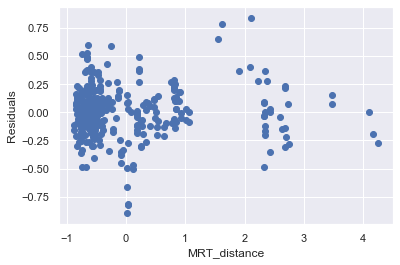

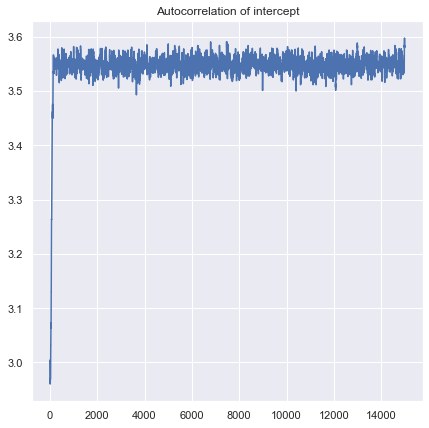

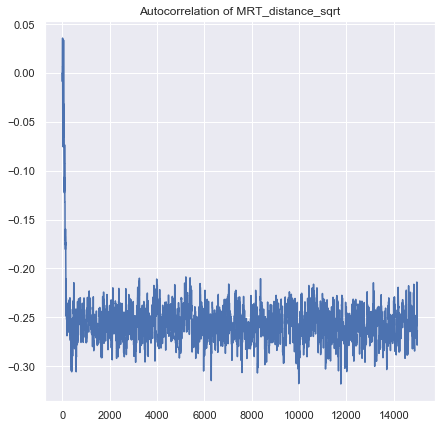

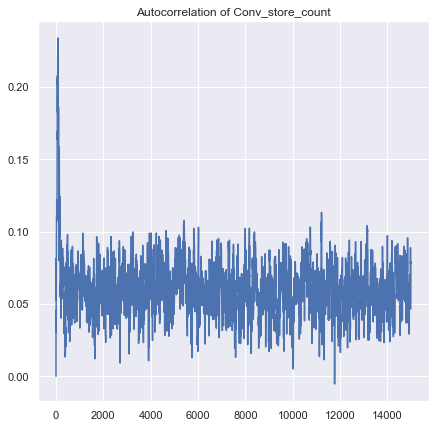

...

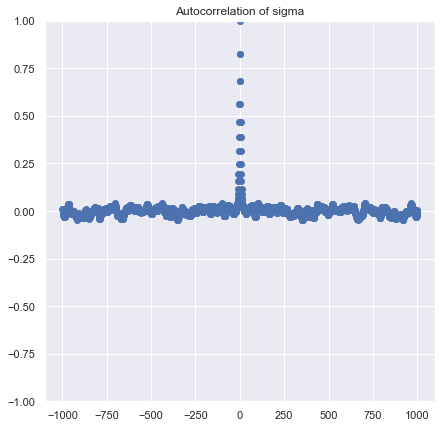

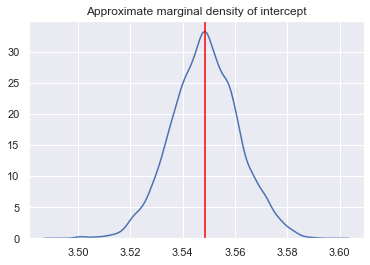

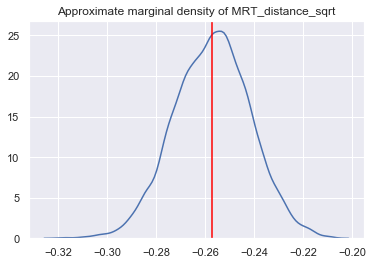

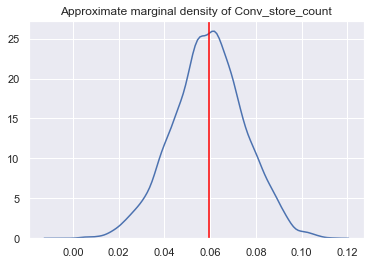

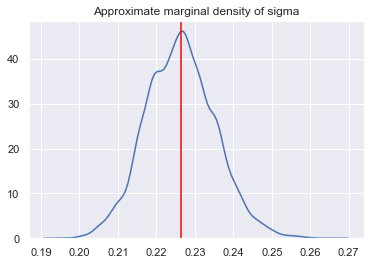

============ Fidelity summary ==================
 the mean square error is :  0.05085773762712801
 MSE test is :  58.90358247307436
 PVE is  :  0.6454185497363941
 F   is  :  298.3361688825859
 p value :  1.1102230246251565e-16
 AIC is  :  -43.30934832982199
 BIC is  :  -31.92117507752587
 AICc is :  -43.23550217597583


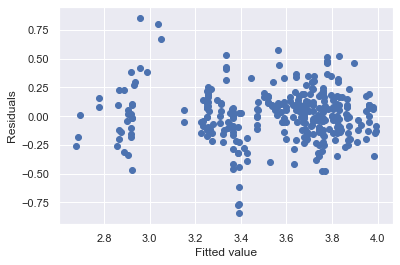

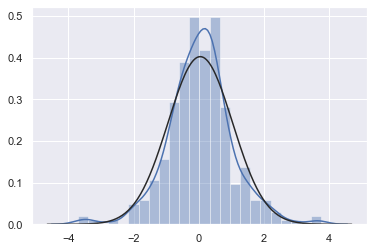

<Figure size 432x288 with 0 Axes>

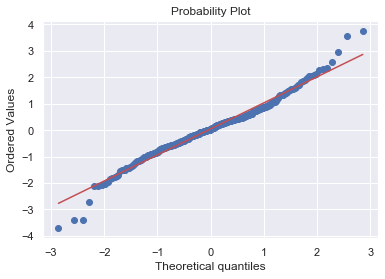

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 209.42it/s]


Acceptance rate :  0.24013333333333334
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.525, 3.574]  3.53  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.25  0.01  [-0.273, -0.219] -0.27 -0.26 -0.25 -0.24   
2           Latitude   0.10  0.01    [0.067, 0.123]  0.07  0.09  0.10  0.11   
3              sigma   0.22  0.01    [0.198, 0.233]  0.20  0.21  0.22  0.22   

   97.5  
0  3.57  
1 -0.22  
2  0.12  
3  0.23  


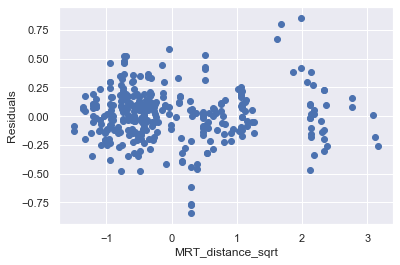

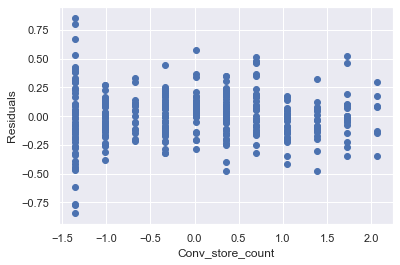

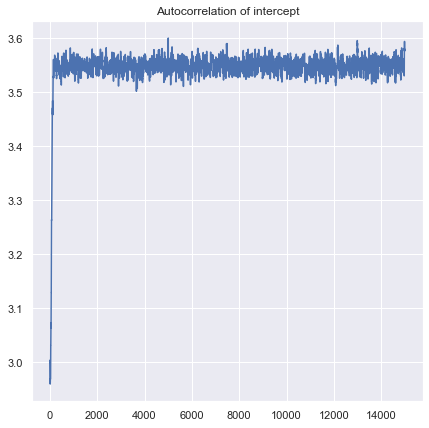

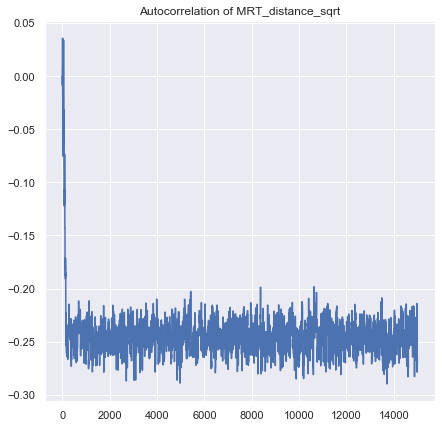

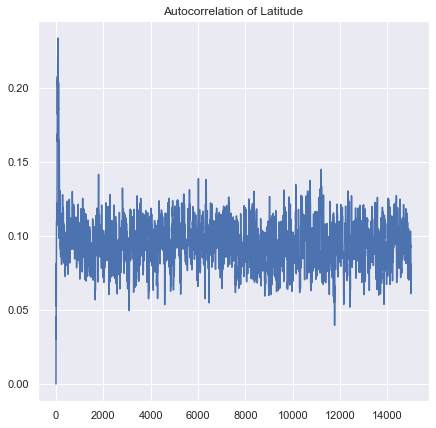

...

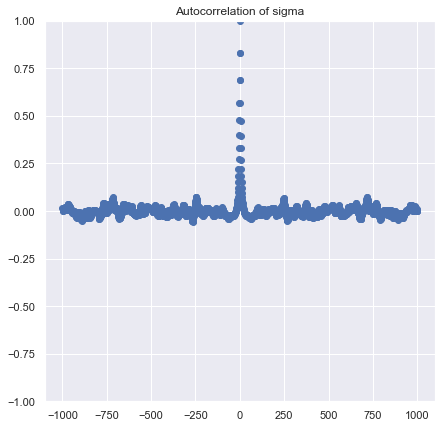

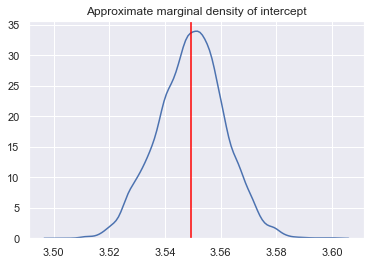

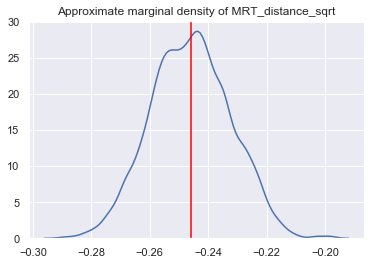

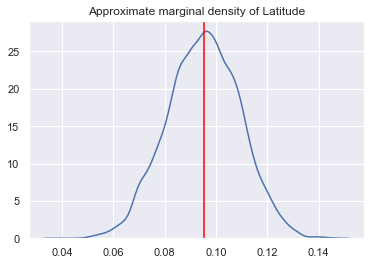

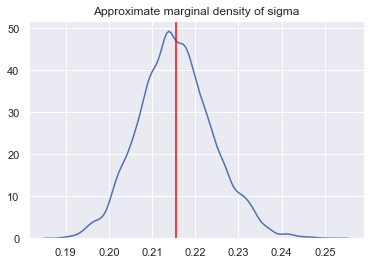

============ Fidelity summary ==================
 the mean square error is :  0.046081855208233116
 MSE test is :  57.25013099332874
 PVE is  :  0.6798541465528698
 F   is  :  346.8225267438564
 p value :  1.1102230246251565e-16
 AIC is  :  -75.74908910401959
 BIC is  :  -64.36091585172348
 AICc is :  -75.67524295017344


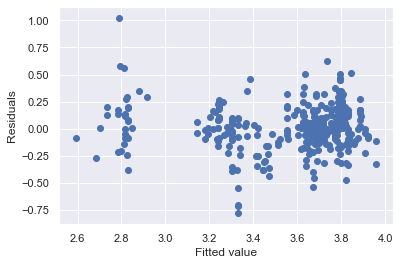

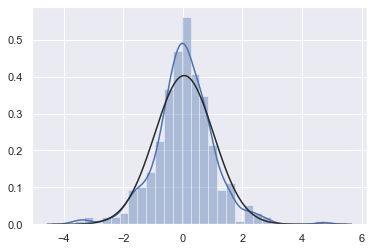

<Figure size 432x288 with 0 Axes>

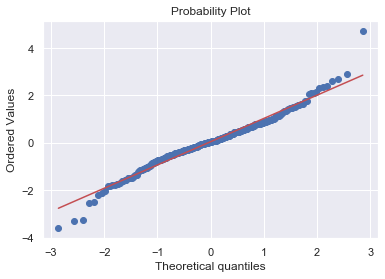

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:08<00:00, 218.46it/s]


Acceptance rate :  0.26886666666666664
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.523, 3.573]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.31  0.02  [-0.345, -0.266] -0.34 -0.32 -0.31 -0.29   
2          Longitude  -0.01  0.02   [-0.053, 0.028] -0.05 -0.03 -0.01  0.00   
3              sigma   0.23  0.01    [0.212, 0.249]  0.21  0.22  0.23  0.24   

   97.5  
0  3.57  
1 -0.27  
2  0.03  
3  0.25  


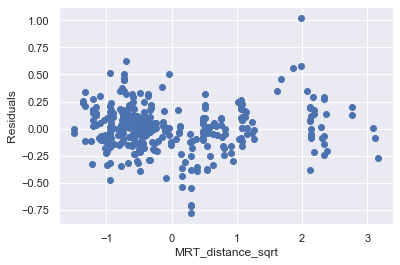

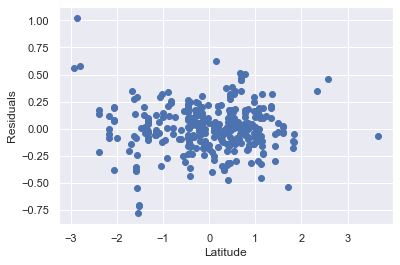

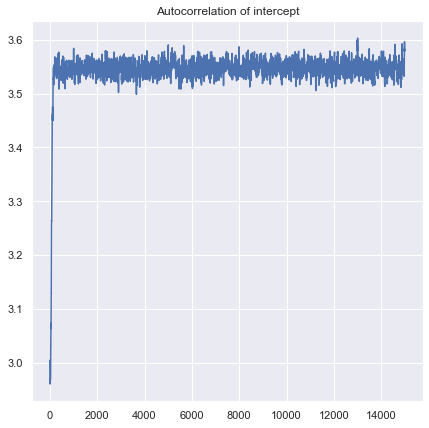

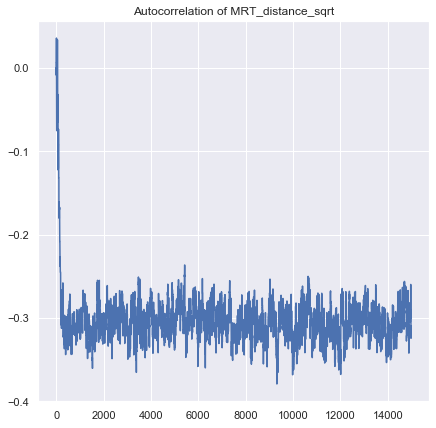

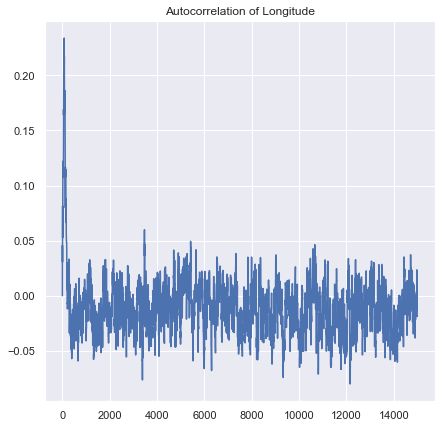

...

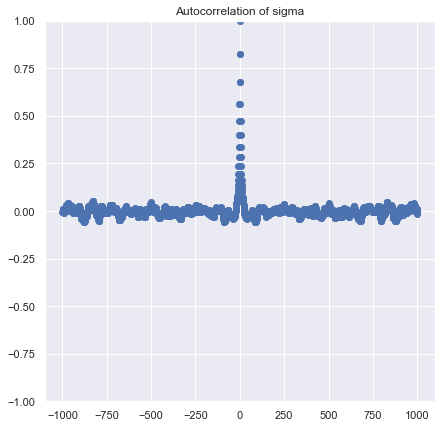

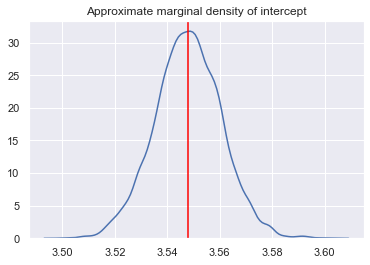

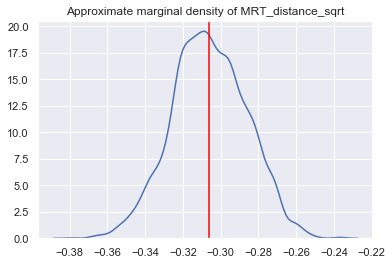

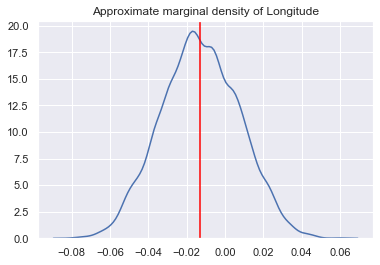

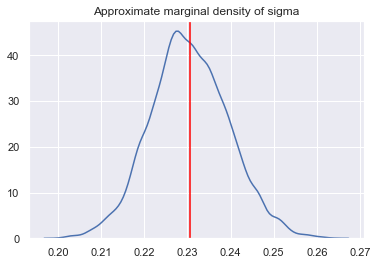

============ Fidelity summary ==================
 the mean square error is :  0.05281393181578027
 MSE test is :  65.19587591961321
 PVE is  :  0.6343598697896805
 F   is  :  282.3635953025516
 p value :  1.1102230246251565e-16
 AIC is  :  -30.896183680742922
 BIC is  :  -19.508010428446806
 AICc is :  -30.822337526896767


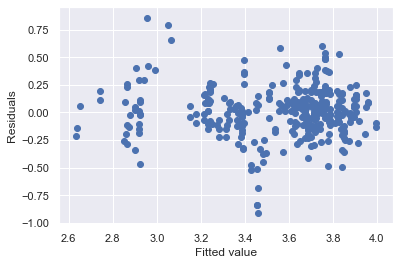

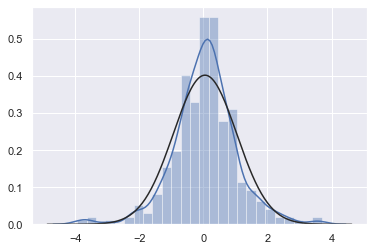

<Figure size 432x288 with 0 Axes>

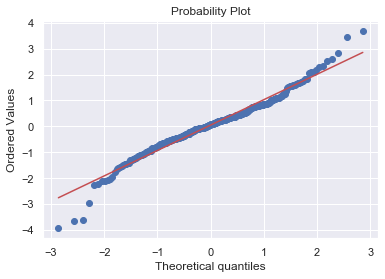

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 211.02it/s]


Acceptance rate :  0.26266666666666666
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.524, 3.574]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.22  0.02  [-0.252, -0.179] -0.25 -0.23 -0.22 -0.20   
2        dist_center  -0.10  0.02  [-0.140, -0.064] -0.14 -0.12 -0.10 -0.09   
3              sigma   0.22  0.01    [0.205, 0.240]  0.21  0.22  0.22  0.23   

   97.5  
0  3.57  
1 -0.18  
2 -0.07  
3  0.24  


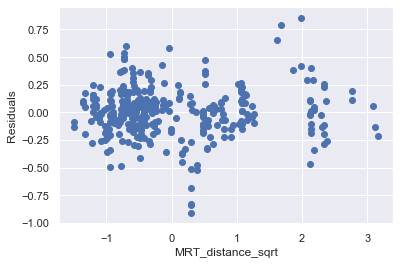

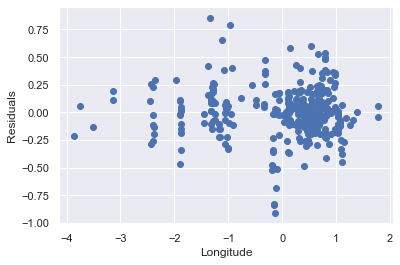

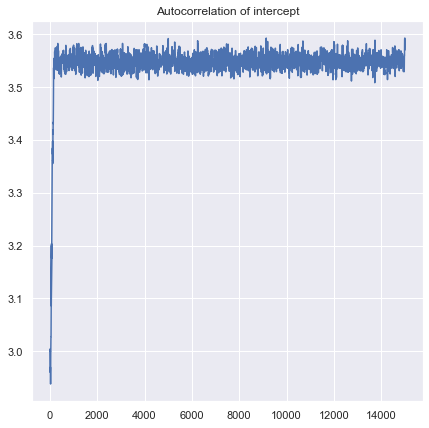

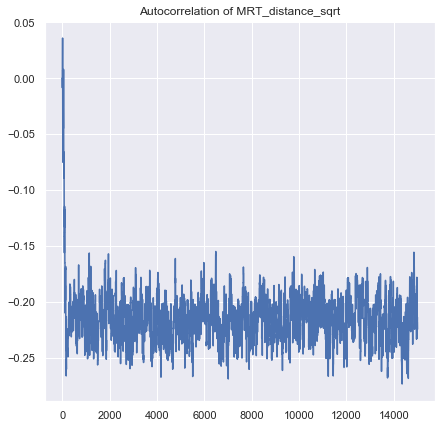

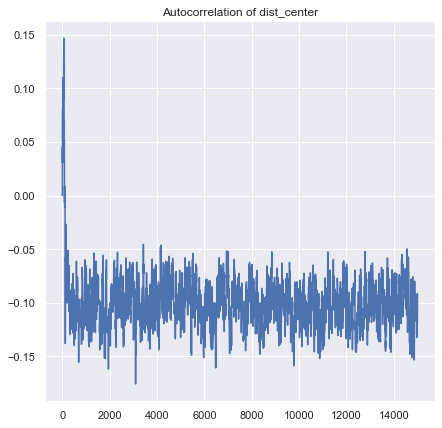

...

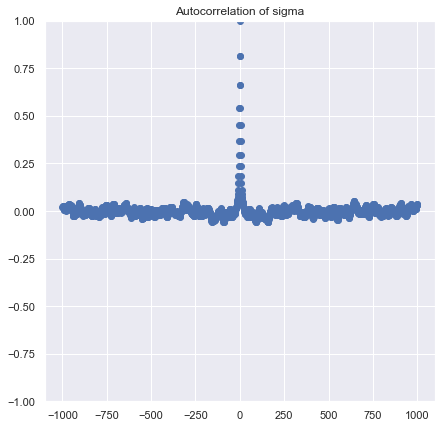

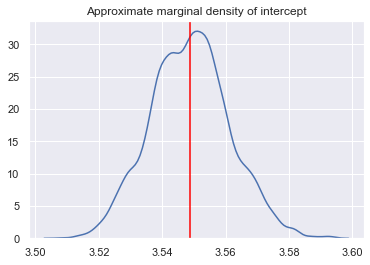

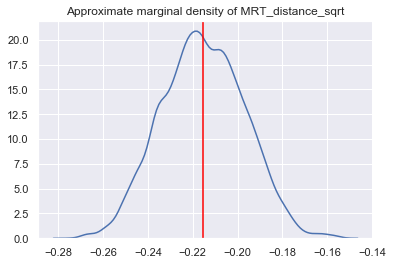

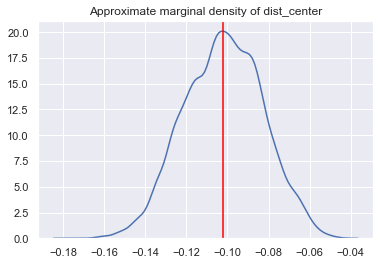

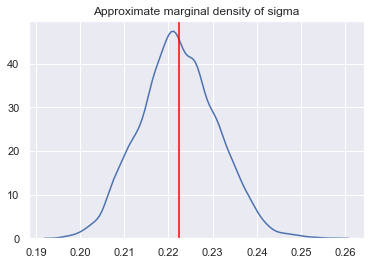

============ Fidelity summary ==================
 the mean square error is :  0.049049392201545326
 MSE test is :  64.69915668823428
 PVE is  :  0.6591395136150485
 F   is  :  315.91134258287747
 p value :  1.1102230246251565e-16
 AIC is  :  -55.218879942447515
 BIC is  :  -43.8307066901514
 AICc is :  -55.14503378860136


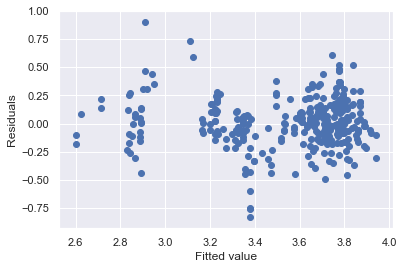

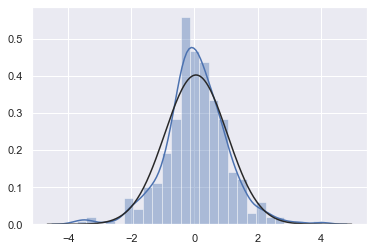

<Figure size 432x288 with 0 Axes>

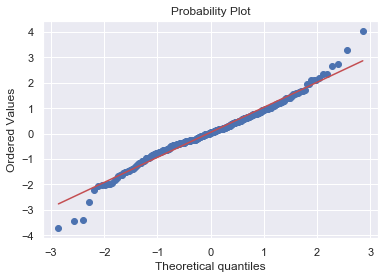

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 211.50it/s]


Acceptance rate :  0.266
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.523, 3.574]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.29  0.01  [-0.320, -0.260] -0.32 -0.30 -0.29 -0.28   
2        orientation   0.01  0.02   [-0.021, 0.040] -0.02 -0.00  0.01  0.02   
3              sigma   0.23  0.01    [0.212, 0.248]  0.21  0.22  0.23  0.24   

   97.5  
0  3.57  
1 -0.26  
2  0.04  
3  0.25  


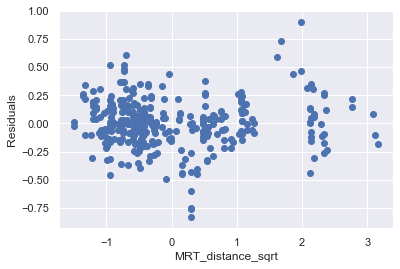

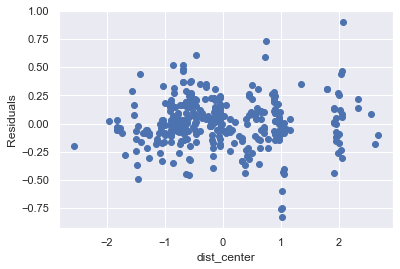

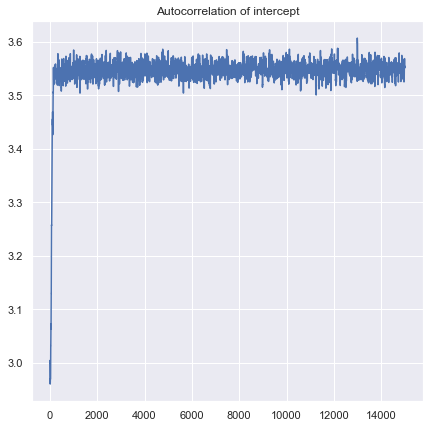

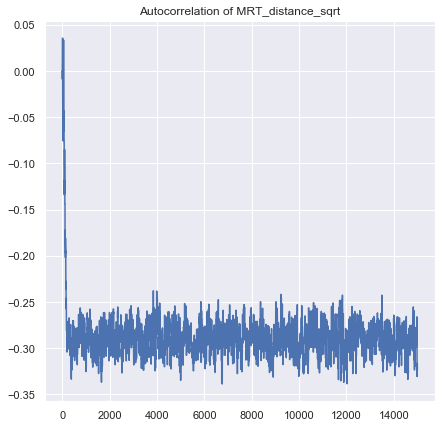

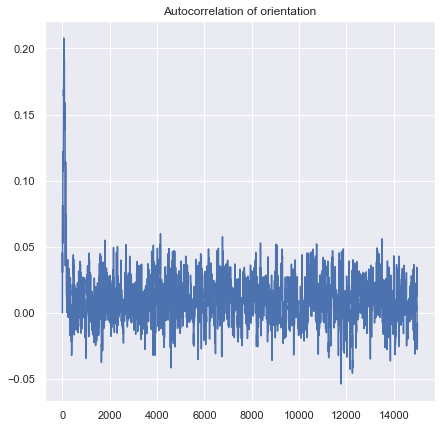

...

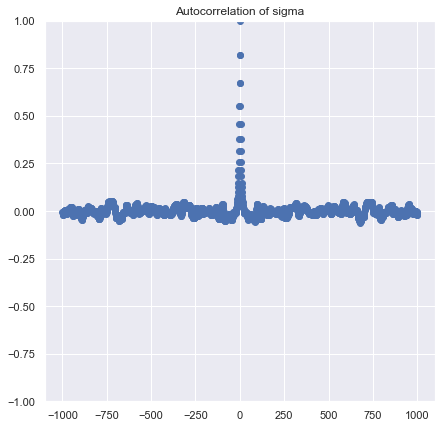

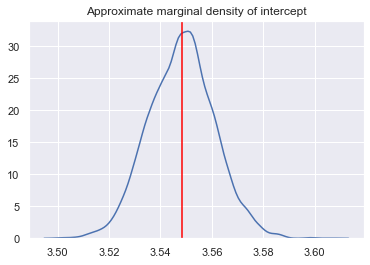

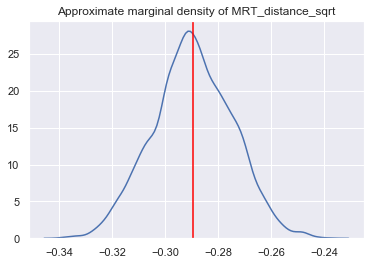

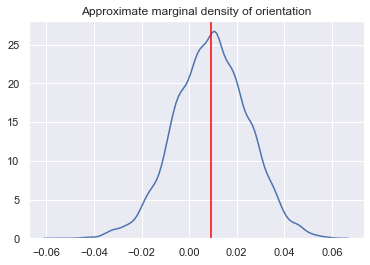

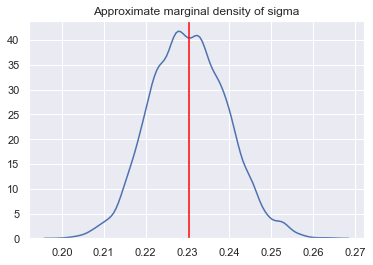

============ Fidelity summary ==================
 the mean square error is :  0.05282298518417481
 MSE test is :  63.236363598762445
 PVE is  :  0.6327856556729244
 F   is  :  281.6146133411353
 p value :  1.1102230246251565e-16
 AIC is  :  -30.85000565834944
 BIC is  :  -19.461832406053322
 AICc is :  -30.776159504503283


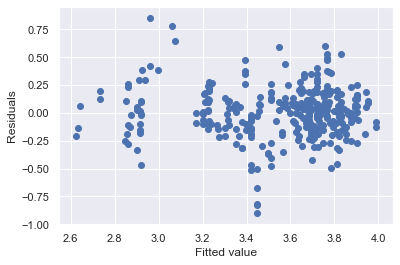

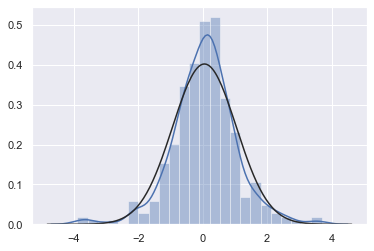

<Figure size 432x288 with 0 Axes>

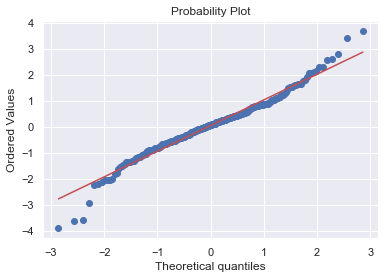

            feature  MSE_train   MSE_test       PVE           F         p_val  \
0              Date   0.049698  59.335763  0.652959  308.862443  1.110223e-16   
1         House_age   0.047937  62.476791  0.663388  325.324998  1.110223e-16   
2      MRT_distance   0.052507  63.828961  0.631177  282.587839  1.110223e-16   
3  Conv_store_count   0.050858  58.903582  0.645419  298.336169  1.110223e-16   
4          Latitude   0.046082  57.250131  0.679854  346.822527  1.110223e-16   
5         Longitude   0.052814  65.195876  0.634360  282.363595  1.110223e-16   
6       dist_center   0.049049  64.699157  0.659140  315.911343  1.110223e-16   
7       orientation   0.052823  63.236364  0.632786  281.614613  1.110223e-16   

         AIC       AICc        BIC  
0 -50.882440 -39.494267 -39.494267  
1 -62.769999 -51.381826 -51.381826  
2 -32.797764 -21.409591 -21.409591  
3 -43.309348 -31.921175 -31.921175  
4 -75.749089 -64.360916 -64.360916  
5 -30.896184 -19.508010 -19.508010  
6 -55.21888

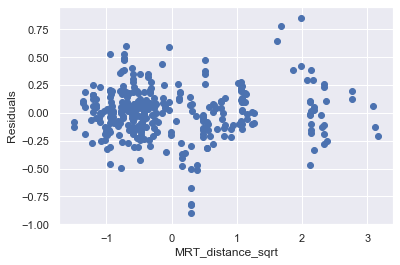

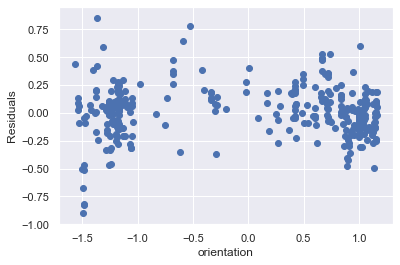

In [7]:
MSE_train = []
MSE_test = []
PVE = []
F =[]
P_val = []
AIC = []
AICc = []
BIC = []

for predictor in X_names :
    predictors = [ 'MRT_distance_sqrt' , predictor ]
    Parameter = [ 'intercept' ,'MRT_distance_sqrt' , predictor ,'sigma']
    X = (data_no_outlier[predictors].dropna()).to_numpy()
    Model = Bayesian_framework(2,Parameter,X,Y,transformation_train = False , transformation_test = True)
    proba_set = Gaussian_model_np(Model)

    # Define the model
    Model.set_log_joint_prior(proba_set.log_joint_prior)
    Model.set_log_likelihood(proba_set.log_likelihood)
    
    # define a sample algorithm :
    init = np.array( [3,0,0,0.1] )
    step_size = 0.015
    num_samples = 15000

    M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

    M_H.compute_statistic()
    
    # We see that we can select a burn in that around 200
    burn_in = 500

    M_H.compute_statistic(burn_in)
    M_H.summary()
    tool = Vizualisation_tool(Model,M_H)
    tool.trace_visualization()
    tool.autocorrelation_visualization()
    tool.marginal_visualization()
    tool.fidelity()
    tool.diagnostics()
    
    
    F_ , p_value = tool.F_test()
    
    MSE_train.append(tool.MSE())
    MSE_test.append(tool.MSE_test())
    PVE.append(tool.PVE())
    F.append(F_)
    P_val.append(p_value)
    AIC.append(tool.AIC())
    BIC.append(tool.BIC())
    AICc.append(tool.BIC())
    
table = pd.DataFrame()
table["feature"] = X_names
table["MSE_train"] = MSE_train
table["MSE_test"] = MSE_test
table["PVE"] = PVE 
table["F"] = F
table["p_val"] = P_val
table["AIC"] = AIC
table["AICc"] = AICc
table["BIC"] = BIC
print(table)

In [8]:
X_names = [ 'Date' ,'House_age','MRT_distance','Conv_store_count','Longitude','dist_center','orientation' ]

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 210.92it/s]


Acceptance rate :  0.18666666666666668
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.524, 3.570]  3.52  3.54  3.55  3.55   
1  MRT_distance_sqrt  -0.25  0.01  [-0.281, -0.228] -0.28 -0.26 -0.25 -0.25   
2           Latitude   0.09  0.01    [0.064, 0.116]  0.06  0.08  0.09  0.10   
3               Date   0.05  0.01    [0.024, 0.070]  0.02  0.04  0.05  0.05   
4              sigma   0.21  0.01    [0.195, 0.227]  0.20  0.21  0.21  0.22   

   97.5  
0  3.57  
1 -0.23  
2  0.11  
3  0.07  
4  0.23  


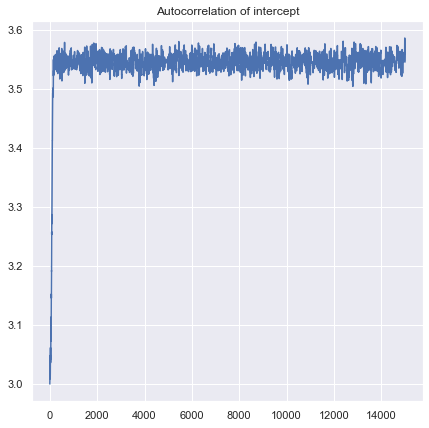

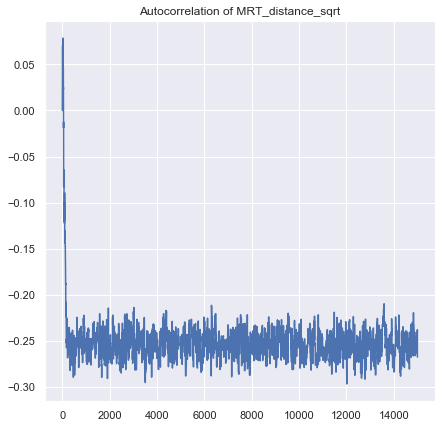

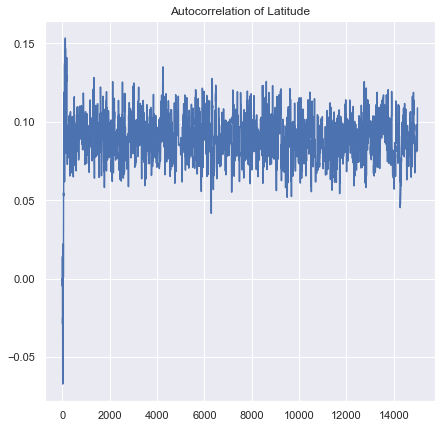

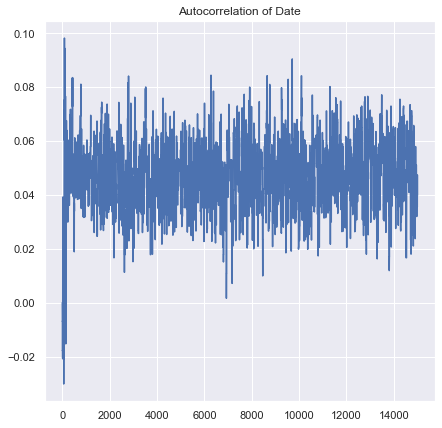

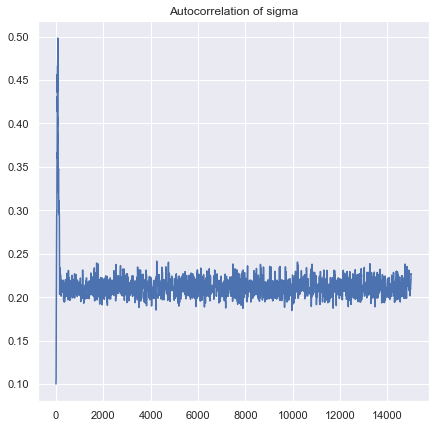

...

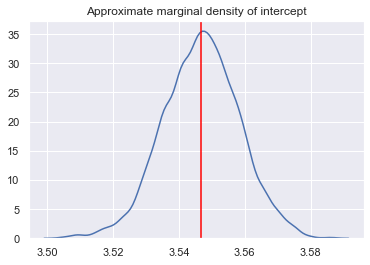

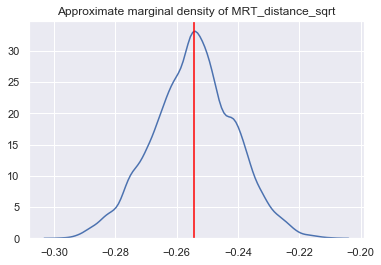

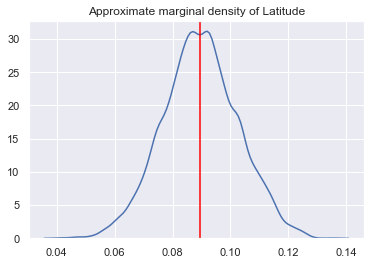

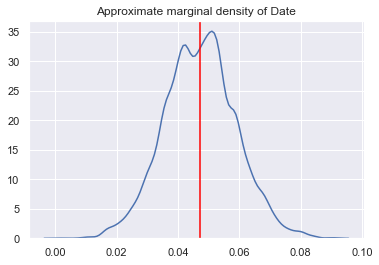

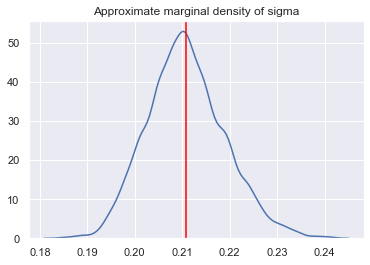

============ Fidelity summary ==================
 the mean square error is :  0.04397045232445904
 MSE test is :  53.74196209938869
 PVE is  :  0.6920479738402606
 F   is  :  246.6638531676644
 p value :  1.1102230246251565e-16
 AIC is  :  -90.14844842628696
 BIC is  :  -74.96421742322548
 AICc is :  -90.0249916361635


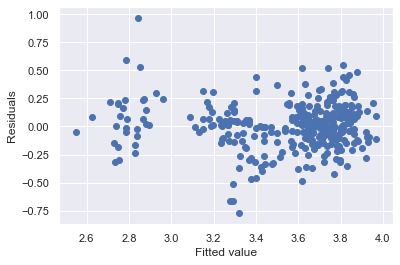

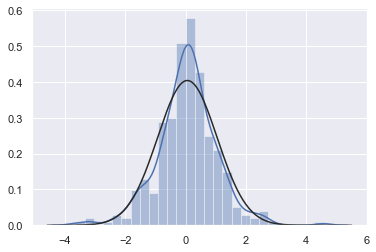

<Figure size 432x288 with 0 Axes>

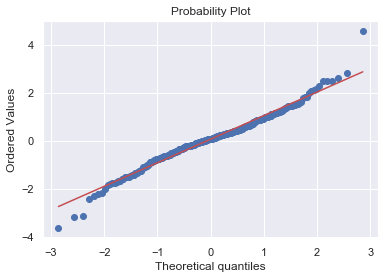

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.18it/s]


Acceptance rate :  0.1684
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.524, 3.570]  3.52  3.54  3.55  3.56   
1  MRT_distance_sqrt  -0.24  0.01  [-0.266, -0.213] -0.27 -0.25 -0.24 -0.23   
2           Latitude   0.10  0.01    [0.075, 0.127]  0.07  0.09  0.10  0.11   
3          House_age  -0.07  0.01  [-0.095, -0.052] -0.09 -0.08 -0.07 -0.07   
4              sigma   0.20  0.01    [0.187, 0.219]  0.19  0.20  0.20  0.21   

   97.5  
0  3.57  
1 -0.21  
2  0.13  
3 -0.05  
4  0.22  


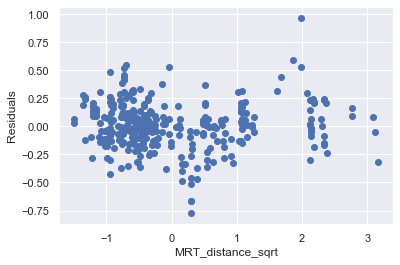

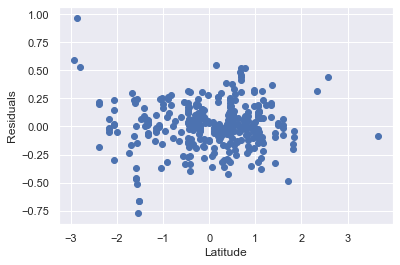

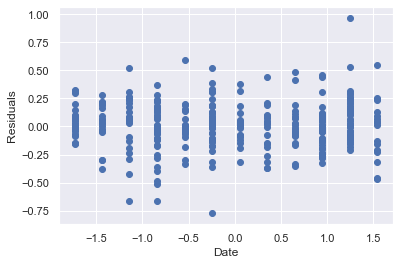

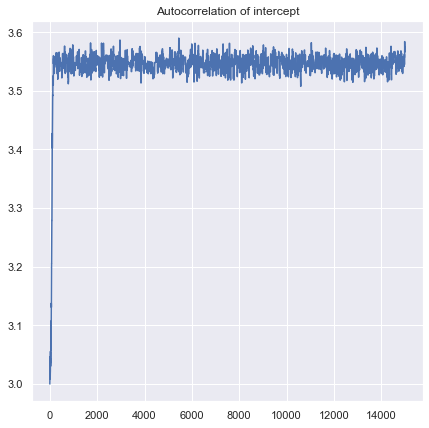

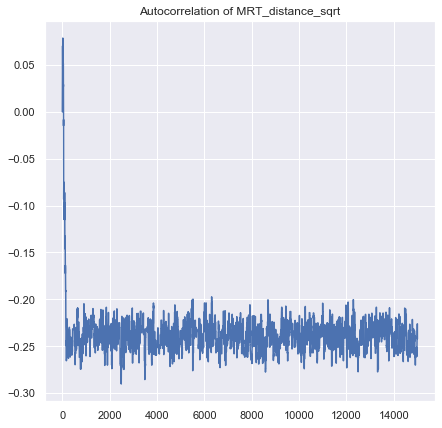

...

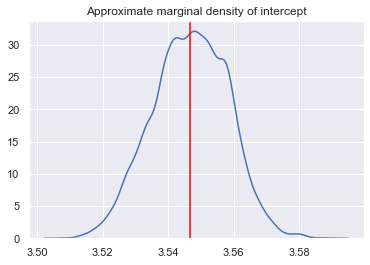

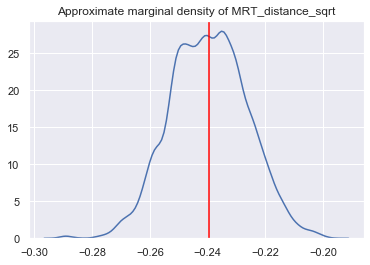

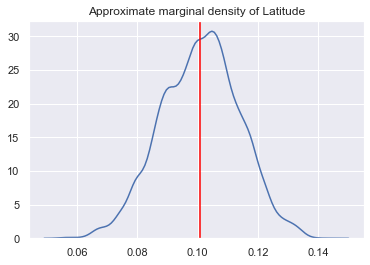

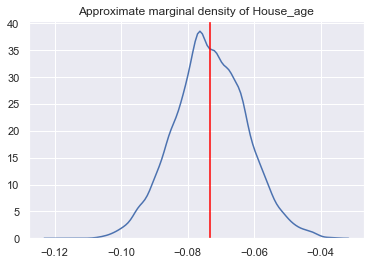

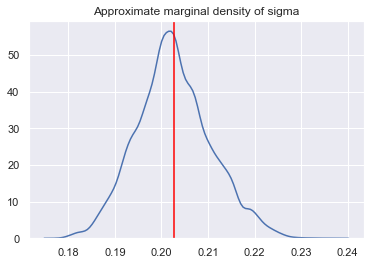

============ Fidelity summary ==================
 the mean square error is :  0.04046309367568829
 MSE test is :  53.12129419092702
 PVE is  :  0.7192524369720444
 F   is  :  278.58164642919934
 p value :  1.1102230246251565e-16
 AIC is  :  -117.46715043899106
 BIC is  :  -102.28291943592957
 AICc is :  -117.3436936488676


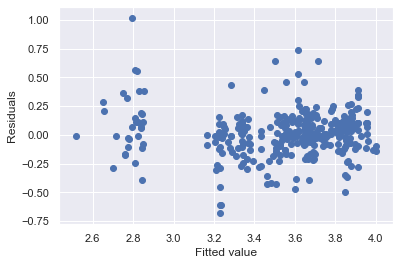

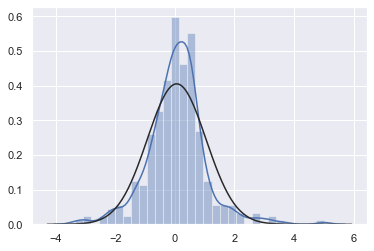

<Figure size 432x288 with 0 Axes>

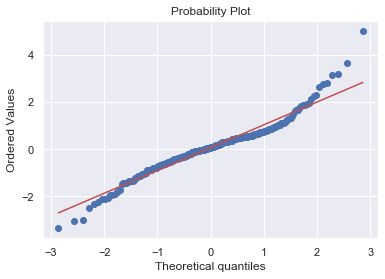

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.04it/s]


Acceptance rate :  0.20153333333333334
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.522, 3.569]  3.52  3.54  3.55  3.55   
1  MRT_distance_sqrt  -0.36  0.05  [-0.468, -0.257] -0.46 -0.40 -0.36 -0.33   
2           Latitude   0.10  0.01    [0.077, 0.130]  0.08  0.09  0.10  0.11   
3       MRT_distance   0.12  0.05    [0.015, 0.234]  0.02  0.09  0.12  0.16   
4              sigma   0.21  0.01    [0.196, 0.229]  0.20  0.21  0.21  0.22   

   97.5  
0  3.57  
1 -0.26  
2  0.13  
3  0.23  
4  0.23  


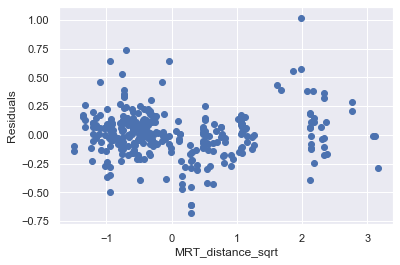

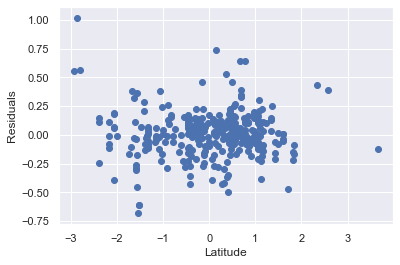

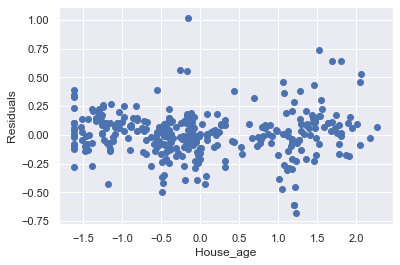

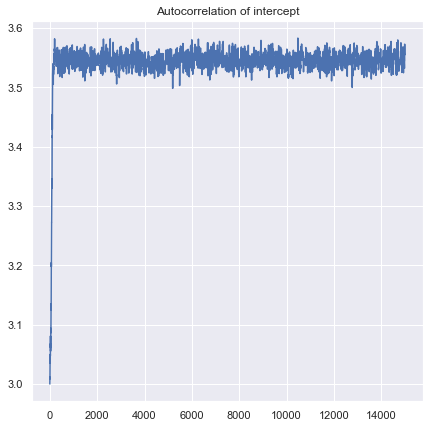

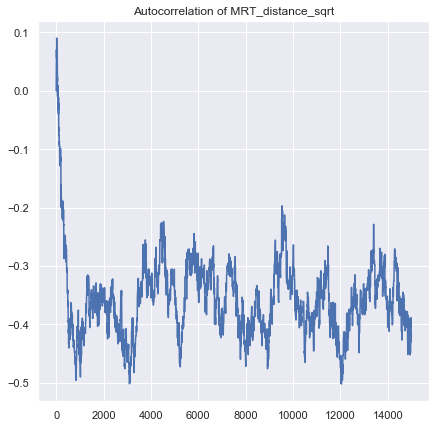

...

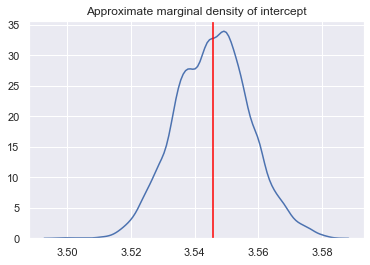

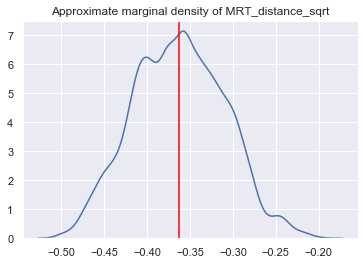

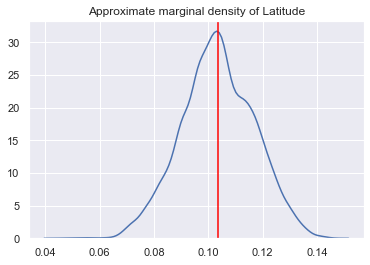

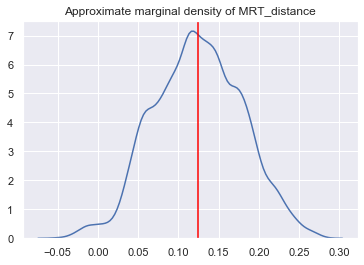

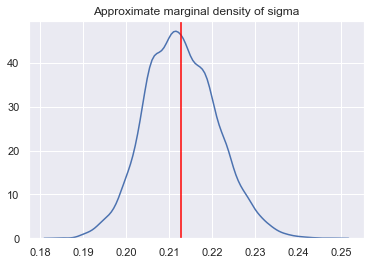

============ Fidelity summary ==================
 the mean square error is :  0.04479148164872644
 MSE test is :  55.791289958817245
 PVE is  :  0.6825263786736276
 F   is  :  238.81096054168444
 p value :  1.1102230246251565e-16
 AIC is  :  -84.06236039076344
 BIC is  :  -68.87812938770196
 AICc is :  -83.93890360063999


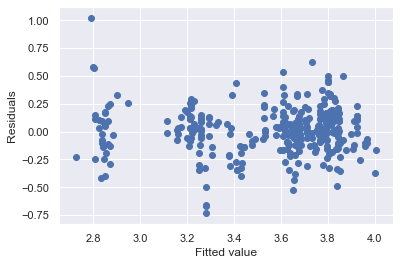

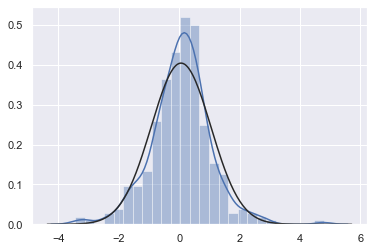

<Figure size 432x288 with 0 Axes>

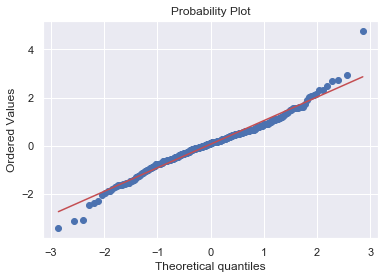

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 209.24it/s]


Acceptance rate :  0.19346666666666668
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.522, 3.569]  3.52  3.54  3.55  3.55   
1  MRT_distance_sqrt  -0.22  0.02  [-0.251, -0.183] -0.25 -0.23 -0.22 -0.21   
2           Latitude   0.09  0.01    [0.063, 0.118]  0.06  0.08  0.09  0.10   
3   Conv_store_count   0.05  0.01    [0.018, 0.077]  0.02  0.04  0.05  0.06   
4              sigma   0.21  0.01    [0.197, 0.230]  0.20  0.21  0.21  0.22   

   97.5  
0  3.57  
1 -0.18  
2  0.12  
3  0.08  
4  0.23  


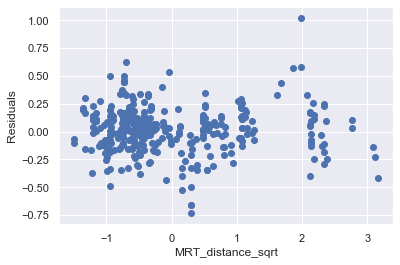

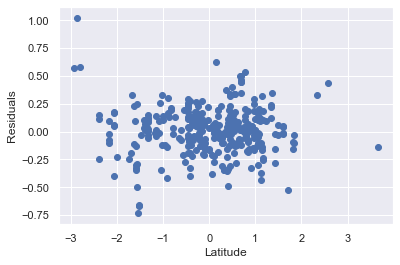

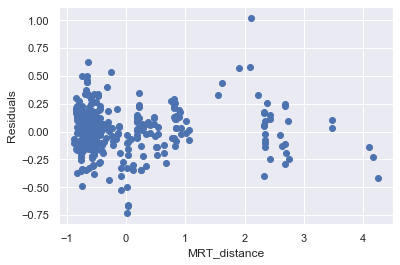

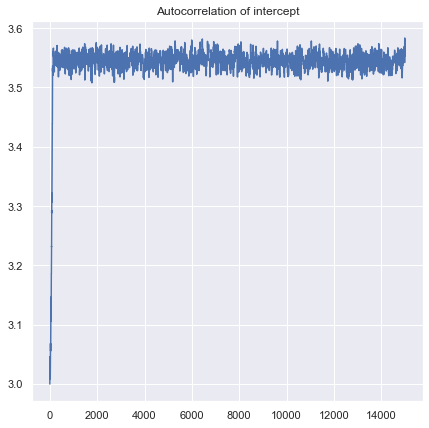

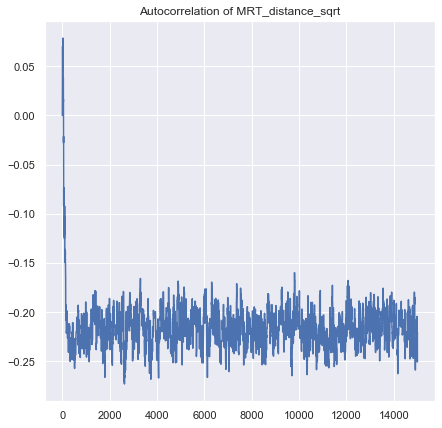

...

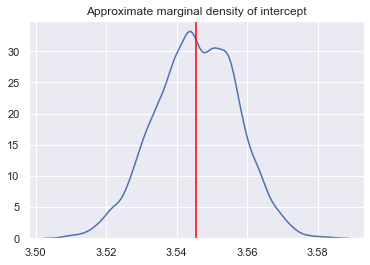

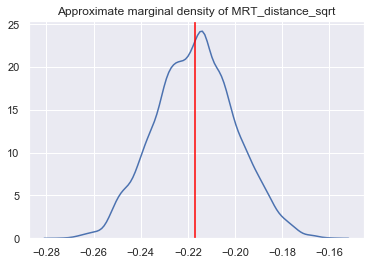

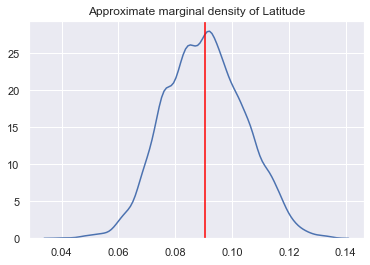

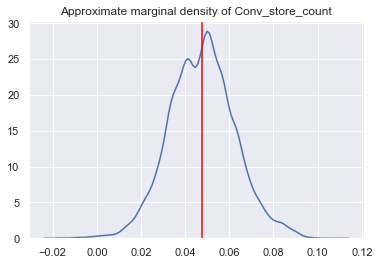

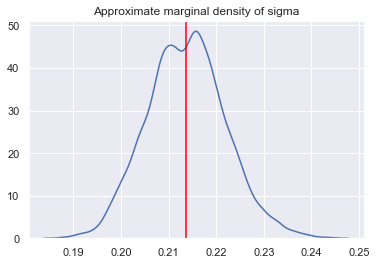

============ Fidelity summary ==================
 the mean square error is :  0.04505824338709704
 MSE test is :  54.85393404142648
 PVE is  :  0.6847054703771175
 F   is  :  238.1550440676771
 p value :  1.1102230246251565e-16
 AIC is  :  -82.08638920191078
 BIC is  :  -66.90215819884929
 AICc is :  -81.96293241178732


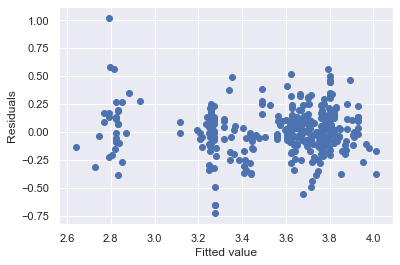

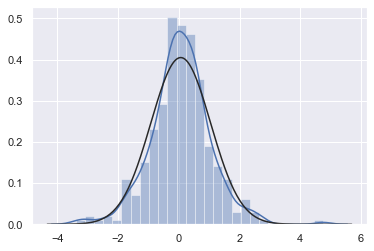

<Figure size 432x288 with 0 Axes>

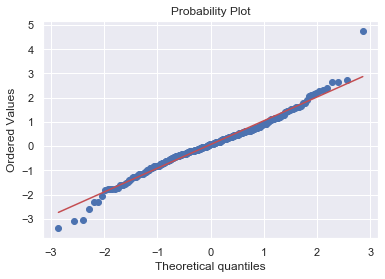

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 213.72it/s]


Acceptance rate :  0.2056
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.521, 3.569]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.26  0.02  [-0.299, -0.212] -0.30 -0.27 -0.26 -0.24   
2           Latitude   0.09  0.01    [0.067, 0.122]  0.07  0.09  0.09  0.10   
3          Longitude  -0.01  0.02   [-0.052, 0.029] -0.05 -0.03 -0.01  0.00   
4              sigma   0.22  0.01    [0.199, 0.234]  0.20  0.21  0.22  0.22   

   97.5  
0  3.57  
1 -0.21  
2  0.12  
3  0.03  
4  0.23  


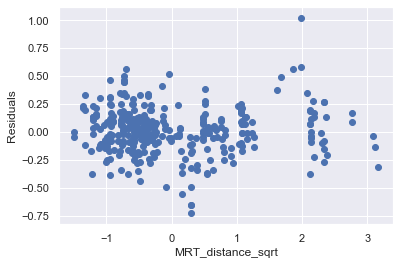

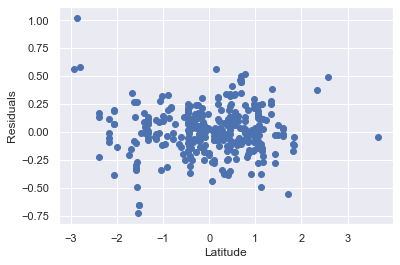

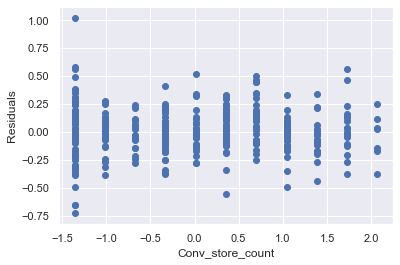

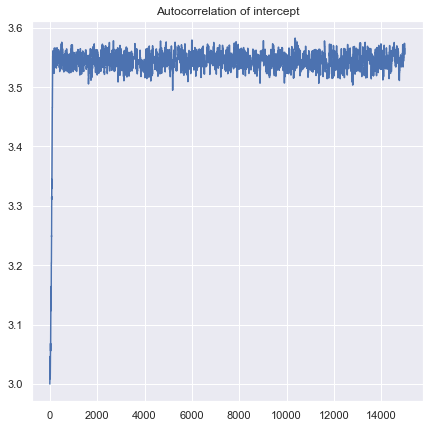

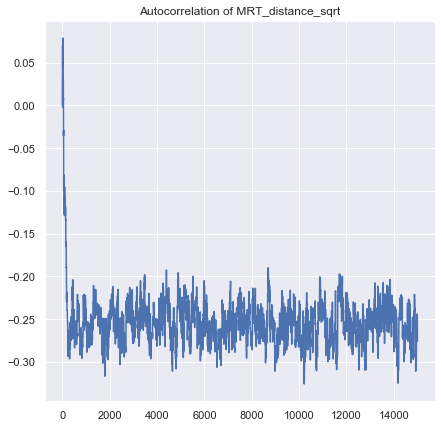

...

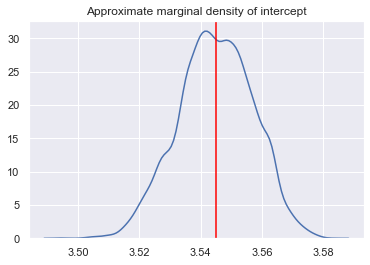

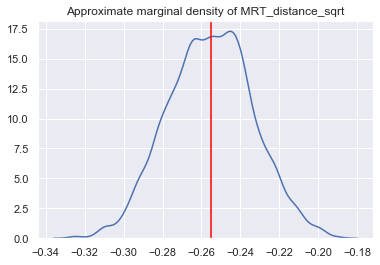

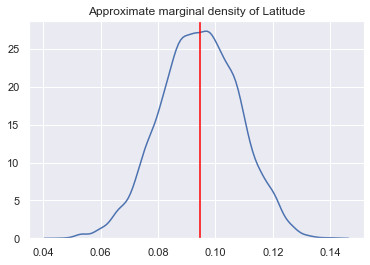

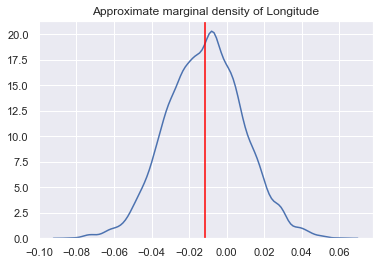

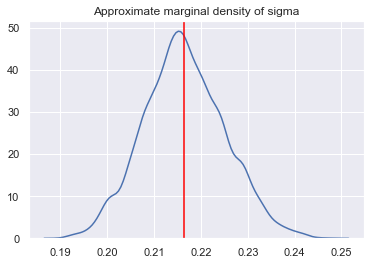

============ Fidelity summary ==================
 the mean square error is :  0.046285879320612226
 MSE test is :  59.151119243984084
 PVE is  :  0.6792711764435555
 F   is  :  229.99845092802693
 p value :  1.1102230246251565e-16
 AIC is  :  -73.25497043102456
 BIC is  :  -58.070739427963076
 AICc is :  -73.1315136409011


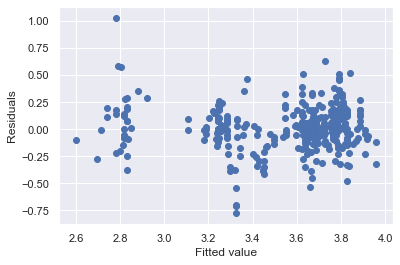

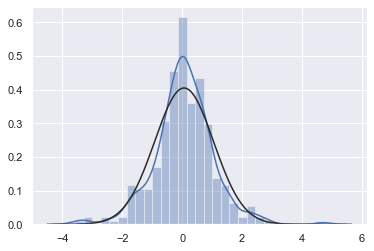

<Figure size 432x288 with 0 Axes>

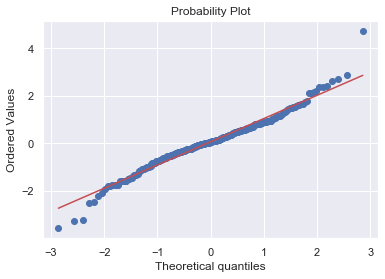

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.44it/s]


Acceptance rate :  0.20573333333333332
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.521, 3.569]  3.52  3.54  3.55  3.55   
1  MRT_distance_sqrt  -0.25  0.02  [-0.290, -0.205] -0.29 -0.26 -0.25 -0.23   
2           Latitude   0.10  0.02    [0.052, 0.141]  0.05  0.08  0.10  0.11   
3        dist_center   0.00  0.03   [-0.061, 0.068] -0.06 -0.02  0.00  0.02   
4              sigma   0.22  0.01    [0.199, 0.234]  0.20  0.21  0.22  0.22   

   97.5  
0  3.57  
1 -0.20  
2  0.14  
3  0.07  
4  0.23  


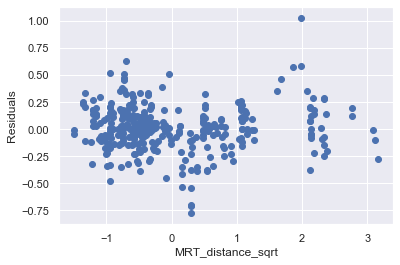

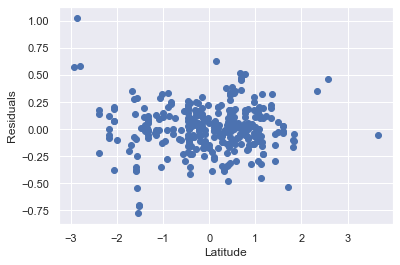

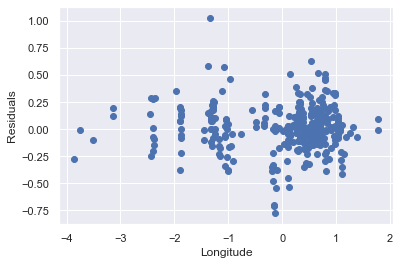

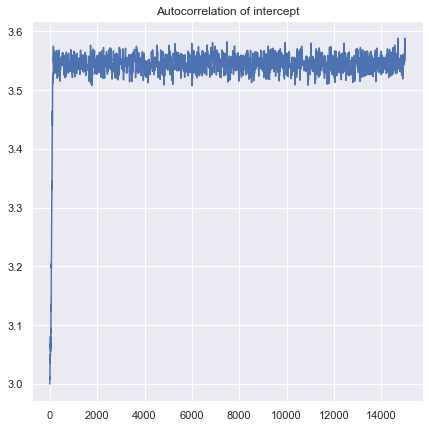

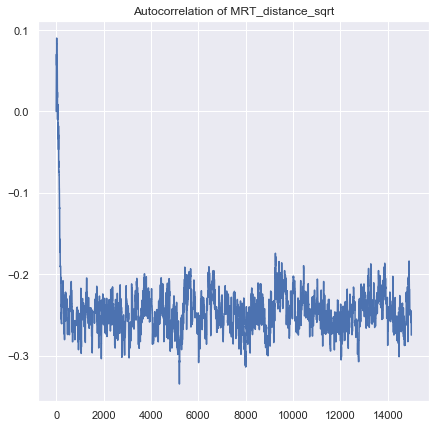

...

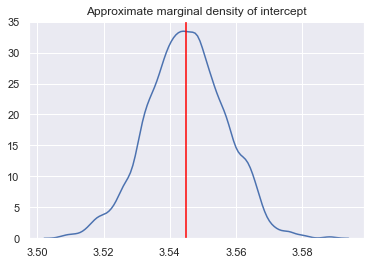

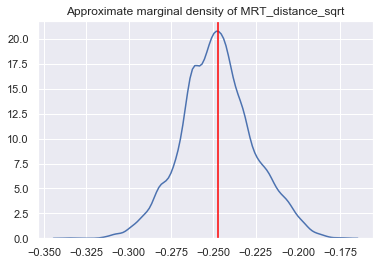

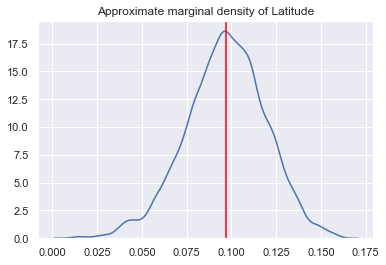

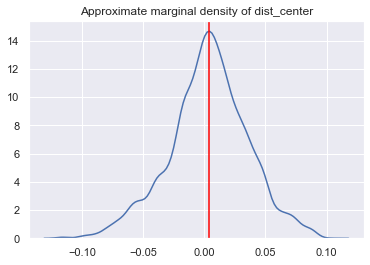

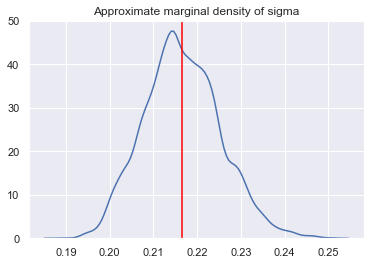

============ Fidelity summary ==================
 the mean square error is :  0.046324952762100705
 MSE test is :  58.45210313269494
 PVE is  :  0.6783193844820188
 F   is  :  229.4824544053268
 p value :  1.1102230246251565e-16
 AIC is  :  -72.97275884254317
 BIC is  :  -57.78852783948169
 AICc is :  -72.84930205241972


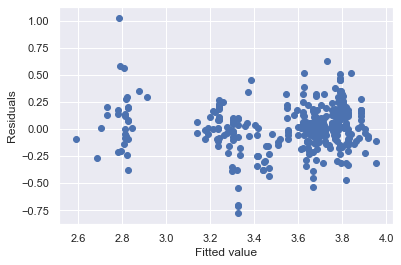

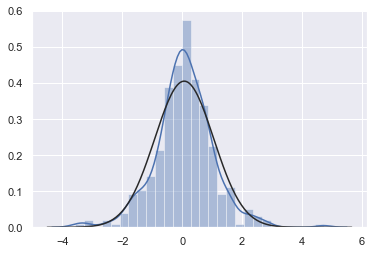

<Figure size 432x288 with 0 Axes>

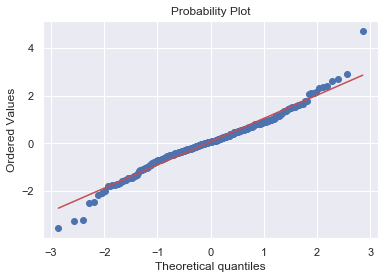

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:12<00:00, 208.23it/s]


Acceptance rate :  0.19653333333333334
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.521, 3.570]  3.52  3.54  3.55  3.55   
1  MRT_distance_sqrt  -0.23  0.02  [-0.259, -0.194] -0.26 -0.24 -0.23 -0.22   
2           Latitude   0.10  0.01    [0.072, 0.126]  0.07  0.09  0.10  0.11   
3        orientation   0.03  0.01   [-0.000, 0.057] -0.00  0.02  0.03  0.04   
4              sigma   0.22  0.01    [0.199, 0.232]  0.20  0.21  0.22  0.22   

   97.5  
0  3.57  
1 -0.19  
2  0.12  
3  0.06  
4  0.23  


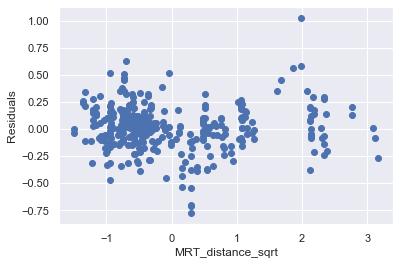

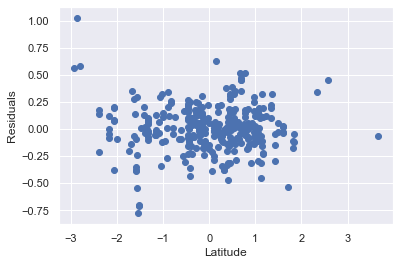

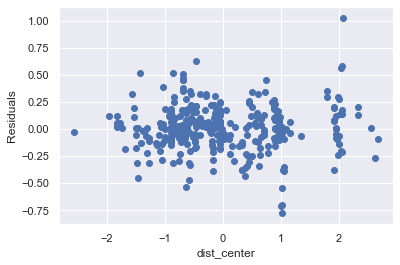

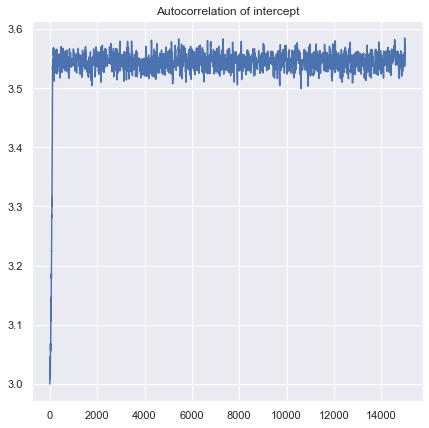

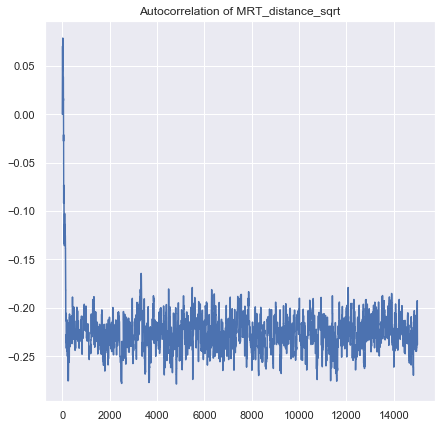

...

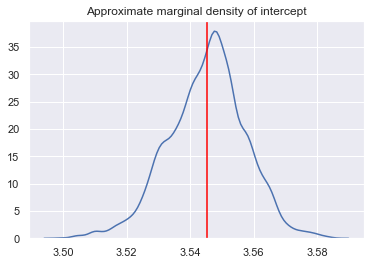

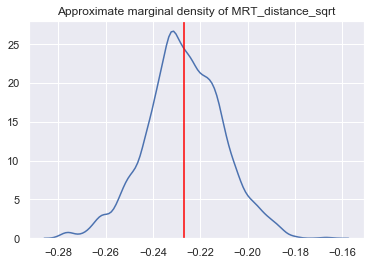

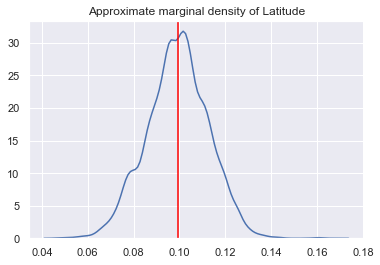

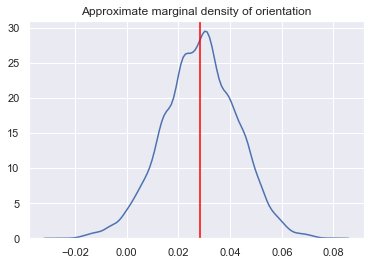

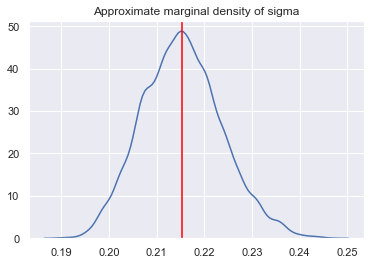

============ Fidelity summary ==================
 the mean square error is :  0.045786195800171944
 MSE test is :  54.379367308112315
 PVE is  :  0.6814629004951837
 F   is  :  233.2587260548102
 p value :  1.1102230246251565e-16
 AIC is  :  -76.82069399787464
 BIC is  :  -61.63646299481316
 AICc is :  -76.69723720775119


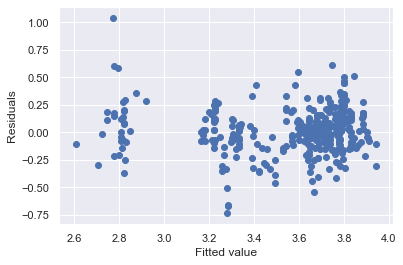

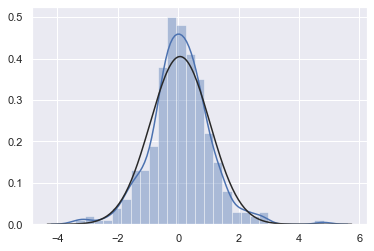

<Figure size 432x288 with 0 Axes>

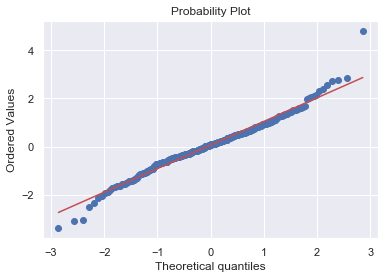

            feature  MSE_train   MSE_test       PVE           F         p_val  \
0              Date   0.043970  53.741962  0.692048  246.663853  1.110223e-16   
1         House_age   0.040463  53.121294  0.719252  278.581646  1.110223e-16   
2      MRT_distance   0.044791  55.791290  0.682526  238.810961  1.110223e-16   
3  Conv_store_count   0.045058  54.853934  0.684705  238.155044  1.110223e-16   
4         Longitude   0.046286  59.151119  0.679271  229.998451  1.110223e-16   
5       dist_center   0.046325  58.452103  0.678319  229.482454  1.110223e-16   
6       orientation   0.045786  54.379367  0.681463  233.258726  1.110223e-16   

          AIC        AICc         BIC  
0  -90.148448  -74.964217  -74.964217  
1 -117.467150 -102.282919 -102.282919  
2  -84.062360  -68.878129  -68.878129  
3  -82.086389  -66.902158  -66.902158  
4  -73.254970  -58.070739  -58.070739  
5  -72.972759  -57.788528  -57.788528  
6  -76.820694  -61.636463  -61.636463  


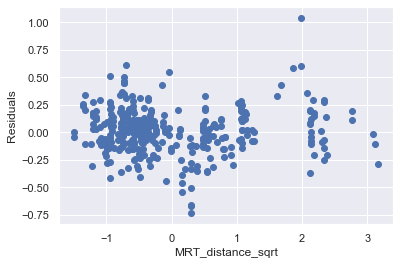

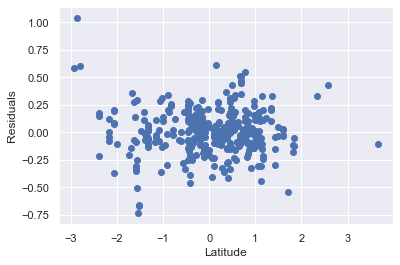

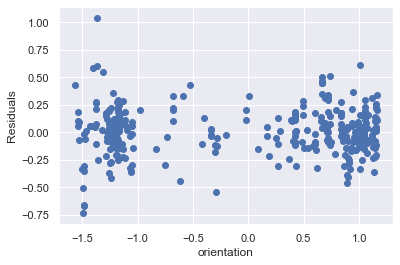

In [9]:
MSE_train = []
MSE_test = []
PVE = []
F =[]
P_val = []
AIC = []
AICc = []
BIC = []

for predictor in X_names :
    predictors = [ 'MRT_distance_sqrt' ,'Latitude' , predictor ]
    Parameter = [ 'intercept' ,'MRT_distance_sqrt' , 'Latitude', predictor ,'sigma']
    X = (data_no_outlier[predictors].dropna()).to_numpy()
    Model = Bayesian_framework(3,Parameter,X,Y,transformation_train = False , transformation_test = True)
    proba_set = Gaussian_model_np(Model)

    # Define the model
    Model.set_log_joint_prior(proba_set.log_joint_prior)
    Model.set_log_likelihood(proba_set.log_likelihood)
    
    # define a sample algorithm :
    init = np.array( [3,0,0,0,0.1] )
    step_size = 0.015
    num_samples = 15000

    M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

    M_H.compute_statistic()
    
    # We see that we can select a burn in that around 200
    burn_in = 500

    M_H.compute_statistic(burn_in)
    M_H.summary()
    tool = Vizualisation_tool(Model,M_H)
    tool.trace_visualization()
    tool.autocorrelation_visualization()
    tool.marginal_visualization()
    tool.fidelity()
    tool.diagnostics()
    
    
    F_ , p_value = tool.F_test()
    
    MSE_train.append(tool.MSE())
    MSE_test.append(tool.MSE_test())
    PVE.append(tool.PVE())
    F.append(F_)
    P_val.append(p_value)
    AIC.append(tool.AIC())
    BIC.append(tool.BIC())
    AICc.append(tool.BIC())
    
table = pd.DataFrame()
table["feature"] = X_names
table["MSE_train"] = MSE_train
table["MSE_test"] = MSE_test
table["PVE"] = PVE 
table["F"] = F
table["p_val"] = P_val
table["AIC"] = AIC
table["AICc"] = AICc
table["BIC"] = BIC
print(table)

In [4]:
X_names = [ 'Date' , 'Conv_store_count','MRT_distance','Longitude','dist_center','orientation' ]

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:08<00:00, 220.30it/s]


Acceptance rate :  0.19593333333333332
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.55  0.01    [3.524, 3.566]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.25  0.01  [-0.273, -0.223] -0.27 -0.26 -0.25 -0.24   
2           Latitude   0.10  0.01    [0.070, 0.122]  0.07  0.09  0.10  0.10   
3          House_age  -0.07  0.01  [-0.094, -0.052] -0.09 -0.08 -0.07 -0.07   
4               Date   0.05  0.01    [0.027, 0.071]  0.03  0.04  0.05  0.06   
5              sigma   0.20  0.01    [0.181, 0.212]  0.18  0.19  0.20  0.20   

   97.5  
0  3.57  
1 -0.22  
2  0.12  
3 -0.05  
4  0.07  
5  0.21  


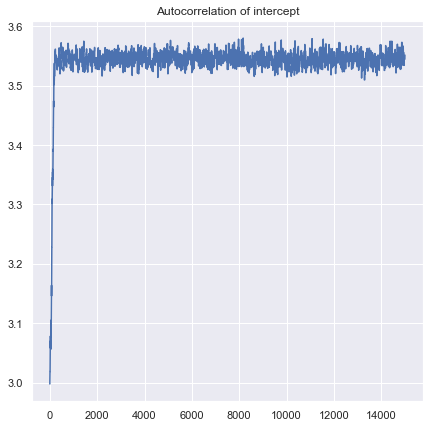

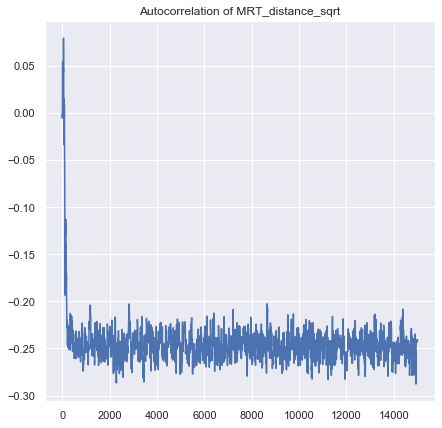

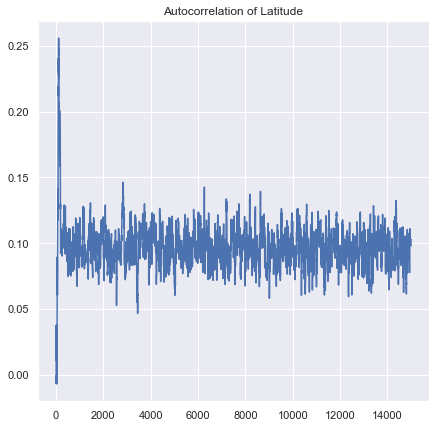

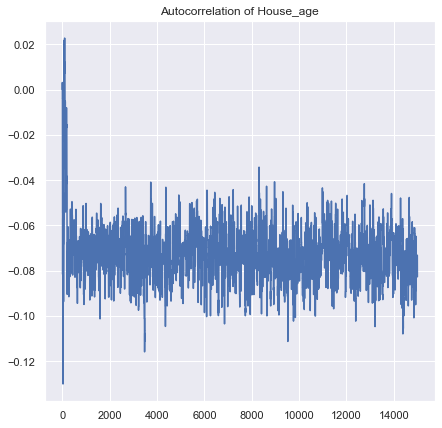

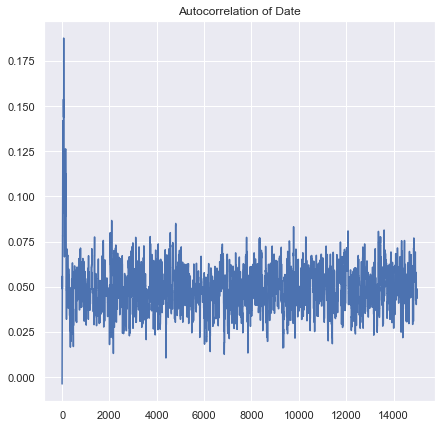

...

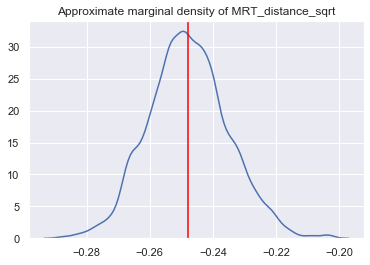

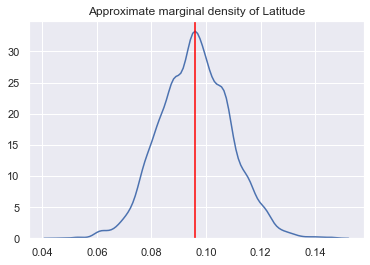

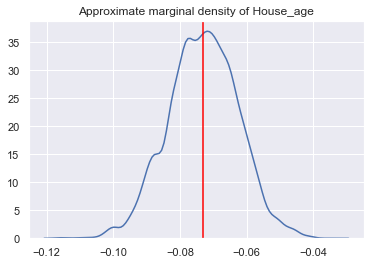

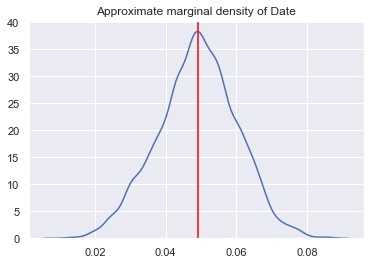

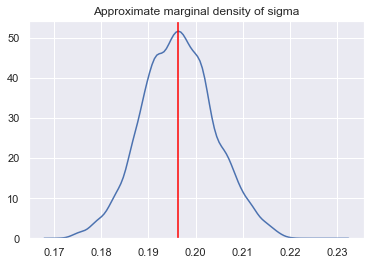

============ Fidelity summary ==================
 the mean square error is :  0.03826941942233456
 MSE test is :  49.81173102034087
 PVE is  :  0.7319567814608087
 F   is  :  224.81488974850947
 p value :  1.1102230246251565e-16
 AIC is  :  -134.85295563894192
 BIC is  :  -115.87266688511507
 AICc is :  -134.66719712501003


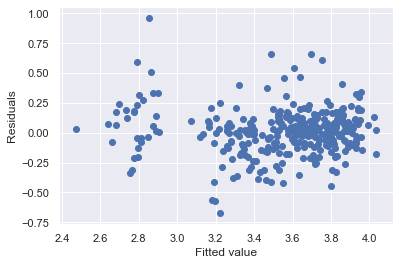

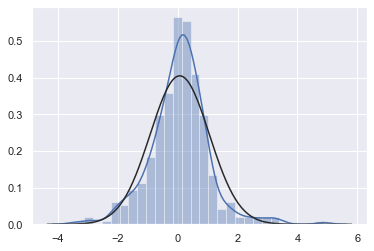

<Figure size 432x288 with 0 Axes>

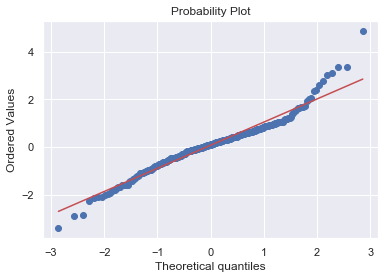

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.52it/s]


Acceptance rate :  0.20726666666666665
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.522, 3.567]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.21  0.02  [-0.238, -0.173] -0.24 -0.22 -0.20 -0.19   
2           Latitude   0.10  0.01    [0.070, 0.122]  0.07  0.09  0.10  0.10   
3          House_age  -0.08  0.01  [-0.098, -0.055] -0.10 -0.08 -0.08 -0.07   
4   Conv_store_count   0.06  0.01    [0.027, 0.087]  0.03  0.05  0.06  0.07   
5              sigma   0.20  0.01    [0.182, 0.214]  0.18  0.19  0.20  0.20   

   97.5  
0  3.57  
1 -0.17  
2  0.12  
3 -0.05  
4  0.09  
5  0.21  


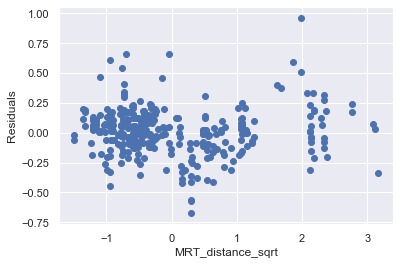

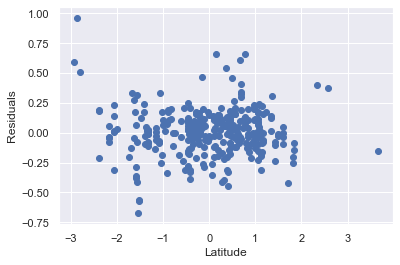

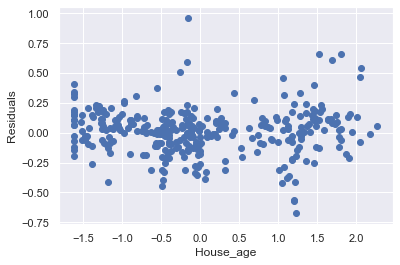

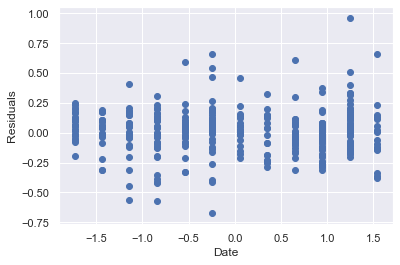

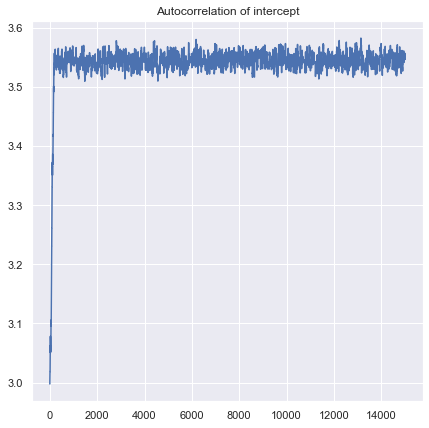

...

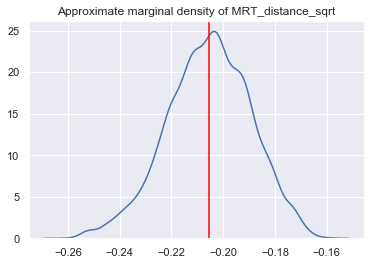

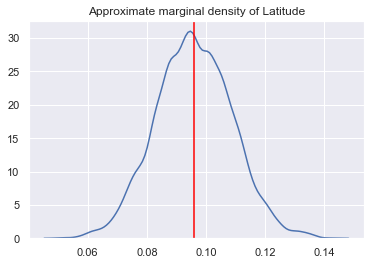

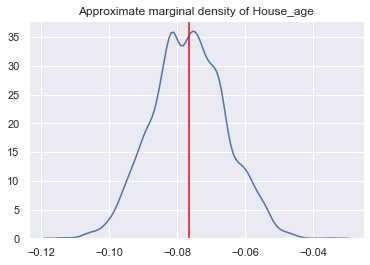

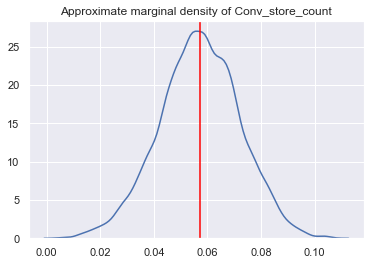

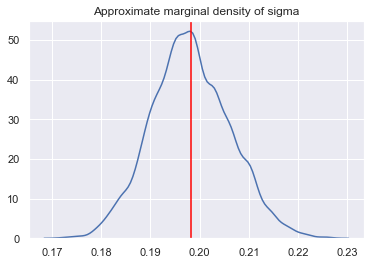

============ Fidelity summary ==================
 the mean square error is :  0.03885589317427063
 MSE test is :  48.91457743854288
 PVE is  :  0.7324655778511623
 F   is  :  221.57554691835432
 p value :  1.1102230246251565e-16
 AIC is  :  -129.8234401369314
 BIC is  :  -110.84315138310454
 AICc is :  -129.6376816229995


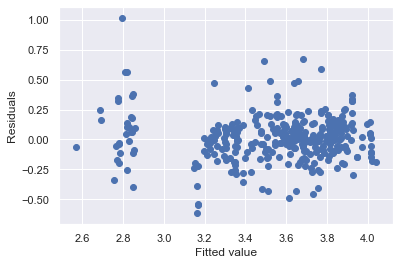

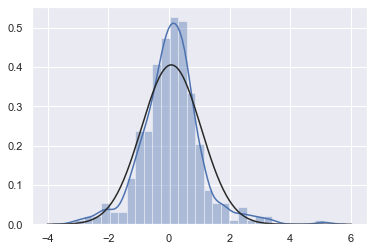

<Figure size 432x288 with 0 Axes>

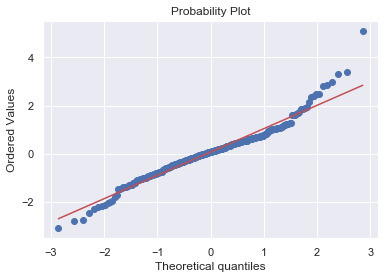

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.54it/s]


Acceptance rate :  0.21193333333333333
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.523, 3.566]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.36  0.04  [-0.449, -0.274] -0.44 -0.39 -0.36 -0.33   
2           Latitude   0.11  0.01    [0.086, 0.137]  0.09  0.10  0.11  0.12   
3          House_age  -0.07  0.01  [-0.094, -0.052] -0.09 -0.08 -0.07 -0.07   
4       MRT_distance   0.13  0.04    [0.043, 0.219]  0.05  0.10  0.13  0.16   
5              sigma   0.20  0.01    [0.183, 0.215]  0.18  0.19  0.20  0.20   

   97.5  
0  3.57  
1 -0.28  
2  0.14  
3 -0.05  
4  0.21  
5  0.21  


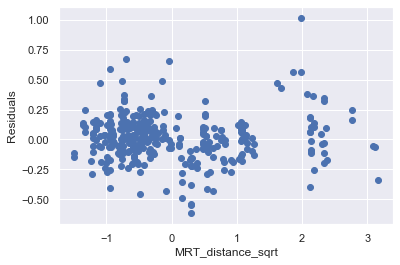

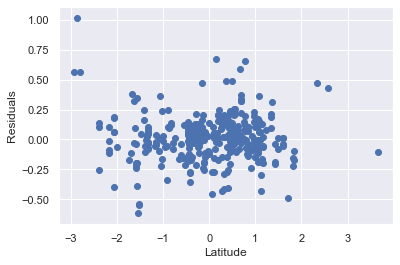

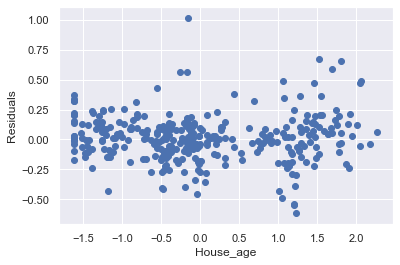

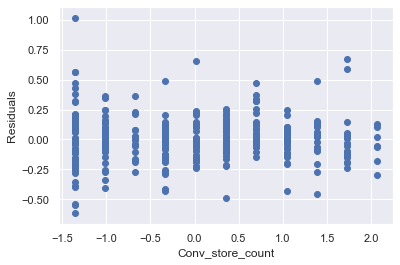

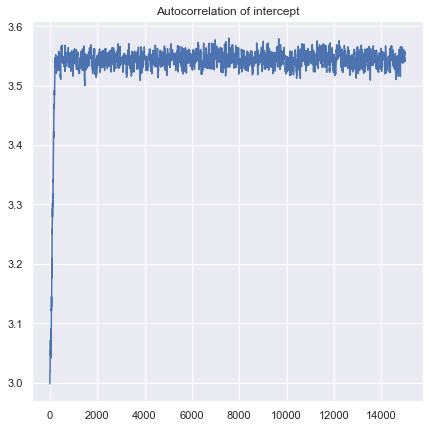

...

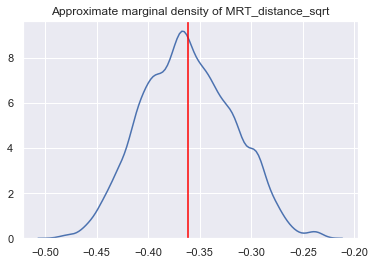

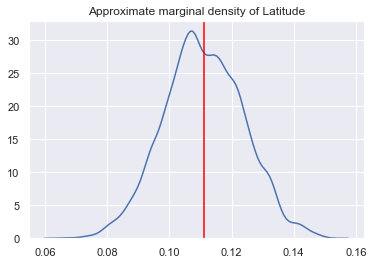

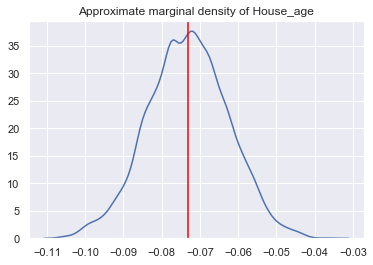

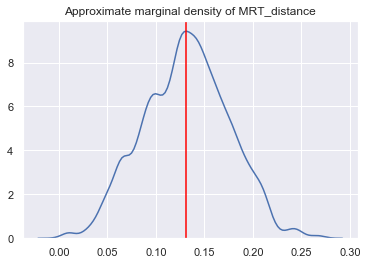

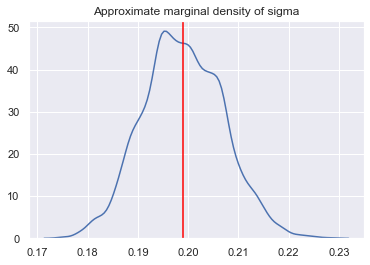

============ Fidelity summary ==================
 the mean square error is :  0.039139693027344
 MSE test is :  51.32327628588022
 PVE is  :  0.7220609173085727
 F   is  :  216.844259769389
 p value :  1.1102230246251565e-16
 AIC is  :  -127.4214810434369
 BIC is  :  -108.44119228961004
 AICc is :  -127.23572252950501


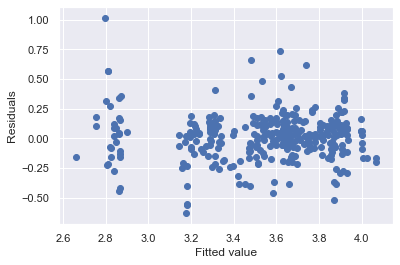

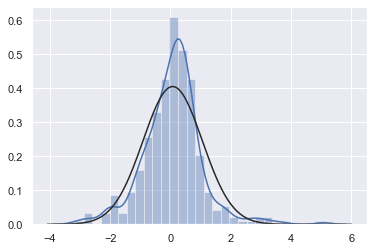

<Figure size 432x288 with 0 Axes>

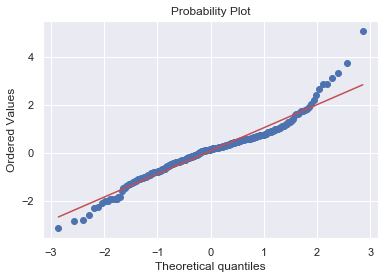

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:08<00:00, 220.36it/s]


Acceptance rate :  0.215
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.521, 3.566]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.25  0.02  [-0.283, -0.208] -0.28 -0.26 -0.25 -0.23   
2           Latitude   0.10  0.01    [0.076, 0.126]  0.08  0.09  0.10  0.11   
3          House_age  -0.07  0.01  [-0.094, -0.052] -0.09 -0.08 -0.07 -0.07   
4          Longitude  -0.01  0.02   [-0.045, 0.030] -0.05 -0.02 -0.01  0.01   
5              sigma   0.20  0.01    [0.186, 0.219]  0.19  0.20  0.20  0.21   

   97.5  
0  3.57  
1 -0.21  
2  0.13  
3 -0.05  
4  0.03  
5  0.22  


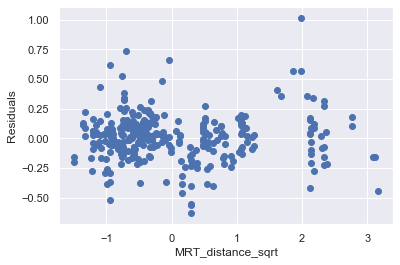

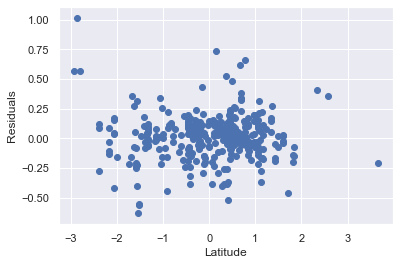

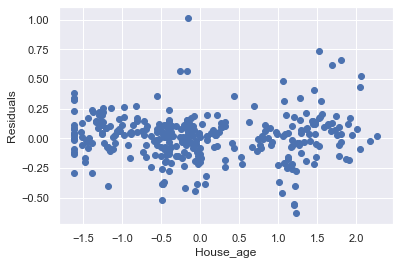

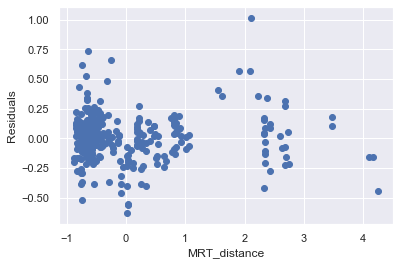

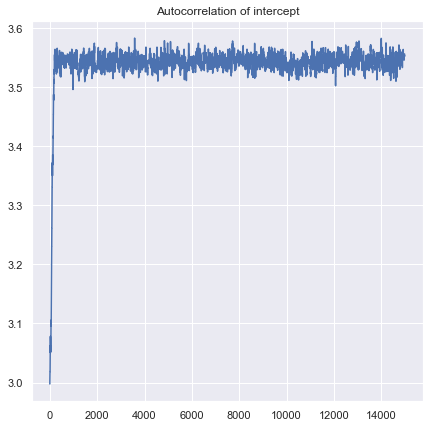

...

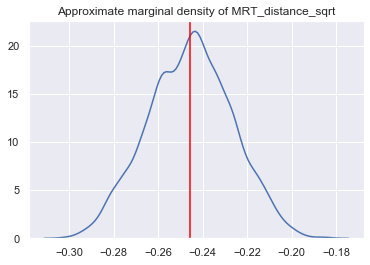

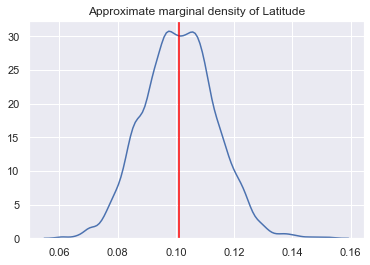

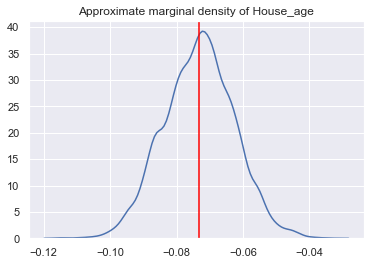

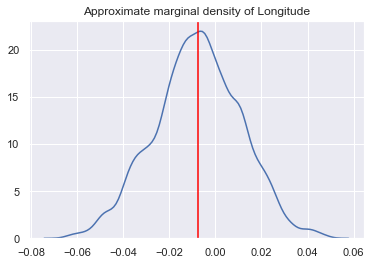

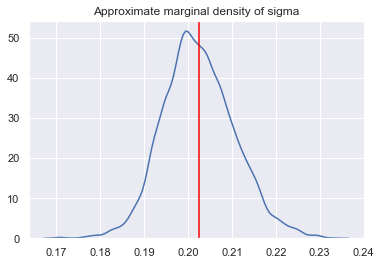

============ Fidelity summary ==================
 the mean square error is :  0.04063272951906463
 MSE test is :  54.32041760100632
 PVE is  :  0.7199447336876933
 F   is  :  208.26422213454677
 p value :  1.1102230246251565e-16
 AIC is  :  -115.12400323241087
 BIC is  :  -96.14371447858402
 AICc is :  -114.93824471847898


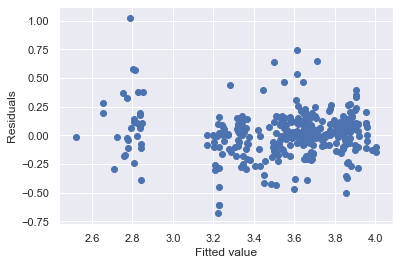

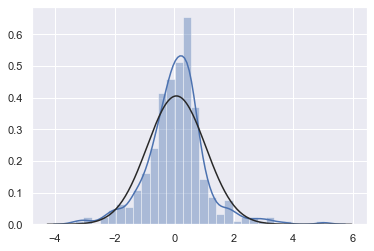

<Figure size 432x288 with 0 Axes>

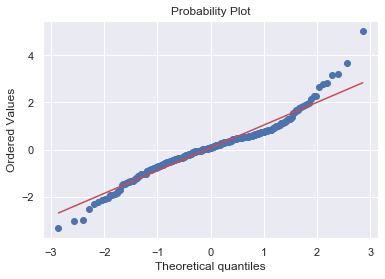

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 211.87it/s]


Acceptance rate :  0.22673333333333334
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.522, 3.566]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.21  0.02  [-0.255, -0.174] -0.25 -0.23 -0.21 -0.20   
2           Latitude   0.08  0.02    [0.034, 0.119]  0.04  0.06  0.08  0.09   
3          House_age  -0.08  0.01  [-0.100, -0.056] -0.10 -0.08 -0.08 -0.07   
4        dist_center  -0.05  0.03   [-0.108, 0.013] -0.11 -0.07 -0.05 -0.03   
5              sigma   0.20  0.01    [0.186, 0.218]  0.19  0.20  0.20  0.21   

   97.5  
0  3.57  
1 -0.17  
2  0.12  
3 -0.06  
4  0.01  
5  0.22  


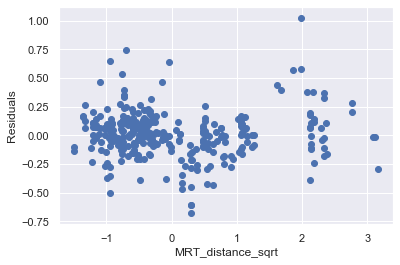

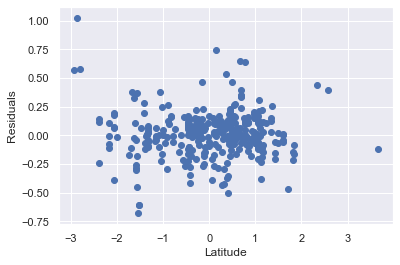

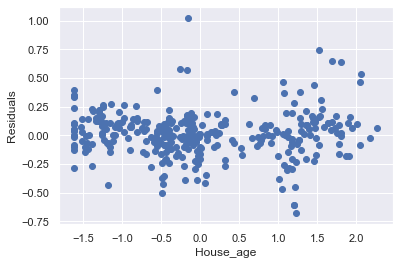

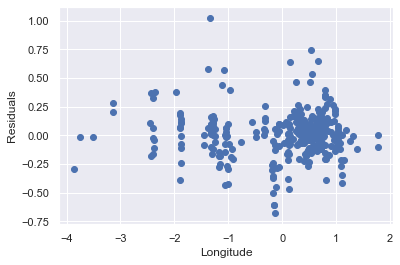

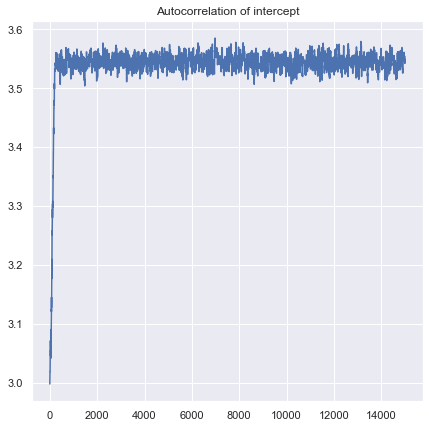

...

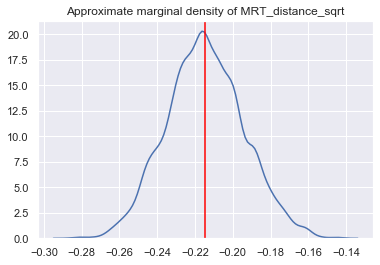

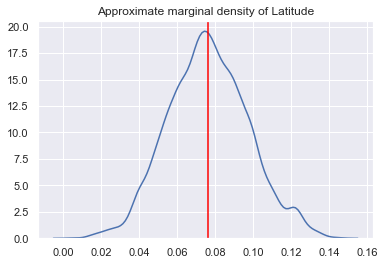

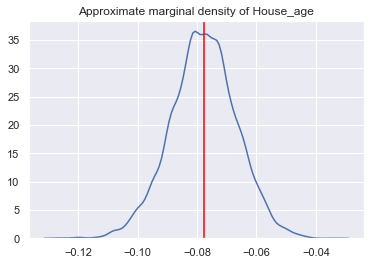

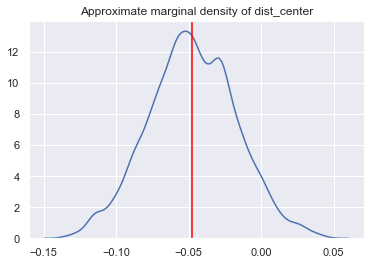

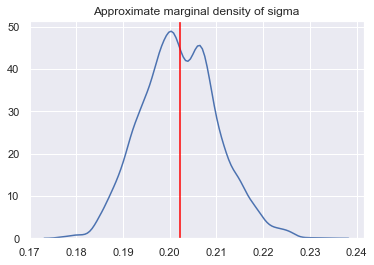

============ Fidelity summary ==================
 the mean square error is :  0.04034094069466826
 MSE test is :  55.321375124001825
 PVE is  :  0.7211583332454475
 F   is  :  210.12421874390117
 p value :  1.1102230246251565e-16
 AIC is  :  -117.46962427471901
 BIC is  :  -98.48933552089215
 AICc is :  -117.28386576078712


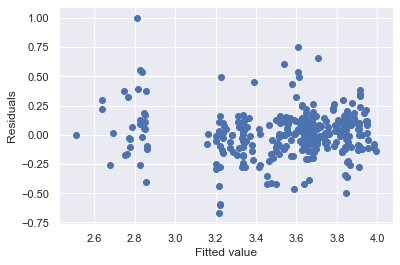

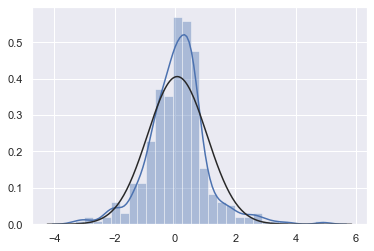

<Figure size 432x288 with 0 Axes>

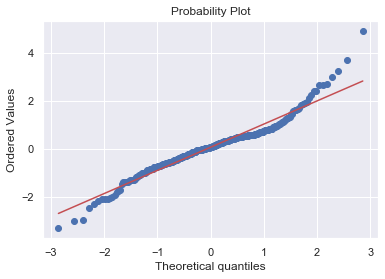

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.06it/s]


Acceptance rate :  0.21066666666666667
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.522, 3.567]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.22  0.02  [-0.248, -0.184] -0.25 -0.23 -0.22 -0.20   
2           Latitude   0.11  0.01    [0.083, 0.133]  0.08  0.10  0.11  0.12   
3          House_age  -0.07  0.01  [-0.094, -0.053] -0.09 -0.08 -0.07 -0.07   
4        orientation   0.03  0.01    [0.003, 0.060]  0.00  0.02  0.03  0.04   
5              sigma   0.20  0.01    [0.185, 0.217]  0.19  0.20  0.20  0.21   

   97.5  
0  3.57  
1 -0.18  
2  0.13  
3 -0.05  
4  0.06  
5  0.22  


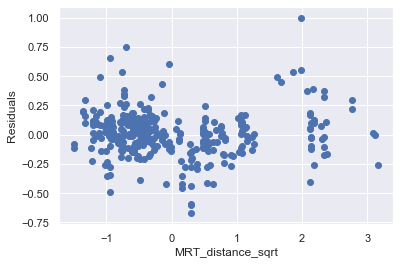

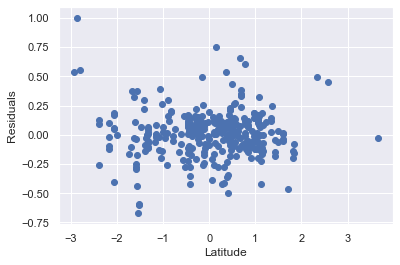

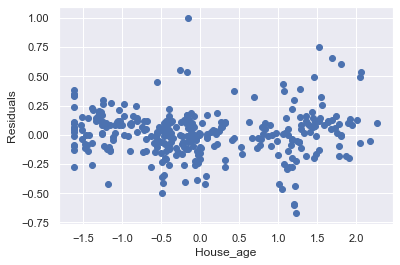

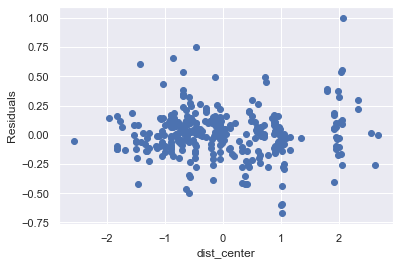

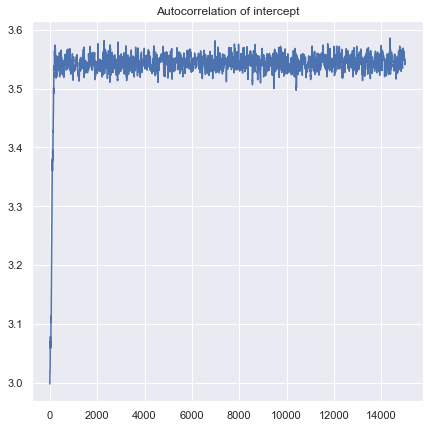

...

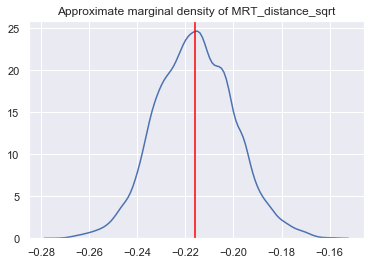

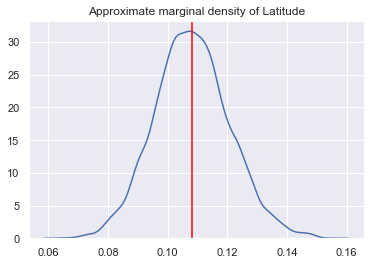

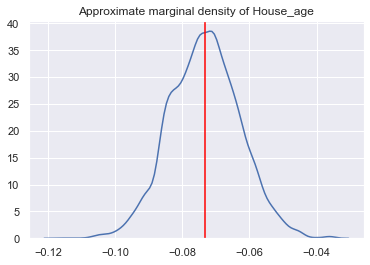

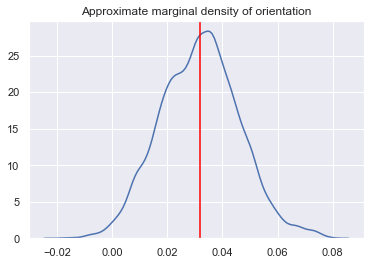

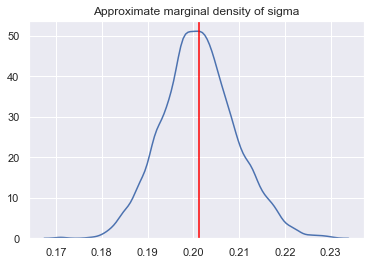

============ Fidelity summary ==================
 the mean square error is :  0.040075646370308964
 MSE test is :  50.20513743040025
 PVE is  :  0.7205568708308531
 F   is  :  211.33879874665527
 p value :  1.1102230246251565e-16
 AIC is  :  -119.65338261569508
 BIC is  :  -100.67309386186822
 AICc is :  -119.46762410176319


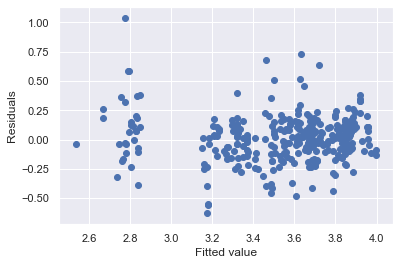

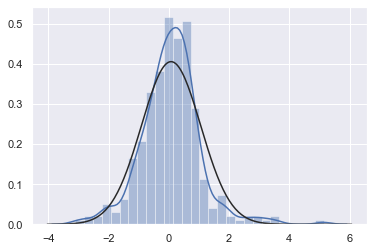

<Figure size 432x288 with 0 Axes>

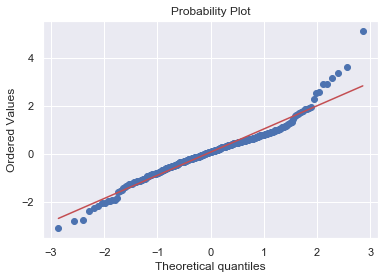

            feature  MSE_train   MSE_test       PVE           F         p_val  \
0              Date   0.038269  49.811731  0.731957  224.814890  1.110223e-16   
1  Conv_store_count   0.038856  48.914577  0.732466  221.575547  1.110223e-16   
2      MRT_distance   0.039140  51.323276  0.722061  216.844260  1.110223e-16   
3         Longitude   0.040633  54.320418  0.719945  208.264222  1.110223e-16   
4       dist_center   0.040341  55.321375  0.721158  210.124219  1.110223e-16   
5       orientation   0.040076  50.205137  0.720557  211.338799  1.110223e-16   

          AIC        AICc         BIC  
0 -134.852956 -115.872667 -115.872667  
1 -129.823440 -110.843151 -110.843151  
2 -127.421481 -108.441192 -108.441192  
3 -115.124003  -96.143714  -96.143714  
4 -117.469624  -98.489336  -98.489336  
5 -119.653383 -100.673094 -100.673094  


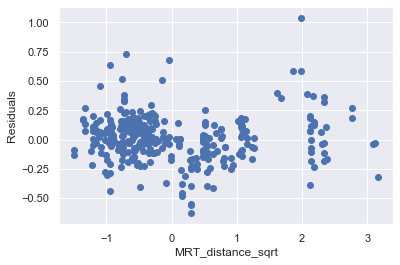

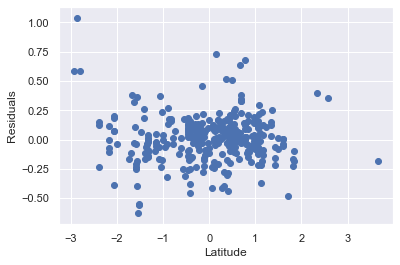

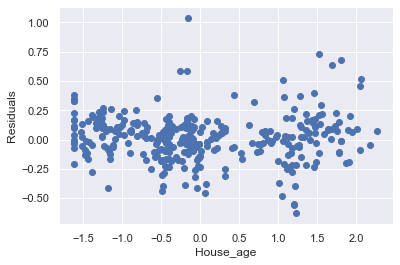

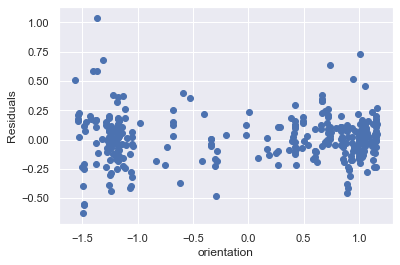

In [5]:
MSE_train = []
MSE_test = []
PVE = []
F =[]
P_val = []
AIC = []
AICc = []
BIC = []

for predictor in X_names :
    predictors = [ 'MRT_distance_sqrt' ,'Latitude', 'House_age', predictor ]
    Parameter = [ 'intercept' ,'MRT_distance_sqrt', 'Latitude','House_age' , predictor ,'sigma']
    X = (data_no_outlier[predictors].dropna()).to_numpy()
    Model = Bayesian_framework(4,Parameter,X,Y,transformation_train = False , transformation_test = True)
    proba_set = Gaussian_model_np(Model)

    # Define the model
    Model.set_log_joint_prior(proba_set.log_joint_prior)
    Model.set_log_likelihood(proba_set.log_likelihood)
    
    # define a sample algorithm :
    init = np.array( [3,0,0,0,0,0.1] )
    step_size = 0.012
    num_samples = 15000

    M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

    M_H.compute_statistic()
    
    # We see that we can select a burn in that around 200
    burn_in = 500

    M_H.compute_statistic(burn_in)
    M_H.summary()
    tool = Vizualisation_tool(Model,M_H)
    tool.trace_visualization()
    tool.autocorrelation_visualization()
    tool.marginal_visualization()
    tool.fidelity()
    tool.diagnostics()
    
    
    F_ , p_value = tool.F_test()
    
    MSE_train.append(tool.MSE())
    MSE_test.append(tool.MSE_test())
    PVE.append(tool.PVE())
    F.append(F_)
    P_val.append(p_value)
    AIC.append(tool.AIC())
    BIC.append(tool.BIC())
    AICc.append(tool.BIC())
    
table = pd.DataFrame()
table["feature"] = X_names
table["MSE_train"] = MSE_train
table["MSE_test"] = MSE_test
table["PVE"] = PVE 
table["F"] = F
table["p_val"] = P_val
table["AIC"] = AIC
table["AICc"] = AICc
table["BIC"] = BIC
print(table)

In [6]:
X_names = [ 'Conv_store_count','MRT_distance','Longitude','dist_center','orientation' ]

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.60it/s]


Acceptance rate :  0.23506666666666667
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.522, 3.563]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.22  0.02  [-0.249, -0.187] -0.25 -0.23 -0.22 -0.21   
2           Latitude   0.09  0.01    [0.066, 0.117]  0.07  0.08  0.09  0.10   
3          House_age  -0.08  0.01  [-0.096, -0.057] -0.10 -0.08 -0.08 -0.07   
4               Date   0.05  0.01    [0.024, 0.066]  0.03  0.04  0.05  0.05   
5   Conv_store_count   0.05  0.01    [0.022, 0.080]  0.02  0.04  0.05  0.06   
6              sigma   0.19  0.01    [0.178, 0.209]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.19  
2  0.12  
3 -0.06  
4  0.07  
5  0.08  
6  0.21  


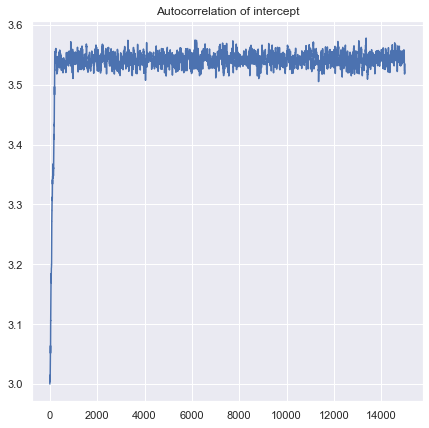

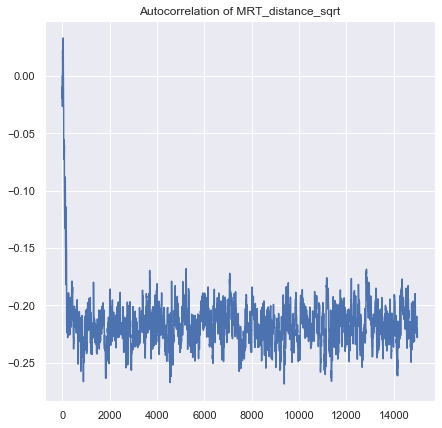

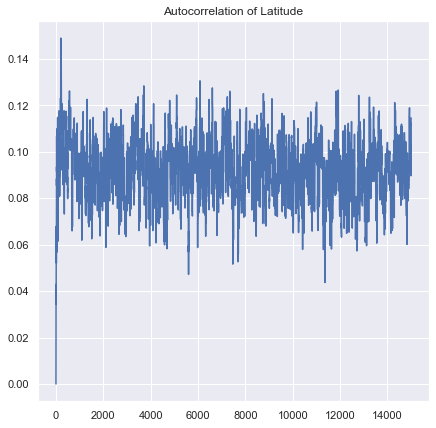

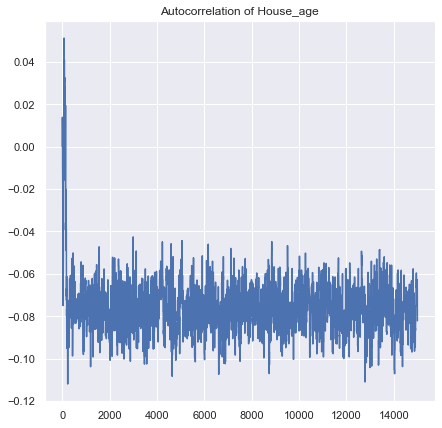

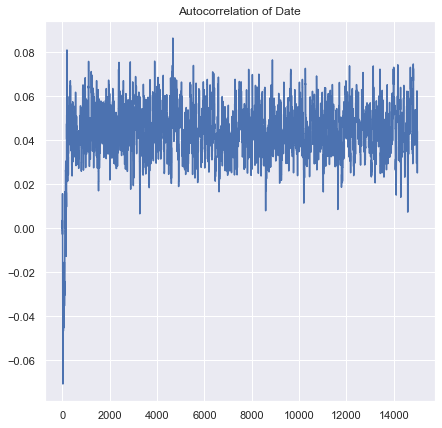

...

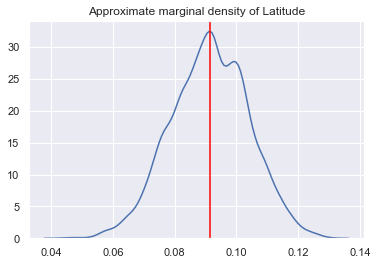

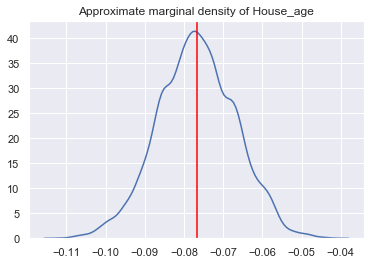

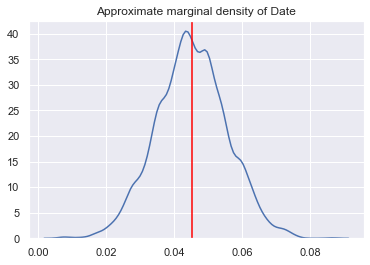

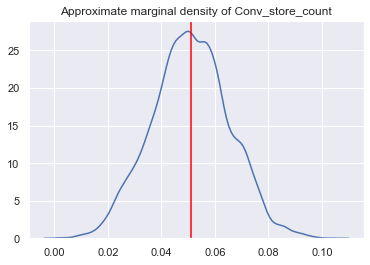

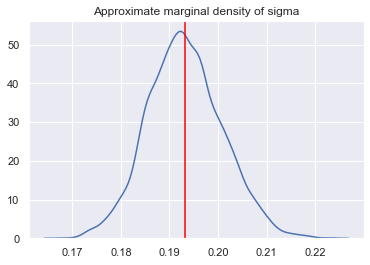

============ Fidelity summary ==================
 the mean square error is :  0.036989128253306185
 MSE test is :  46.02965909790293
 PVE is  :  0.7464250667219104
 F   is  :  189.75516810481037
 p value :  1.1102230246251565e-16
 AIC is  :  -145.0225434528221
 BIC is  :  -122.24619694822988
 AICc is :  -144.7616738876047


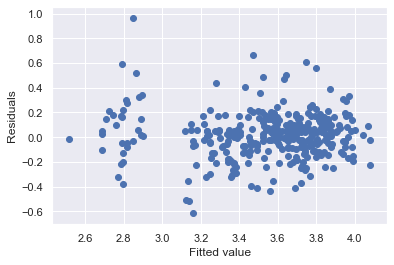

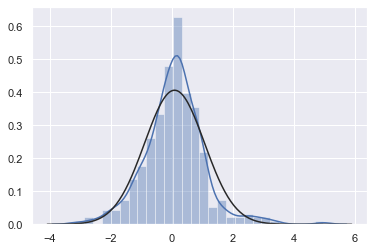

<Figure size 432x288 with 0 Axes>

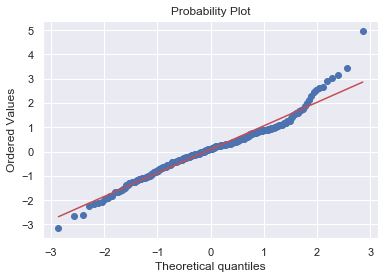

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.32it/s]


Acceptance rate :  0.2328
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.521, 3.564]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.37  0.04  [-0.452, -0.295] -0.45 -0.40 -0.37 -0.34   
2           Latitude   0.10  0.01    [0.079, 0.130]  0.08  0.10  0.10  0.11   
3          House_age  -0.07  0.01  [-0.092, -0.054] -0.09 -0.08 -0.07 -0.07   
4               Date   0.05  0.01    [0.029, 0.072]  0.03  0.04  0.05  0.06   
5       MRT_distance   0.13  0.04    [0.054, 0.211]  0.06  0.10  0.13  0.16   
6              sigma   0.19  0.01    [0.177, 0.208]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.30  
2  0.13  
3 -0.05  
4  0.07  
5  0.21  
6  0.21  


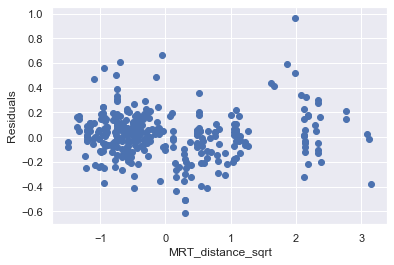

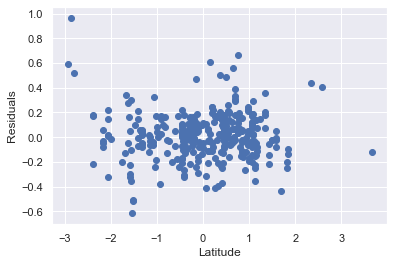

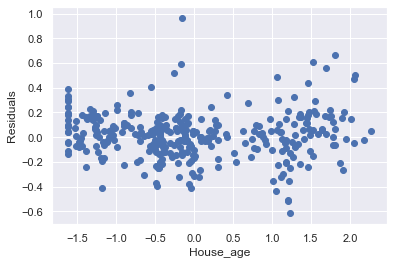

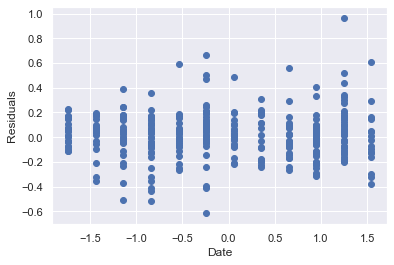

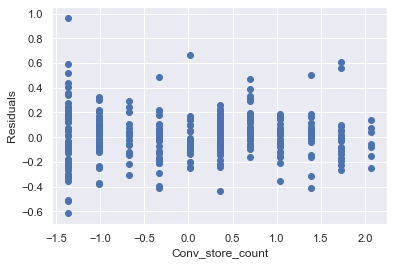

...

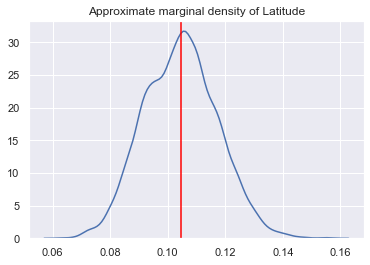

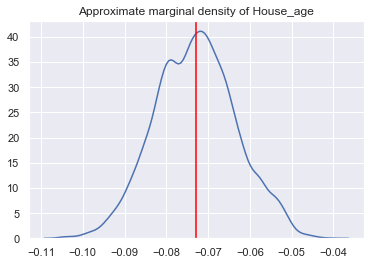

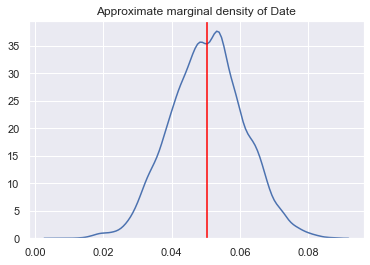

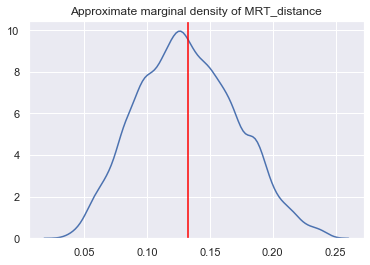

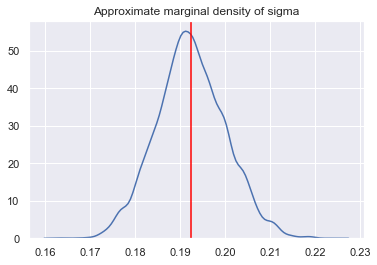

============ Fidelity summary ==================
 the mean square error is :  0.03678640881550251
 MSE test is :  48.44189087619964
 PVE is  :  0.7395588116242442
 F   is  :  189.04570569621822
 p value :  1.1102230246251565e-16
 AIC is  :  -146.85487273717158
 BIC is  :  -124.07852623257935
 AICc is :  -146.59400317195417


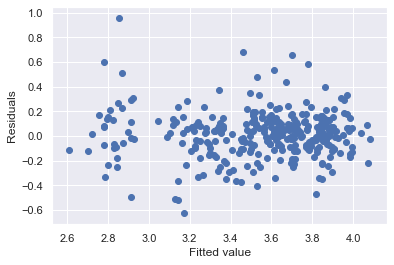

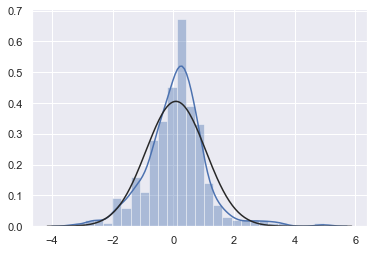

<Figure size 432x288 with 0 Axes>

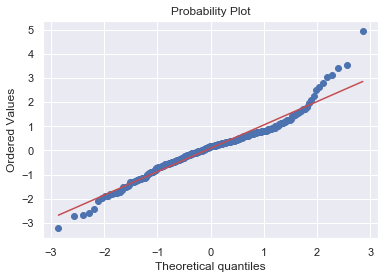

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.54it/s]


Acceptance rate :  0.2458
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.520, 3.564]  3.52  3.53  3.54  3.55   
1  MRT_distance_sqrt  -0.26  0.02  [-0.301, -0.219] -0.30 -0.27 -0.26 -0.25   
2           Latitude   0.09  0.01    [0.069, 0.121]  0.07  0.09  0.10  0.10   
3          House_age  -0.07  0.01  [-0.094, -0.052] -0.09 -0.08 -0.07 -0.07   
4               Date   0.05  0.01    [0.028, 0.070]  0.03  0.04  0.05  0.06   
5          Longitude  -0.01  0.02   [-0.051, 0.024] -0.05 -0.03 -0.01  0.00   
6              sigma   0.20  0.01    [0.181, 0.213]  0.18  0.19  0.20  0.20   

   97.5  
0  3.56  
1 -0.22  
2  0.12  
3 -0.05  
4  0.07  
5  0.02  
6  0.21  


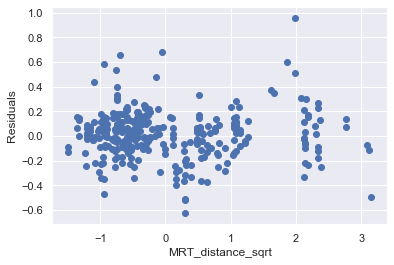

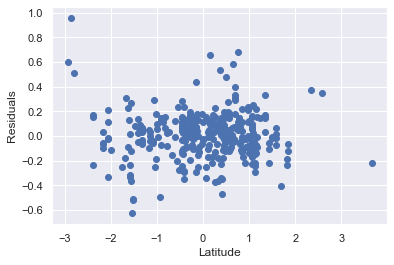

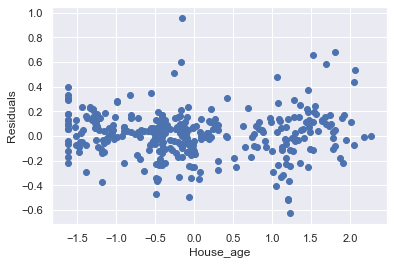

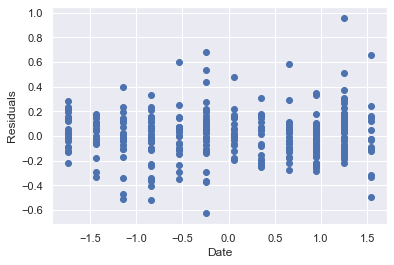

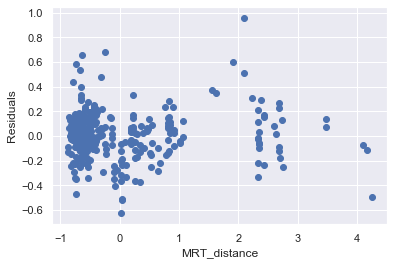

...

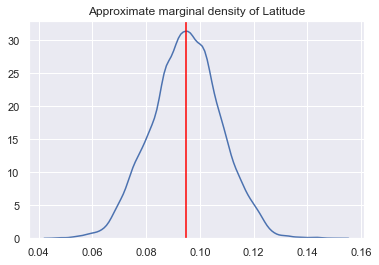

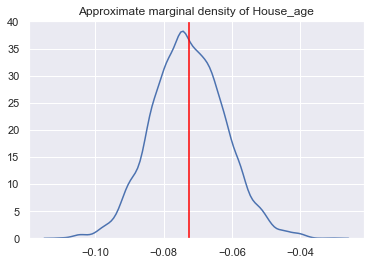

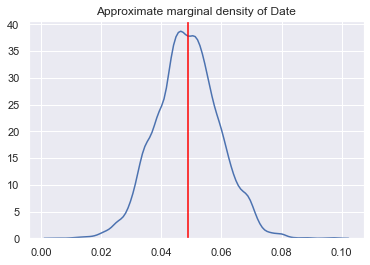

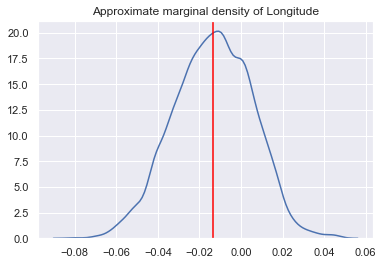

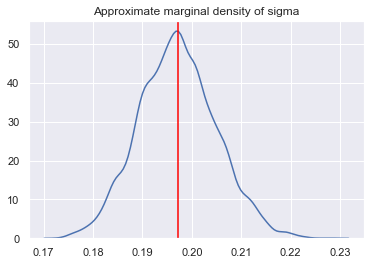

============ Fidelity summary ==================
 the mean square error is :  0.03840668306865578
 MSE test is :  51.194415317593965
 PVE is  :  0.734281112854465
 F   is  :  179.77820891382146
 p value :  1.1102230246251565e-16
 AIC is  :  -132.63013353864102
 BIC is  :  -109.85378703404879
 AICc is :  -132.3692639734236


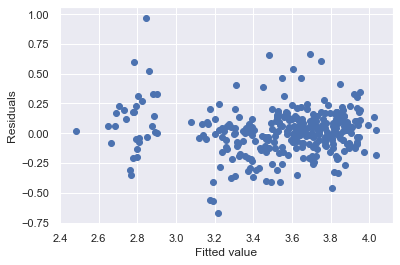

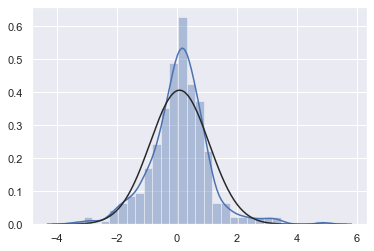

<Figure size 432x288 with 0 Axes>

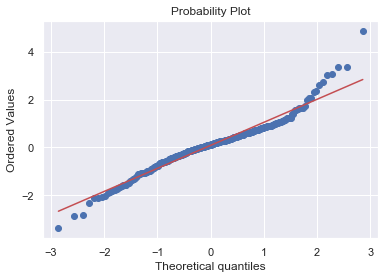

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:11<00:00, 211.08it/s]


Acceptance rate :  0.24186666666666667
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.521, 3.564]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.22  0.02  [-0.259, -0.182] -0.26 -0.23 -0.22 -0.21   
2           Latitude   0.07  0.02    [0.022, 0.109]  0.02  0.05  0.07  0.08   
3          House_age  -0.08  0.01  [-0.100, -0.058] -0.10 -0.09 -0.08 -0.07   
4               Date   0.05  0.01    [0.027, 0.071]  0.03  0.04  0.05  0.06   
5        dist_center  -0.06  0.03   [-0.116, 0.004] -0.12 -0.08 -0.05 -0.04   
6              sigma   0.20  0.01    [0.181, 0.212]  0.18  0.19  0.20  0.20   

   97.5  
0  3.56  
1 -0.18  
2  0.11  
3 -0.06  
4  0.07  
5  0.00  
6  0.21  


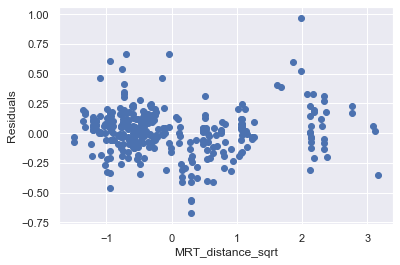

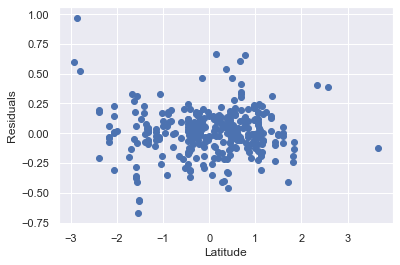

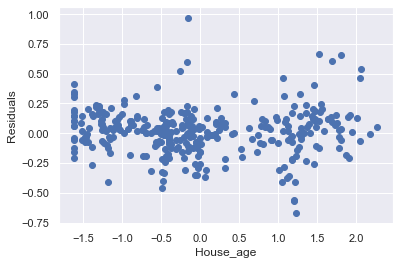

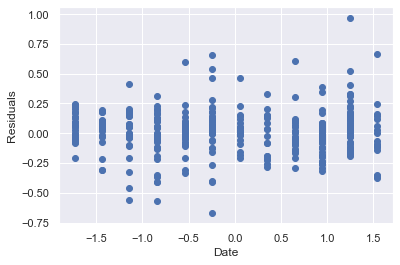

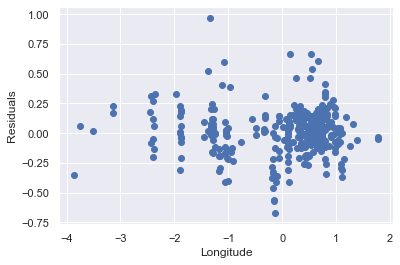

...

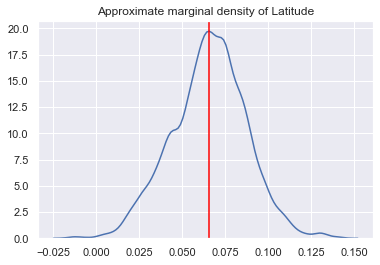

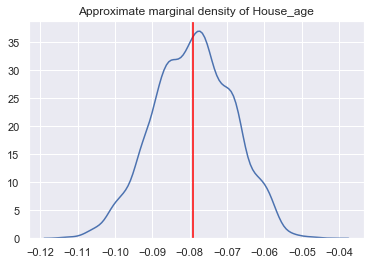

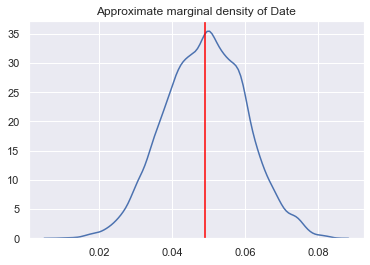

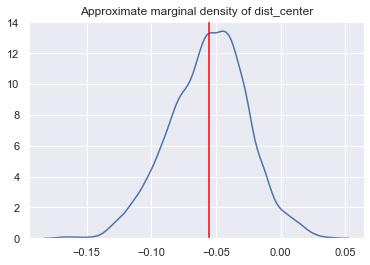

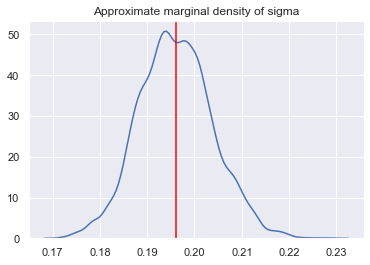

============ Fidelity summary ==================
 the mean square error is :  0.03812648646967041
 MSE test is :  51.96525310961283
 PVE is  :  0.7375987358654712
 F   is  :  181.9176647367099
 p value :  1.1102230246251565e-16
 AIC is  :  -135.06979327144106
 BIC is  :  -112.29344676684883
 AICc is :  -134.80892370622365


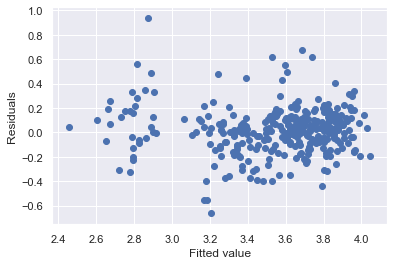

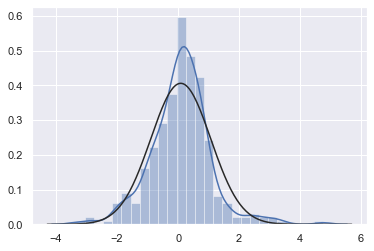

<Figure size 432x288 with 0 Axes>

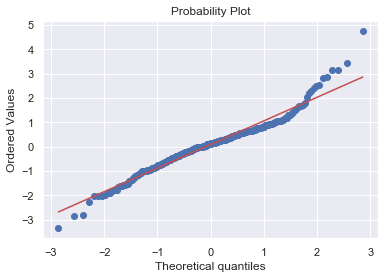

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 212.83it/s]


Acceptance rate :  0.23486666666666667
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.522, 3.563]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.23  0.02  [-0.261, -0.199] -0.26 -0.24 -0.23 -0.22   
2           Latitude   0.10  0.01    [0.075, 0.127]  0.08  0.09  0.10  0.11   
3          House_age  -0.07  0.01  [-0.093, -0.053] -0.09 -0.08 -0.07 -0.07   
4               Date   0.05  0.01    [0.026, 0.067]  0.03  0.04  0.05  0.05   
5        orientation   0.03  0.01   [-0.000, 0.052] -0.00  0.02  0.03  0.03   
6              sigma   0.20  0.01    [0.181, 0.211]  0.18  0.19  0.20  0.20   

   97.5  
0  3.56  
1 -0.20  
2  0.13  
3 -0.05  
4  0.07  
5  0.05  
6  0.21  


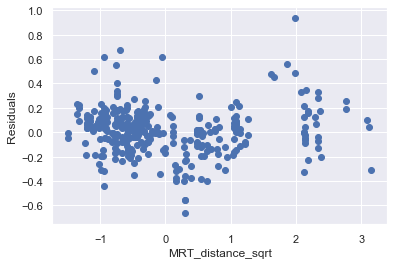

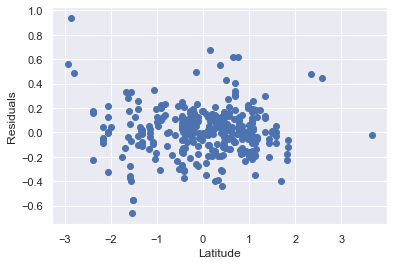

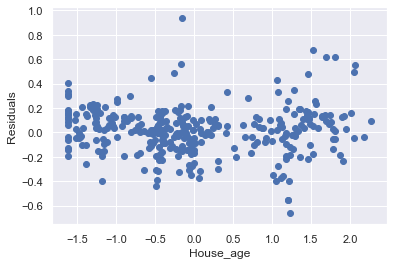

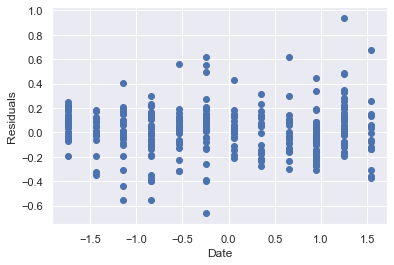

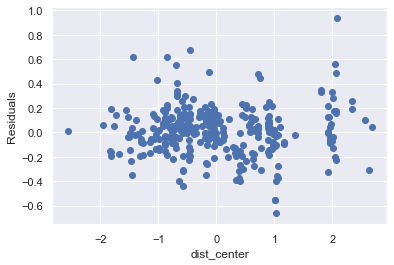

...

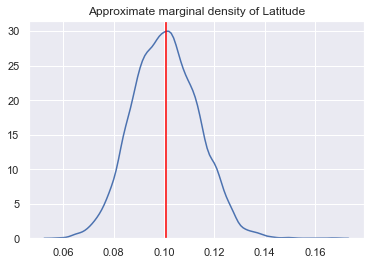

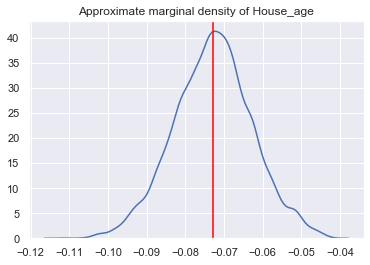

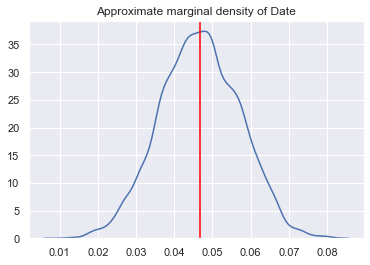

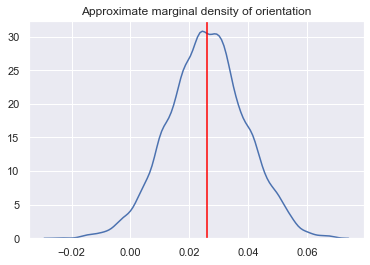

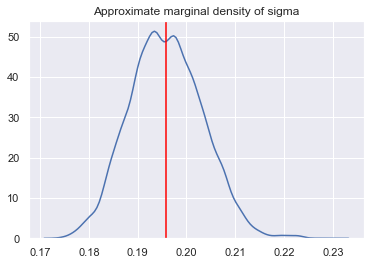

============ Fidelity summary ==================
 the mean square error is :  0.038090808101643434
 MSE test is :  47.62505777113261
 PVE is  :  0.7364245472582256
 F   is  :  181.7981935804582
 p value :  1.1102230246251565e-16
 AIC is  :  -135.38732939671684
 BIC is  :  -112.61098289212461
 AICc is :  -135.12645983149943


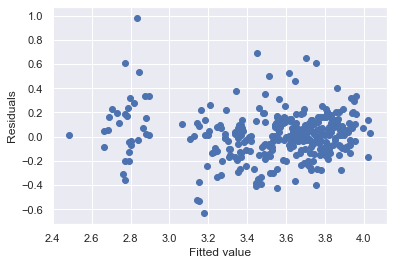

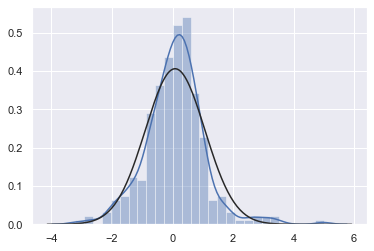

<Figure size 432x288 with 0 Axes>

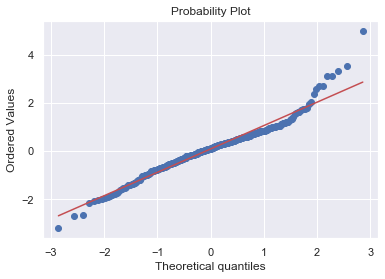

            feature  MSE_train   MSE_test       PVE           F         p_val  \
0  Conv_store_count   0.036989  46.029659  0.746425  189.755168  1.110223e-16   
1      MRT_distance   0.036786  48.441891  0.739559  189.045706  1.110223e-16   
2         Longitude   0.038407  51.194415  0.734281  179.778209  1.110223e-16   
3       dist_center   0.038126  51.965253  0.737599  181.917665  1.110223e-16   
4       orientation   0.038091  47.625058  0.736425  181.798194  1.110223e-16   

          AIC        AICc         BIC  
0 -145.022543 -122.246197 -122.246197  
1 -146.854873 -124.078526 -124.078526  
2 -132.630134 -109.853787 -109.853787  
3 -135.069793 -112.293447 -112.293447  
4 -135.387329 -112.610983 -112.610983  


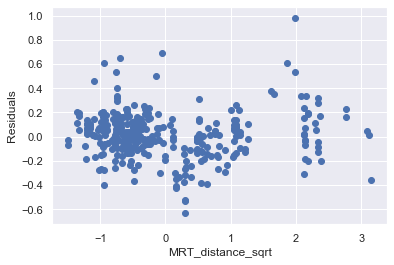

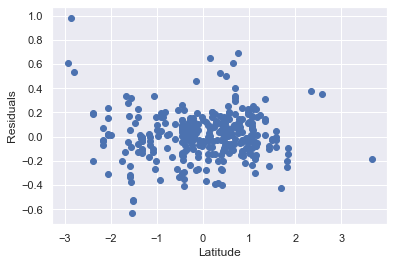

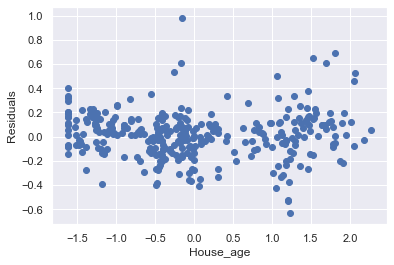

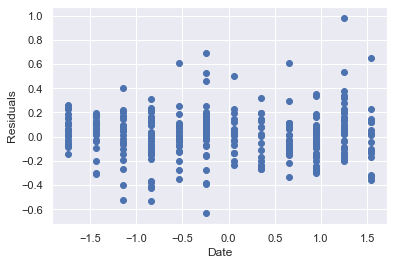

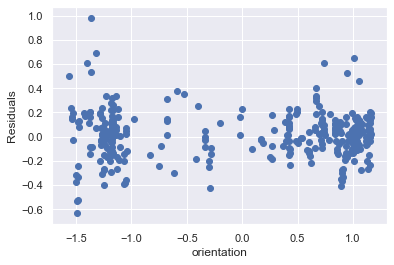

In [7]:
MSE_train = []
MSE_test = []
PVE = []
F =[]
P_val = []
AIC = []
AICc = []
BIC = []

for predictor in X_names :
    predictors = [ 'MRT_distance_sqrt' ,'Latitude', 'House_age','Date', predictor ]
    Parameter = [ 'intercept' ,'MRT_distance_sqrt', 'Latitude','House_age' ,'Date', predictor ,'sigma']
    X = (data_no_outlier[predictors].dropna()).to_numpy()
    Model = Bayesian_framework(5,Parameter,X,Y,transformation_train = False , transformation_test = True)
    proba_set = Gaussian_model_np(Model)

    # Define the model
    Model.set_log_joint_prior(proba_set.log_joint_prior)
    Model.set_log_likelihood(proba_set.log_likelihood)
    
    # define a sample algorithm :
    init = np.array( [3,0,0,0,0,0,0.1] )
    step_size = 0.010
    num_samples = 15000

    M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

    M_H.compute_statistic()
    
    # We see that we can select a burn in that around 200
    burn_in = 500

    M_H.compute_statistic(burn_in)
    M_H.summary()
    tool = Vizualisation_tool(Model,M_H)
    tool.trace_visualization()
    tool.autocorrelation_visualization()
    tool.marginal_visualization()
    tool.fidelity()
    tool.diagnostics()
    
    
    F_ , p_value = tool.F_test()
    
    MSE_train.append(tool.MSE())
    MSE_test.append(tool.MSE_test())
    PVE.append(tool.PVE())
    F.append(F_)
    P_val.append(p_value)
    AIC.append(tool.AIC())
    BIC.append(tool.BIC())
    AICc.append(tool.BIC())
    
table = pd.DataFrame()
table["feature"] = X_names
table["MSE_train"] = MSE_train
table["MSE_test"] = MSE_test
table["PVE"] = PVE 
table["F"] = F
table["p_val"] = P_val
table["AIC"] = AIC
table["AICc"] = AICc
table["BIC"] = BIC
print(table)

In [8]:
X_names = [ 'MRT_distance','Longitude','dist_center','orientation' ]

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.37it/s]


Acceptance rate :  0.20813333333333334
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.520, 3.561]  3.52  3.53  3.54  3.55   
1  MRT_distance_sqrt  -0.32  0.05  [-0.424, -0.224] -0.42 -0.36 -0.32 -0.30   
2           Latitude   0.10  0.01    [0.072, 0.126]  0.07  0.09  0.10  0.11   
3          House_age  -0.08  0.01  [-0.096, -0.057] -0.10 -0.08 -0.08 -0.07   
4               Date   0.05  0.01    [0.026, 0.068]  0.03  0.04  0.05  0.05   
5   Conv_store_count   0.04  0.01    [0.013, 0.071]  0.01  0.03  0.04  0.05   
6       MRT_distance   0.11  0.05    [0.013, 0.201]  0.02  0.08  0.11  0.14   
7              sigma   0.19  0.01    [0.175, 0.207]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.22  
2  0.13  
3 -0.06  
4  0.07  
5  0.07  
6  0.20  
7  0.21  


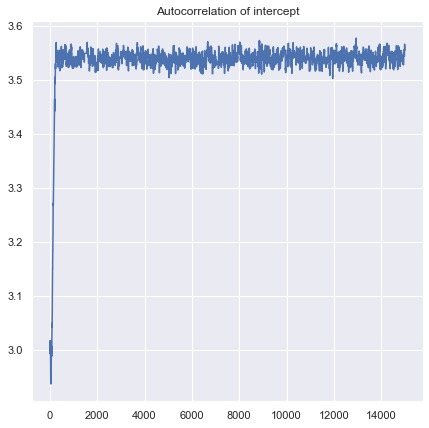

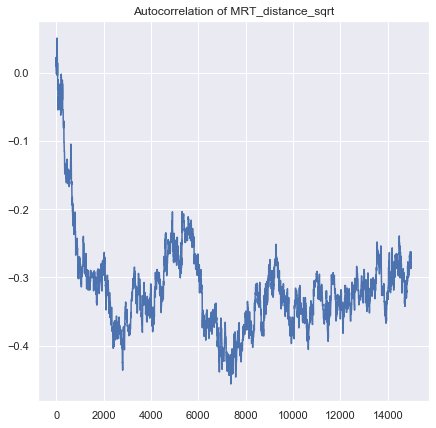

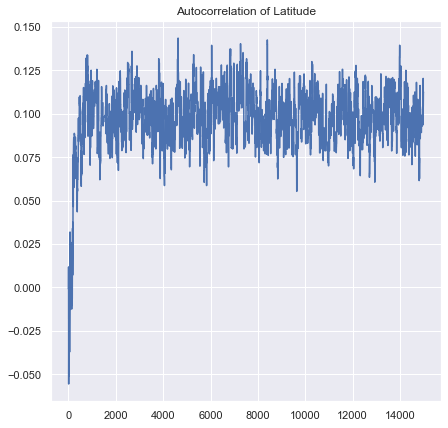

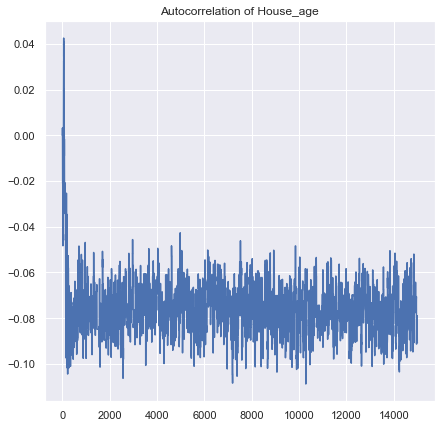

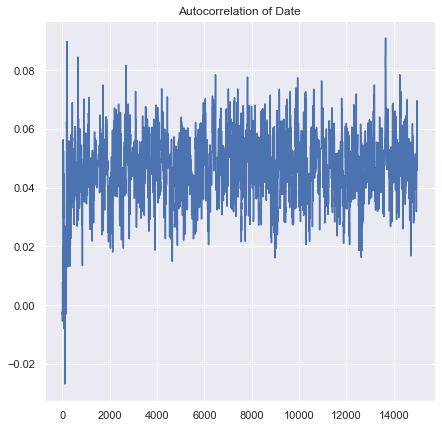

...

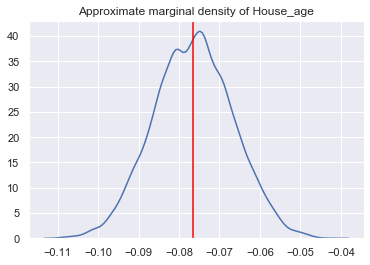

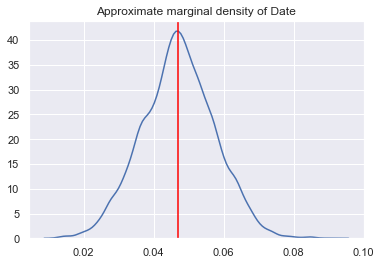

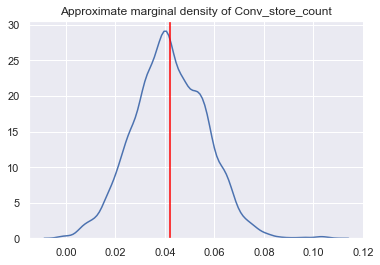

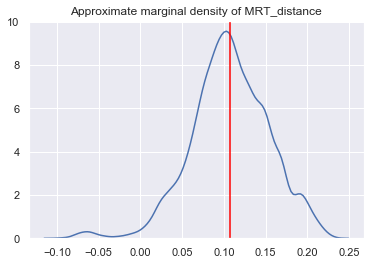

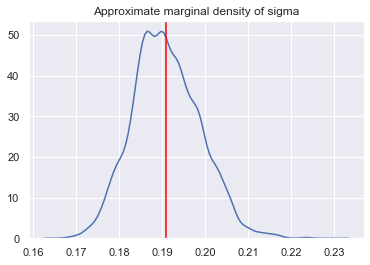

============ Fidelity summary ==================
 the mean square error is :  0.03619497259981705
 MSE test is :  46.053854610940164
 PVE is  :  0.746520635160298
 F   is  :  161.6195198467769
 p value :  1.1102230246251565e-16
 AIC is  :  -151.16939750905405
 BIC is  :  -124.59699325369644
 AICc is :  -150.8204878517332


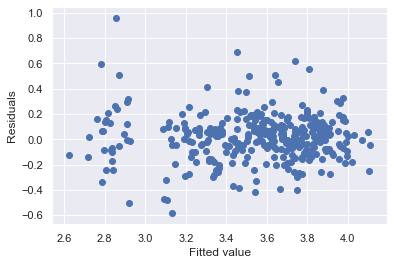

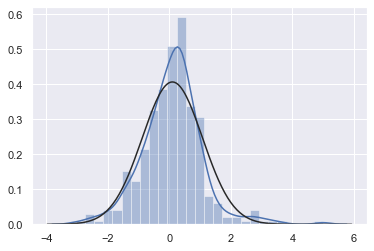

<Figure size 432x288 with 0 Axes>

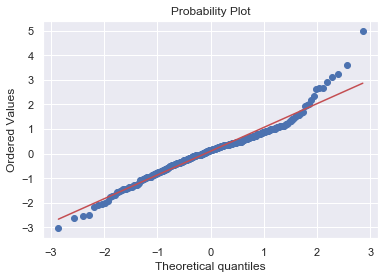

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 211.78it/s]


Acceptance rate :  0.20793333333333333
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.519, 3.561]  3.52  3.53  3.54  3.55   
1  MRT_distance_sqrt  -0.22  0.02  [-0.265, -0.177] -0.27 -0.24 -0.22 -0.21   
2           Latitude   0.09  0.01    [0.065, 0.115]  0.07  0.08  0.09  0.10   
3          House_age  -0.08  0.01  [-0.097, -0.056] -0.10 -0.08 -0.08 -0.07   
4               Date   0.05  0.01    [0.025, 0.067]  0.03  0.04  0.05  0.05   
5   Conv_store_count   0.05  0.01    [0.023, 0.079]  0.02  0.04  0.05  0.06   
6          Longitude  -0.00  0.02   [-0.041, 0.035] -0.04 -0.02 -0.00  0.01   
7              sigma   0.19  0.01    [0.178, 0.209]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.18  
2  0.11  
3 -0.06  
4  0.07  
5  0.08  
6  0.03  
7  0.21  


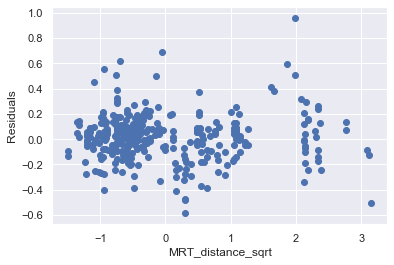

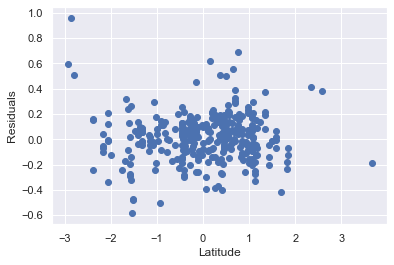

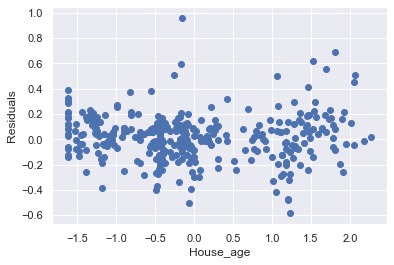

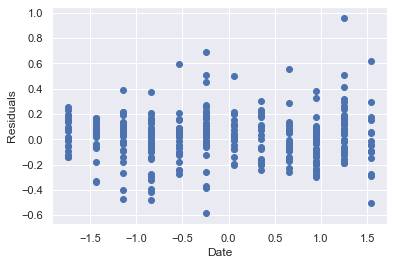

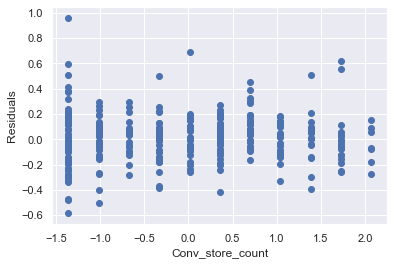

...

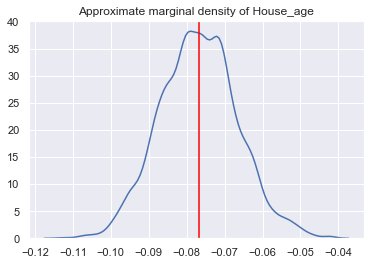

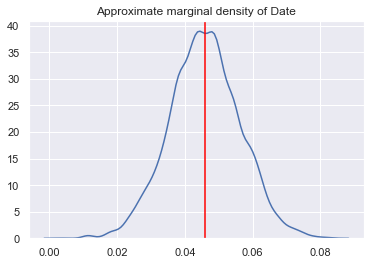

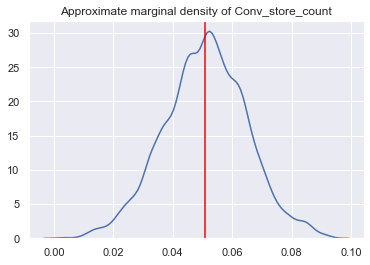

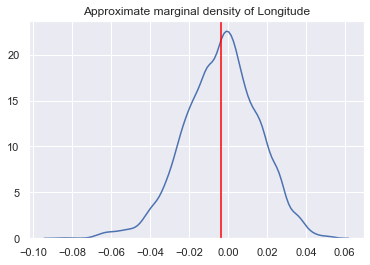

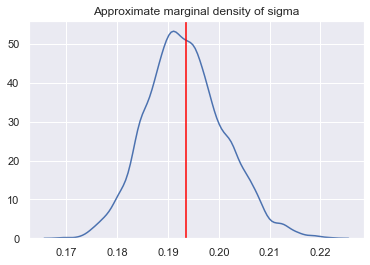

============ Fidelity summary ==================
 the mean square error is :  0.03718790173166963
 MSE test is :  46.94443223372547
 PVE is  :  0.7462271049747959
 F   is  :  157.24237418083237
 p value :  1.1102230246251565e-16
 AIC is  :  -142.27779860181076
 BIC is  :  -115.70539434645315
 AICc is :  -141.9288889444899


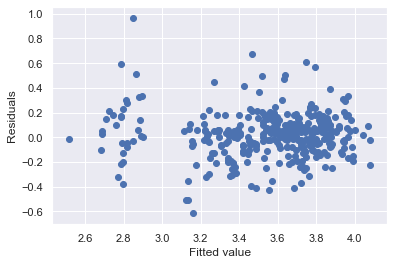

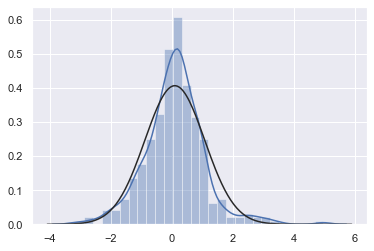

<Figure size 432x288 with 0 Axes>

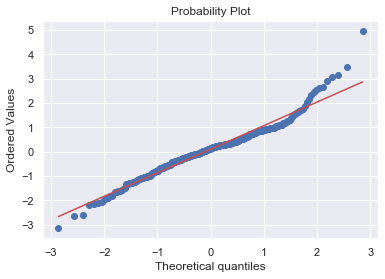

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:09<00:00, 215.10it/s]


Acceptance rate :  0.215
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.518, 3.562]  3.52  3.53  3.54  3.55   
1  MRT_distance_sqrt  -0.20  0.02  [-0.238, -0.156] -0.24 -0.21 -0.20 -0.18   
2           Latitude   0.07  0.02    [0.026, 0.109]  0.03  0.05  0.07  0.08   
3          House_age  -0.08  0.01  [-0.102, -0.059] -0.10 -0.09 -0.08 -0.07   
4               Date   0.05  0.01    [0.024, 0.067]  0.03  0.04  0.05  0.05   
5   Conv_store_count   0.05  0.01    [0.024, 0.077]  0.02  0.04  0.05  0.06   
6        dist_center  -0.04  0.03   [-0.101, 0.017] -0.11 -0.06 -0.04 -0.02   
7              sigma   0.19  0.01    [0.177, 0.208]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.16  
2  0.11  
3 -0.06  
4  0.07  
5  0.08  
6  0.01  
7  0.21  


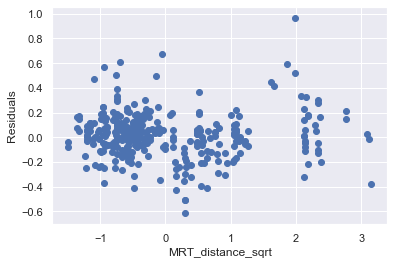

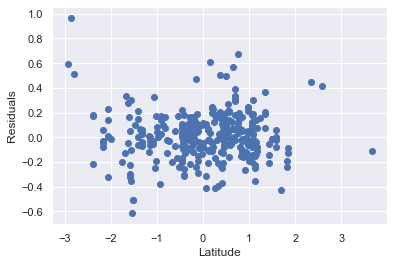

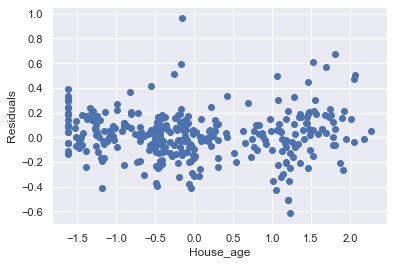

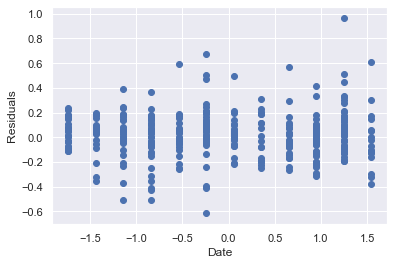

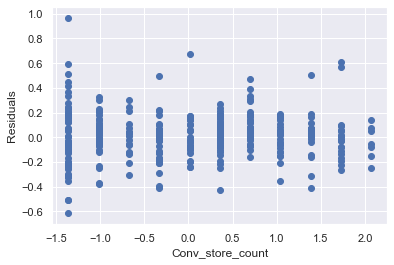

...

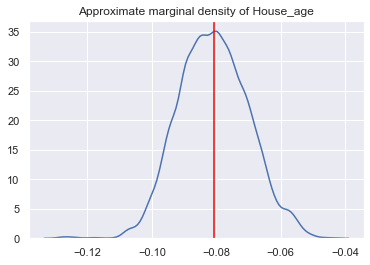

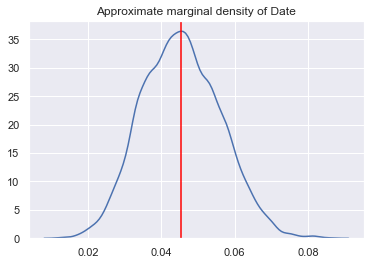

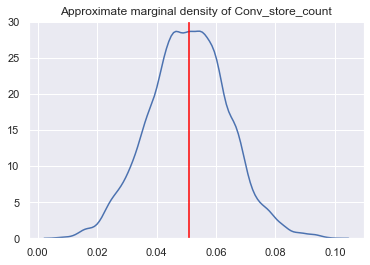

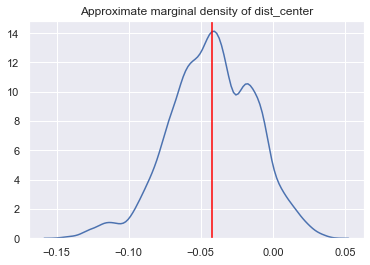

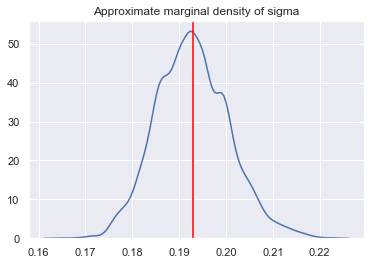

============ Fidelity summary ==================
 the mean square error is :  0.03695184264020816
 MSE test is :  47.948779177029394
 PVE is  :  0.7476733807497417
 F   is  :  158.55358513483625
 p value :  1.1102230246251565e-16
 AIC is  :  -144.37125363386585
 BIC is  :  -117.79884937850824
 AICc is :  -144.022343976545


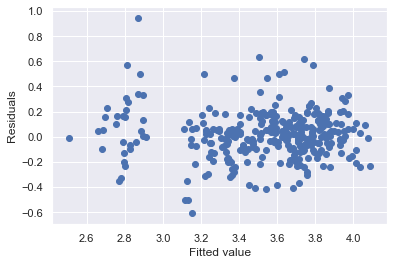

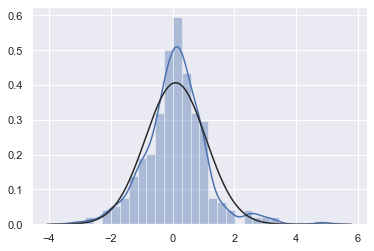

<Figure size 432x288 with 0 Axes>

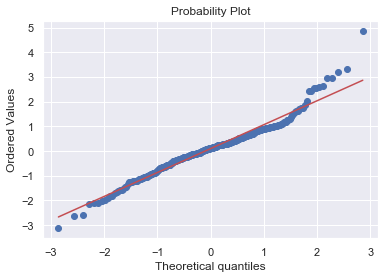

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:10<00:00, 211.45it/s]


Acceptance rate :  0.20726666666666665
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.519, 3.562]  3.52  3.53  3.54  3.55   
1  MRT_distance_sqrt  -0.21  0.02  [-0.245, -0.182] -0.24 -0.22 -0.21 -0.20   
2           Latitude   0.09  0.01    [0.066, 0.120]  0.07  0.08  0.09  0.10   
3          House_age  -0.08  0.01  [-0.097, -0.057] -0.10 -0.08 -0.08 -0.07   
4               Date   0.05  0.01    [0.025, 0.066]  0.02  0.04  0.05  0.05   
5   Conv_store_count   0.05  0.01    [0.019, 0.076]  0.02  0.04  0.05  0.06   
6        orientation   0.01  0.01   [-0.017, 0.038] -0.02  0.00  0.01  0.02   
7              sigma   0.19  0.01    [0.178, 0.208]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.18  
2  0.12  
3 -0.06  
4  0.07  
5  0.08  
6  0.04  
7  0.21  


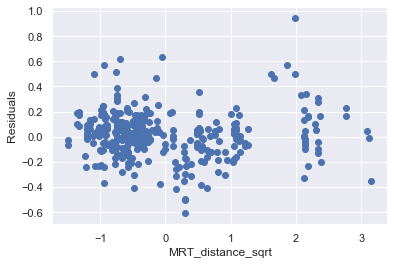

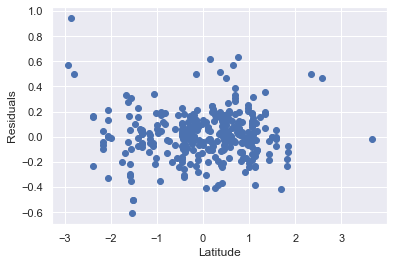

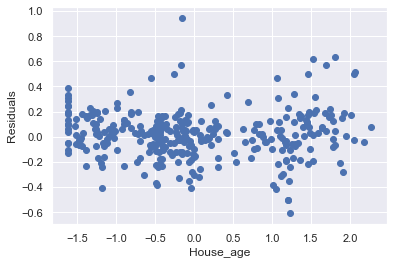

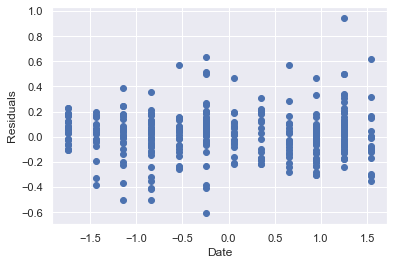

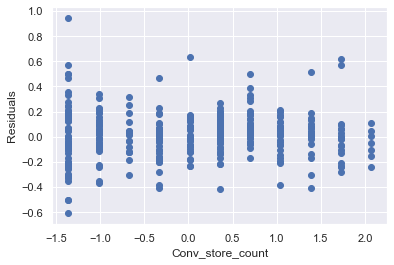

...

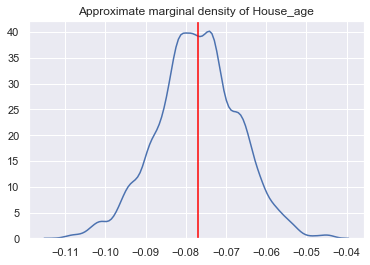

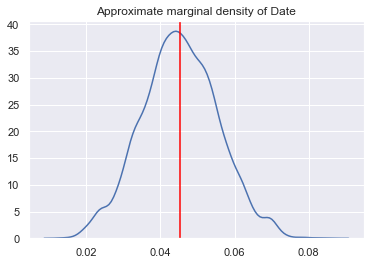

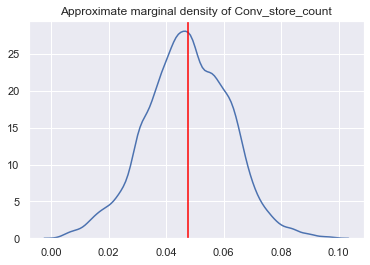

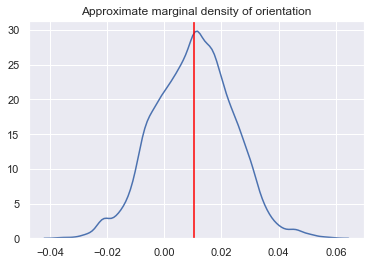

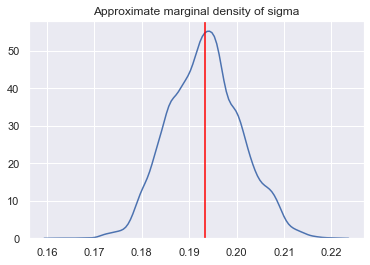

============ Fidelity summary ==================
 the mean square error is :  0.03714581732691578
 MSE test is :  45.92796817448173
 PVE is  :  0.7465821785030237
 F   is  :  157.495426767931
 p value :  1.1102230246251565e-16
 AIC is  :  -142.65291727262218
 BIC is  :  -116.08051301726456
 AICc is :  -142.30400761530132


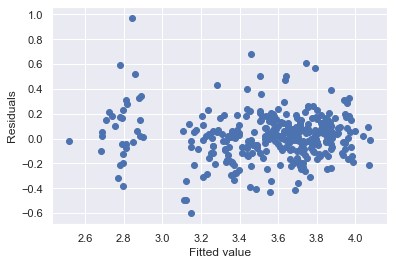

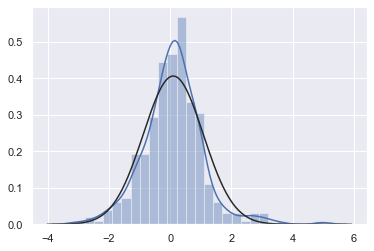

<Figure size 432x288 with 0 Axes>

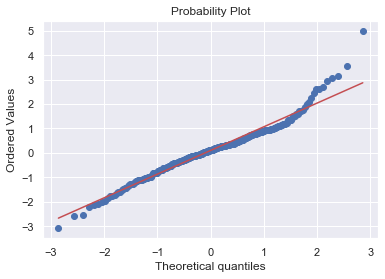

        feature  MSE_train   MSE_test       PVE           F         p_val  \
0  MRT_distance   0.036195  46.053855  0.746521  161.619520  1.110223e-16   
1     Longitude   0.037188  46.944432  0.746227  157.242374  1.110223e-16   
2   dist_center   0.036952  47.948779  0.747673  158.553585  1.110223e-16   
3   orientation   0.037146  45.927968  0.746582  157.495427  1.110223e-16   

          AIC        AICc         BIC  
0 -151.169398 -124.596993 -124.596993  
1 -142.277799 -115.705394 -115.705394  
2 -144.371254 -117.798849 -117.798849  
3 -142.652917 -116.080513 -116.080513  


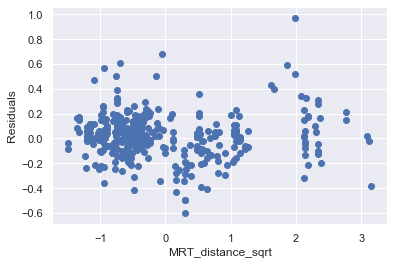

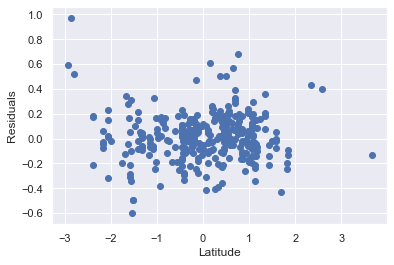

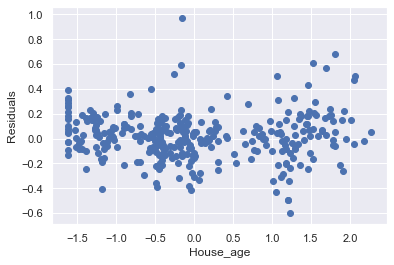

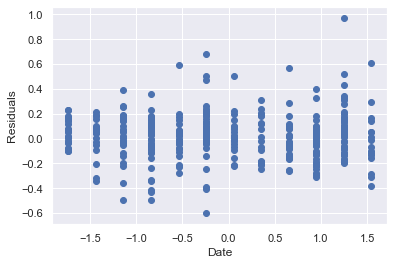

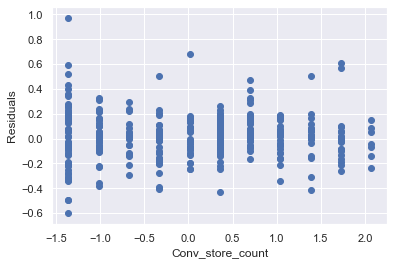

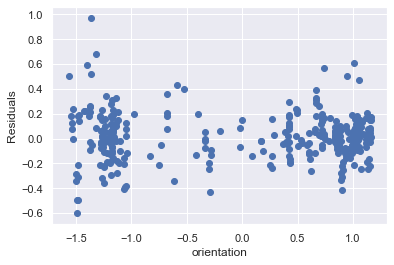

In [9]:
MSE_train = []
MSE_test = []
PVE = []
F =[]
P_val = []
AIC = []
AICc = []
BIC = []

for predictor in X_names :
    predictors = [ 'MRT_distance_sqrt' ,'Latitude', 'House_age','Date','Conv_store_count', predictor ]
    Parameter = [ 'intercept' ,'MRT_distance_sqrt', 'Latitude','House_age' ,'Date','Conv_store_count', predictor ,'sigma']
    X = (data_no_outlier[predictors].dropna()).to_numpy()
    Model = Bayesian_framework(6,Parameter,X,Y,transformation_train = False , transformation_test = True)
    proba_set = Gaussian_model_np(Model)

    # Define the model
    Model.set_log_joint_prior(proba_set.log_joint_prior)
    Model.set_log_likelihood(proba_set.log_likelihood)
    
    # define a sample algorithm :
    init = np.array( [3,0,0,0,0,0,0,0.1] )
    step_size = 0.010
    num_samples = 15000

    M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

    M_H.compute_statistic()
    
    # We see that we can select a burn in that around 200
    burn_in = 500

    M_H.compute_statistic(burn_in)
    M_H.summary()
    tool = Vizualisation_tool(Model,M_H)
    tool.trace_visualization()
    tool.autocorrelation_visualization()
    tool.marginal_visualization()
    tool.fidelity()
    tool.diagnostics()
    
    
    F_ , p_value = tool.F_test()
    
    MSE_train.append(tool.MSE())
    MSE_test.append(tool.MSE_test())
    PVE.append(tool.PVE())
    F.append(F_)
    P_val.append(p_value)
    AIC.append(tool.AIC())
    BIC.append(tool.BIC())
    AICc.append(tool.BIC())
    
table = pd.DataFrame()
table["feature"] = X_names
table["MSE_train"] = MSE_train
table["MSE_test"] = MSE_test
table["PVE"] = PVE 
table["F"] = F
table["p_val"] = P_val
table["AIC"] = AIC
table["AICc"] = AICc
table["BIC"] = BIC
print(table)

### Final model

100%|███████████████████████████████████████████████████████████████████████████| 15000/15000 [01:08<00:00, 219.59it/s]


Acceptance rate :  0.23506666666666667
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.522, 3.563]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.22  0.02  [-0.249, -0.187] -0.25 -0.23 -0.22 -0.21   
2           Latitude   0.09  0.01    [0.066, 0.117]  0.07  0.08  0.09  0.10   
3          House_age  -0.08  0.01  [-0.096, -0.057] -0.10 -0.08 -0.08 -0.07   
4               Date   0.05  0.01    [0.024, 0.066]  0.03  0.04  0.05  0.05   
5   Conv_store_count   0.05  0.01    [0.022, 0.080]  0.02  0.04  0.05  0.06   
6              sigma   0.19  0.01    [0.178, 0.209]  0.18  0.19  0.19  0.20   

   97.5  
0  3.56  
1 -0.19  
2  0.12  
3 -0.06  
4  0.07  
5  0.08  
6  0.21  


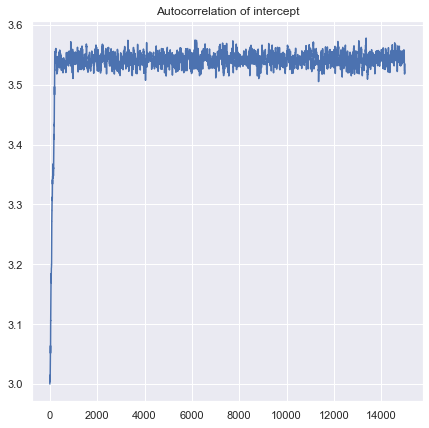

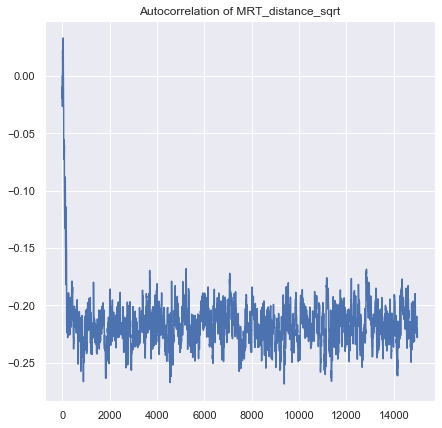

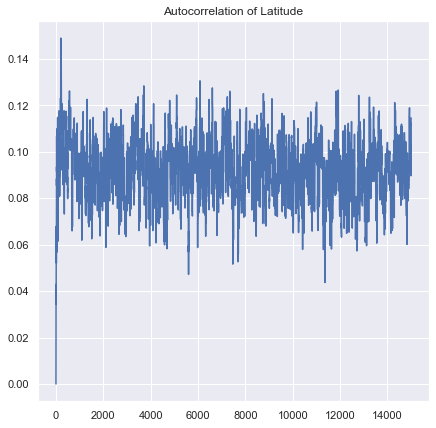

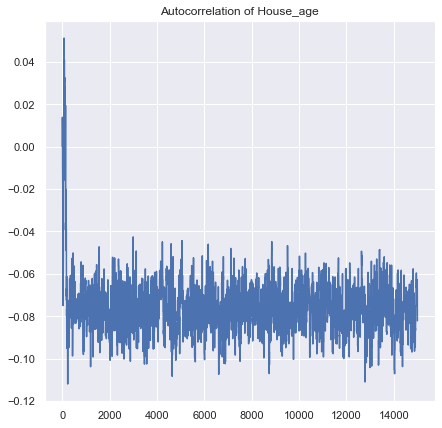

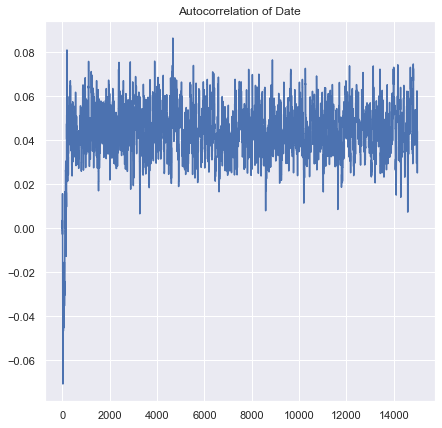

...

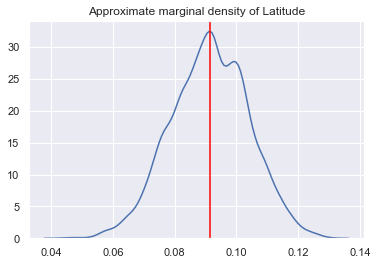

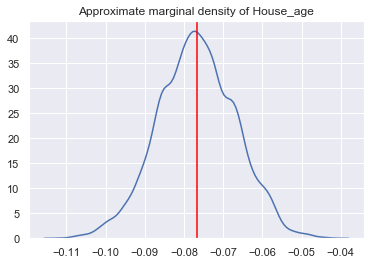

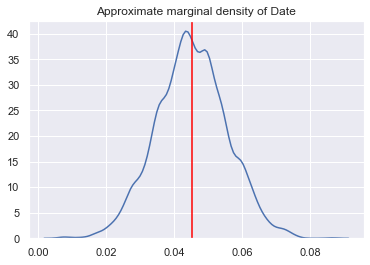

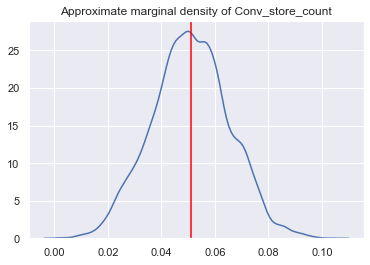

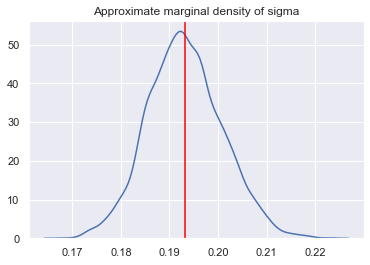

============ Fidelity summary ==================
 the mean square error is :  0.036989128253306185
 MSE test is :  46.02965909790293
 PVE is  :  0.7464250667219104
 F   is  :  189.75516810481037
 p value :  1.1102230246251565e-16
 AIC is  :  -145.0225434528221
 BIC is  :  -122.24619694822988
 AICc is :  -144.7616738876047


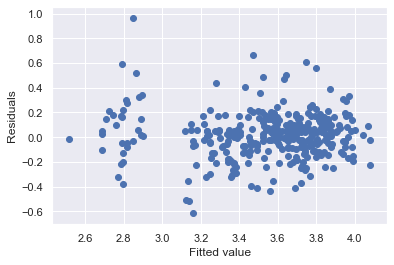

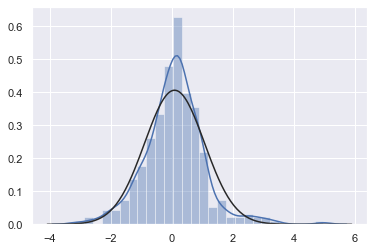

<Figure size 432x288 with 0 Axes>

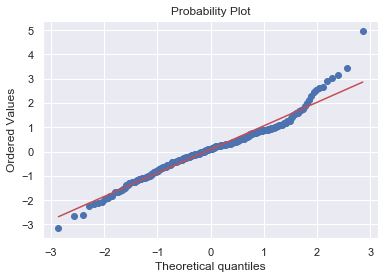

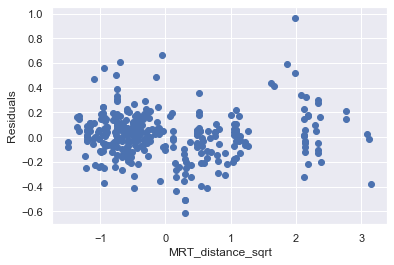

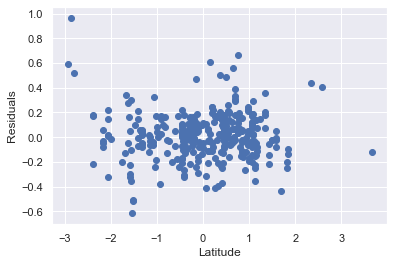

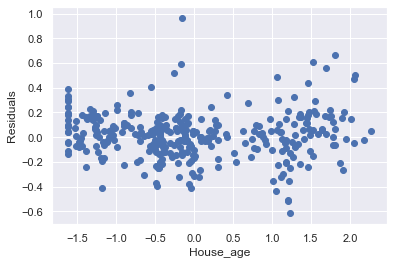

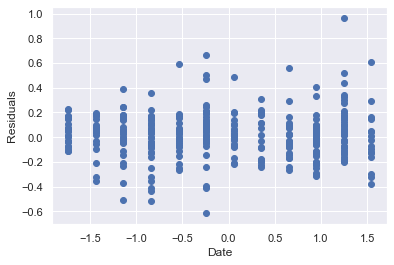

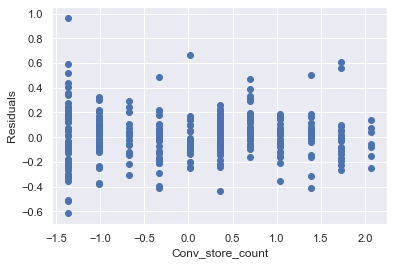

In [10]:
predictors = [ 'MRT_distance_sqrt' ,'Latitude', 'House_age','Date','Conv_store_count']
Parameter = [ 'intercept' , 'MRT_distance_sqrt' ,'Latitude', 'House_age','Date','Conv_store_count','sigma' ]
X = (data_no_outlier[predictors].dropna()).to_numpy()
Model = Bayesian_framework(5,Parameter,X,Y,transformation_train = False , transformation_test = True)
proba_set = Gaussian_model_np(Model)

# Define the model
Model.set_log_joint_prior(proba_set.log_joint_prior)
Model.set_log_likelihood(proba_set.log_likelihood)

# define a sample algorithm :
init = np.array( [3,0,0,0,0,0,0.1] )
step_size = 0.010
num_samples = 15000

M_H = Metropolis_hastings(Model,init ,step_size,num_samples)

M_H.compute_statistic()

# We see that we can select a burn in that around 200
burn_in = 500

M_H.compute_statistic(burn_in)
M_H.summary()
tool = Vizualisation_tool(Model,M_H)
tool.trace_visualization()
tool.autocorrelation_visualization()
tool.marginal_visualization()

tool.fidelity()
tool.diagnostics()

## Using GVA



  0%|                                                                                          | 0/300 [00:00<?, ?it/s]

 the loss is : tensor([745.2470], grad_fn=<NegBackward>)
 the grad is : tensor([ 38.0422,  28.0932, -33.7378, -31.3240, -16.9000,  92.5791])
 norm of the gradient  tensor(114.9451)




  0%|▎                                                                                 | 1/300 [00:01<09:18,  1.87s/it]

tensor([ 2.8204, -0.1327,  0.1593,  0.1479,  0.0798,  1.5628])




  1%|▌                                                                                 | 2/300 [00:03<09:05,  1.83s/it]

  1%|▊                                                                                 | 3/300 [00:06<10:41,  2.16s/it]

  1%|█                                                                                 | 4/300 [00:08<10:19,  2.09s/it]

  2%|█▎                                                                                | 5/300 [00:12<13:28,  2.74s/it]

  2%|█▋                                                                                | 6/300 [00:15<12:56,  2.64s/it]

  2%|█▉                                                                                | 7/300 [00:17<12:14,  2.51s/it]

  3%|██▏                                                                               | 8/300 [00:21<15:08,  3.11s/it]

  3%|██▍                                                                               | 9/300 [00:24<14:06,  2.91s/it]

  3%|██▋                      

 the loss is : tensor([189.1656], grad_fn=<NegBackward>)
 the grad is : tensor([ 17.8711,  38.7396,  26.6288,  36.0395,  -2.5853, 128.0436])
 norm of the gradient  tensor(142.2320)




  4%|██▉                                                                              | 11/300 [00:31<15:03,  3.13s/it]

tensor([ 3.5436, -0.2110,  0.0930,  0.0566,  0.0439,  0.2107])




  4%|███▏                                                                             | 12/300 [00:35<16:17,  3.39s/it]

  4%|███▌                                                                             | 13/300 [00:38<15:36,  3.26s/it]

  5%|███▊                                                                             | 14/300 [00:41<15:44,  3.30s/it]

  5%|████                                                                             | 15/300 [00:45<16:14,  3.42s/it]

  5%|████▎                                                                            | 16/300 [00:48<15:46,  3.33s/it]

  6%|████▌                                                                            | 17/300 [00:52<16:32,  3.51s/it]

 Norm gradient < 0.5 stop 
 GVA method takes : 52.52  s to run 
            features  Coeff   std                CI   2.5  25.0  50.0  75.0  \
0          intercept   3.54  0.01    [3.519, 3.569]  3.52  3.54  3.54  3.55   
1  MRT_distance_sqrt  -0.23  0.02  [-0.276, -0.178] -0.27 -0.24 -0.23 -0.21   
2           Latitude   0.09  0.02    [0.055, 0.119]  0.06  0.08  0.09  0.10   
3   Conv_store_count   0.04  0.02    [0.011, 0.079]  0.01  0.03  0.04  0.06   
4               Date   0.05  0.01    [0.022, 0.070]  0.02  0.04  0.05  0.05   
5              sigma   0.21  0.01    [0.192, 0.229]  0.19  0.20  0.21  0.22   

   97.5  
0  3.57  
1 -0.18  
2  0.12  
3  0.08  
4  0.07  
5  0.23  


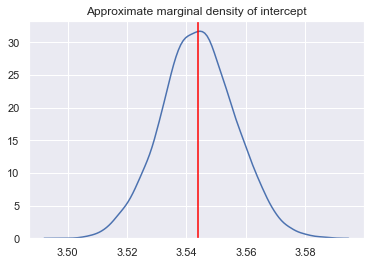

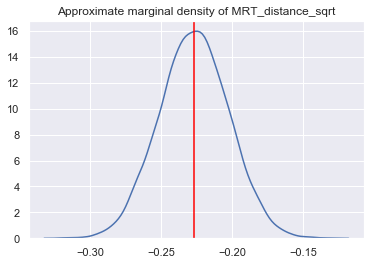

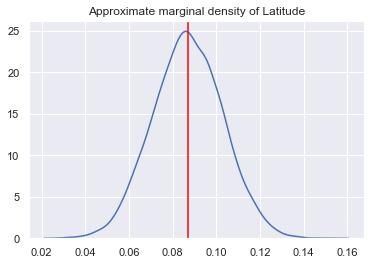

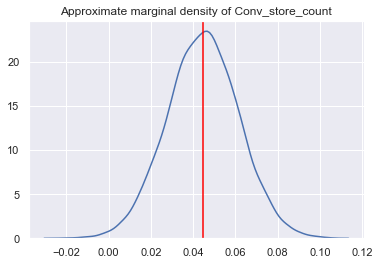

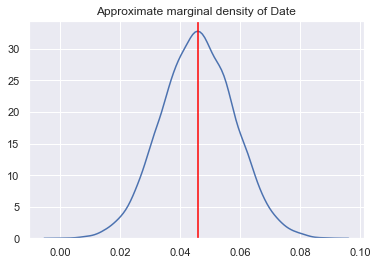

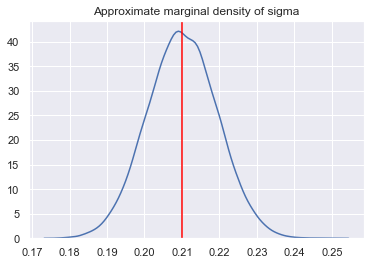

============ Fidelity summary ==================
 the mean square error is :  0.043188514990552505
 MSE test is :  51.35345576392674
 PVE is  :  0.7012936176093837
 F   is  :  190.86360464025282
 p value :  1.1102230246251565e-16
 AIC is  :  -94.9302159800279
 BIC is  :  -75.94992722620104
 AICc is :  -94.74445746609601


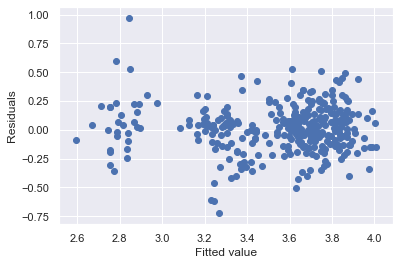

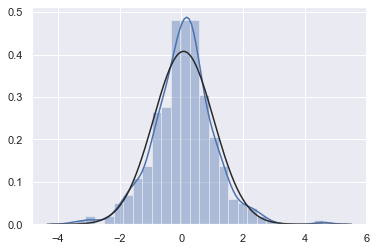

<Figure size 432x288 with 0 Axes>

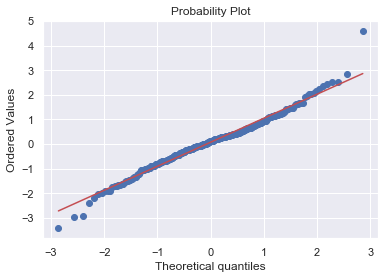

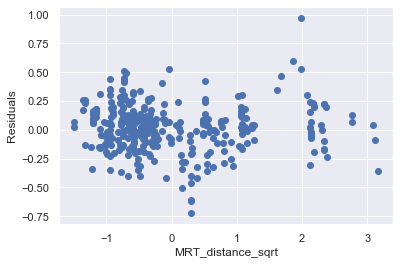

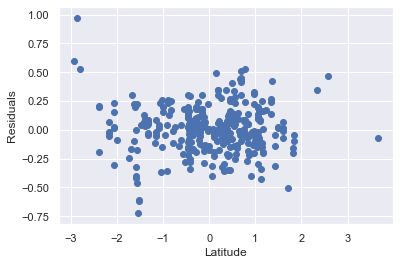

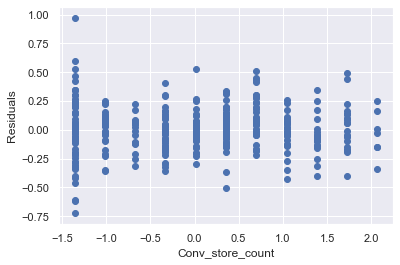

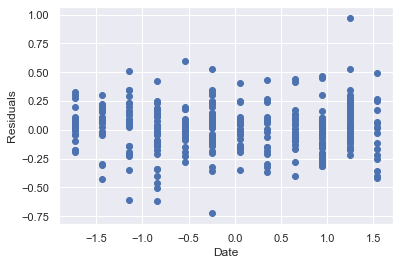

In [14]:
predictors = [ 'MRT_distance_sqrt' ,'Latitude', 'Conv_store_count','Date']
Parameter = [ 'intercept' ,'MRT_distance_sqrt' ,'Latitude', 'Conv_store_count','Date','sigma' ]
X = (data_no_outlier[predictors].dropna()).to_numpy()
Model = Bayesian_framework(4,Parameter,X,Y,transformation_train = False , transformation_test = True, torch_imp=True)
proba_set = Gaussian_model_torch(Model)

# Define the model
Model.set_log_joint_prior(proba_set.log_joint_prior)
Model.set_log_likelihood(proba_set.log_likelihood)

# define a sample algorithm :
gva = GVA(Model)
init_mu = torch.zeros(6)
init_mu[0]= 3
init_mu[-1] = 2
init_L = -2*torch.ones(6,6)
gva.compute_GVA_algo(init_mu,init_L, step_size = 0.07, show = True , line_search = True , stop_crit = 10 )

tool = Vizualisation_tool(Model,gva)
tool.marginal_visualization()    
tool.fidelity()
tool.diagnostics()

tensor([10189.5516], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([1388.6683], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([1103.3950], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([858.3531], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([750.4974], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([681.5146], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([591.4811], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([526.4285], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([350.8894], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([274.0309], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([190.0407], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([164.9916], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([163.9129], dtype=torch.float64, grad_fn=<NegBackward>)
tensor([163.7186], dtype=torch.float64, grad_fn=<NegBackward>)
 Mode find out 
 It takes : 25.42  s to find the mode 
            features  Coeff  std          CI
0          int

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1827: RuntimeWarning: invalid value encountered in greater_equal
  cond2 = (x >= np.asarray(_b)) & cond0
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:200: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:893: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


ValueError: `dataset` input should have multiple elements.

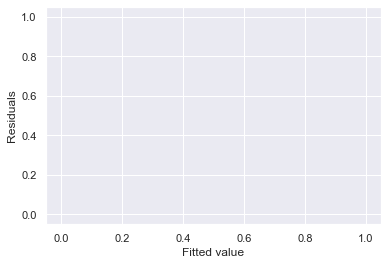

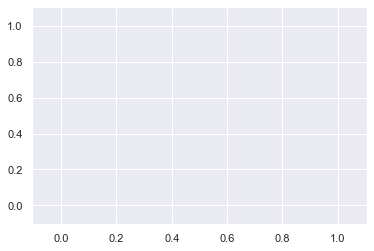

In [8]:
predictors = [ 'MRT_distance_sqrt' ,'Latitude', 'Conv_store_count','Date']
Parameter = [ 'intercept' ,'MRT_distance_sqrt' ,'Latitude', 'Conv_store_count','Date','sigma' ]
X = (data_no_outlier[predictors].dropna()).to_numpy()
Model = Bayesian_framework(4,Parameter,X,Y,transformation_train = False , transformation_test = True, torch_imp=True)
proba_set = Gaussian_model_gaussian_prior_torch(Model)

# Define the model
Model.set_log_joint_prior(proba_set.log_joint_prior)
Model.set_log_likelihood(proba_set.log_likelihood)

# define a sample algorithm :
imp_s = Important_sampling(Model)
mean_proposal = imp_s.compute_mode_algo( line_search = True)
cov_mat = 0.1*np.ones(6)
proposal = st.multivariate_normal(mean = mean_proposal.view(-1).numpy() , cov = np.diag(cov_mat))
w,theta = imp_s.compute_algo(proposal , 100000)
imp_s.compute_statistic()
imp_s.summary()

tool = Vizualisation_tool(Model,imp_s)
tool.fidelity()
tool.diagnostics()